<a href="https://colab.research.google.com/github/penguin1109/MOAI/blob/main/LOGSOFTMAXUnetpp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

- 매번 새롭게 trainset과 valid set을 나누어 주었었기 때문에 unbalanced class문제를 해결하기 위해서 적용해야 하는 loss의 weigth를 매번 새롭게 계산했다.

In [13]:
!pip install pydicom
!pip install albumentations==0.4.6

In [14]:
# Hyperparameters
import torch
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
LEARNING_RATE = 3e-4
BATCH_SIZE = 4
NUM_EPOCHS = 77
IMAGE_WIDTH = 512
IMAGE_HEIGHT = 512
LOAD_MODEL = False
PIN_MEMORY = True
NUM_WORKERS = 1
TRAIN_IMAGE_DIR = '/content/drive/Shareddrives/Kaggle_MOAI2021/data/train/DICOM'
TRAIN_MASK_DIR = '/content/drive/Shareddrives/Kaggle_MOAI2021/data/train/Label'
TEST_IMAGE_DIR = '/content/drive/Shareddrives/Kaggle_MOAI2021/data/test'

SOFTMAX = True
CHECKPOINT_DIR = '/content/drive/Shareddrives/Kaggle_MOAI2021/checkpoints/LOGSOFTMAXunetppALL_checkpoint.pth.tar'
FILENAME = 'LOGSOFTMAXunetppALL_checkpoint.pth.tar'

In [15]:
import cv2
from glob import glob
from PIL import Image
from torch.utils.data import Dataset
import numpy as np
import matplotlib.pyplot as plt
from pydicom import dcmread
import matplotlib.image as mpimg

def get_mask_bool(mask, type = None):
    mask_1 = mask < 0.00784314
    mask_2 = mask >= 0.00392157
    mask_3 = np.logical_and(mask_1, mask_2)
    if type == 'tumor':
        mask = (mask >= 0.00784314).astype(float)
    elif type == 'organ':
        mask = mask_3.astype(float)
    elif type == "all":
        mask = (mask!=0).astype(float)
    else:
        mask = (mask < 0.00392157).astype(float)
    if 1.0 not in mask:
      return False
    else:
      return True


In [16]:
def list_with(type, image_dir, mask_dir):
  dcom_dirs = np.array(sorted(glob(image_dir + '/*/*')))
  mask_dirs = np.array(sorted(glob(mask_dir + '/*/*')))
  imgs, masks = [],[]
  if type == 'tumor':
    for idx, dir in enumerate(mask_dirs):
      mask = mpimg.imread(dir)
      mask = np.around(mask, 8)
      if get_mask_bool(mask, 'tumor'):
        imgs.append(dcom_dirs[idx])
        masks.append(mask_dirs[idx])
  elif type == 'organ':
    for idx, dir in enumerate(mask_dirs):
      mask = mpimg.imread(dir)
      mask = np.around(mask, 8)
      if get_mask_bool(mask, 'organ'):
        imgs.append(dcom_dirs[idx])
        masks.append(mask_dirs[idx])
  else:
    for idx, dir in enumerate(mask_dirs):
      mask = mpimg.imread(dir)
      mask = np.around(mask, 8)
      if get_mask_bool(mask, 'all'):
        imgs.append(dcom_dirs[idx])
        masks.append(mask_dirs[idx])

  return imgs, masks



In [17]:
#dcom_dirs, mask_dirs = list_with('all', TRAIN_IMAGE_DIR, TRAIN_MASK_DIR)
#dcom_dirs, mask_dirs = np.array(dcom_dirs), np.array(mask_dirs)
#print(len(dcom_dirs), len(mask_dirs))

In [18]:
from tensorflow.keras.preprocessing.image import load_img
import numpy as np
import pydicom

def transform_to_hu(medical_image, image):
    hu_image = image * medical_image.RescaleSlope + medical_image.RescaleIntercept
    hu_image[hu_image < -1024] = -1024
    return hu_image

def window_image(image, window_center, window_width):
    window_image = image.copy()
    image_min = window_center - (window_width / 2)
    image_max = window_center + (window_width / 2)
    window_image[window_image < image_min] = image_min
    window_image[window_image > image_max] = image_max
    return window_image

def resize_normalize(image):
    image = np.array(image, dtype=np.float64)
    image -= np.min(image)
    image /= np.max(image)
    return image

def read_dicom(path, window_widht, window_level, channel):
    image_medical = pydicom.dcmread(path)
    image_data = image_medical.pixel_array

    image_hu = transform_to_hu(image_medical, image_data)
    image_window = window_image(image_hu.copy(), window_level, window_widht)
    image_window_norm = resize_normalize(image_window)


    image_window_norm = np.expand_dims(image_window_norm, axis=-1)   # (512, 512, 1)
    if channel == 3:
      image_ths = np.concatenate([image_window_norm, image_window_norm, image_window_norm], axis=2)   # (512, 512, 3)
    else:
      image_ths = image_window_norm
    return image_ths

In [19]:
import torch
import argparse
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader

def str2bool(v):
    if v.lower() in ['true', 1]:
        return True
    elif v.lower() in ['false', 0]:
        return False
    else:
        raise argparse.ArgumentTypeError('Boolean value expected.')


def count_params(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)


class AverageMeter(object):
    """Computes and stores the average and current value"""

    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

def save_checkpoint(state, filename = FILENAME):
    root = '/content/drive/Shareddrives/Kaggle_MOAI2021/checkpoints'
    print("=>saving checkpoint...")
    torch.save(state, root + '/' + filename)

def load_checkpoint(checkpoint, model):
    print("=>loading checkpoint...")
    model.load_state_dict(checkpoint['state_dict'])

def get_mask(mask, type = None):
    mask_1 = mask < 0.00784314
    mask_2 = mask >= 0.00392157
    mask_3 = np.logical_and(mask_1, mask_2)
    if type == 'tumor':
        mask = (mask >= 0.00784314).astype(float)
    elif type == 'organ':
        mask = mask_3.astype(float)
    elif type == "all":
        mask = (mask!=0).astype(float)
    else:
        mask = (mask < 0.00392157).astype(float)
    return mask

def get_loaders(train_dir,valid_dir, batch_size, train_transform, valid_transform, num_workers = 1, pin_memory = True):
    # 매번 validataion dataset을 새롭게 설정해 준다고 하면 (전체 dataset에서 비율을 정해서 해줌)
    train_ds = MOAIDataset(
        train_dir,
        transform = train_transform
    )
    
    train_loader = DataLoader(
        train_ds,
        batch_size = batch_size, shuffle = True,
        num_workers = num_workers, pin_memory=pin_memory
    )

    valid_ds = MOAIDataset(
        valid_dir,
        transform = valid_transform
    )

    valid_loader = DataLoader(
        valid_ds, 
        batch_size = batch_size, shuffle = True,
        num_workers = num_workers, pin_memory = pin_memory
    )

    return train_loader, valid_loader

def check_accuracy(loader, scheduler, model, device = "cuda"):
    num_correct = 0
    num_pixels = 0
    dice_score = 0
    model.eval()  # unet모델의 가중치를 학습하는게 아니라 evaluation 단계에 들어갔음을 의미하는 명령어

    with torch.no_grad():
        for image, mask in loader:
            image = image.to(device)
            mask = mask.permute(0, 3, 1, 2).to(device)
            print('making predictions...')
            if SIGMOID:
              predictions = model(image.float())
            else:
              predictions = torch.sigmoid(model(image.float()))
            print("prediction made...")

            result = (predictions > 0.5)[0].float().cpu().permute(1, 2, 0).detach().numpy()
            visualize_mask(to_cpu(predictions)[0].permute(1, 2, 0).numpy())
            visualize_mask(result)

            predictions = (predictions > 0.5).float()
            num_correct += (predictions == mask).sum()
            num_pixels += torch.numel(predictions)
            dice_score += (2 * (predictions * mask).sum()) / ((predictions + mask).sum() + 1e-9)
            
    scheduler.step(dice_score/len(loader))
        
    print(f"Got {num_correct}/{num_pixels} with acc {num_correct/num_pixels*100:.3f}")
    print(f"Got DICE Score : {dice_score/len(loader)}")
    model.train()


def visualize(inputs, outputs, masks, channel):
  if torch.is_tensor(inputs):
    inputs = inputs.data.detach().cpu()

  if torch.is_tensor(outputs):
    outputs = (torch.exp(outputs)).data.detach().cpu().numpy()
    output = np.argmax(outputs, axis = -1)

    
  if torch.is_tensor(masks):
    masks = masks.data.detach().cpu()
  

  if channel == 1:
    for i in range(BATCH_SIZE):
      imgs = [inputs[i,:,:,0], outputs[i,0,:,:], masks[i,:,:,0]]
      plt.figure(figsize = (6, 6))
      for j in range(len(imgs)):
        plt.subplot(1, len(imgs), j+1)
        plt.imshow(imgs[j])
      plt.show()
  elif channel == 2:
    for i in range(BATCH_SIZE):
      imgs = [inputs[i,0,:,:], outputs[i][:,:,0],masks[i,:,:,0],outputs[i][:,:,1], masks[i,:,:,1]]
      plt.figure(figsize = (10, 10))
      for j in range(len(imgs)):
        plt.subplot(1, len(imgs), j+1)
        plt.imshow(imgs[j])
      plt.show()
  
  else:
    for i in range(BATCH_SIZE):
      imgs = [inputs[i].permute(1, 2, 0)[:,:,0], outputs[i][:,:,0], outputs[i][:,:,1], outputs[i][:,:,2], output[i], masks[i]]
      plt.figure(figsize = (10, 10))
      for j in range(len(imgs)):
        plt.subplot(1, len(imgs), j+1)
        plt.imshow(imgs[j])
      plt.show()


def iou_score(output, target):
  #shape = (batchsize, 512, 512, 3)
    smooth = 1e-6

    if torch.is_tensor(output):
        output_ = (output).data.detach().cpu().numpy()
    
    if torch.is_tensor(target):
        target_ = target.data.detach().cpu().numpy()
    
    output_ = np.argmax(output_, axis = -1)
    target_ = np.argmax(target_, axis = -1)


    intersection = (output_ & target_).sum()
    union = (output_ | target_).sum()

    return (intersection + smooth) / (union + smooth)
def dice_coef(output, target):
    smooth = 1e-6

    output = output.view(-1).data.cpu().numpy()
    target = target.view(-1).data.cpu().numpy()
    intersection = (output * target).sum()

    return (2. * intersection + smooth) / (output.sum() + target.sum() + smooth)

- UNET++02의 경우에는 모델의 네트워크 내부에서 sigmoid를 마지막 층에 연결해서 적용시킨다.
- 따라서 BCEDiceLoss를 계산할 때에 출력값에 sigmoid를 붙여줄 필요가 없다.

In [20]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class BCEDiceLoss(nn.Module):
    def __init__(self, t_normedWeights, v_normedWeights):
        super().__init__()
        self.t_weight = t_normedWeights
        self.v_weight = v_normedWeights

    def forward(self, inputs, targets, mode):
        #input_pred = torch.softmax(inputs, dim = -1)
        inputs_ = torch.argmax(inputs, dim = -1)

        targets_ = torch.argmax(targets, dim = -1)

        input = inputs.permute(0, 3, 1, 2)
       
       
        if mode == 'train':
          bce = F.nll_loss(input, targets_, weight = self.t_weight, reduction = 'mean')
          smooth = 1e-6

          dims = (1, 2)
          for i in range(3):
            inp, tar = torch.exp(inputs)[:, :, :, i], targets[:, :, :, i]
            intersection = torch.sum(inp * tar, dims) * self.t_weight[i]
            cardinality = torch.sum(inp + tar, dims) * self.t_weight[i]


        else:
          bce = F.nll_loss(input, targets_, weight = self.v_weight, reduction = 'mean')
          smooth = 1e-6

          dims = (1, 2)
          for i in range(3):
            inp, tar = torch.exp(inputs)[:, :, :, i], targets[:, :, :, i]
            intersection = torch.sum(inp * tar, dims) * self.v_weight[i]
            cardinality = torch.sum(inp + tar, dims) * self.v_weight[i]

        

        dice_score = 2. * (smooth+intersection) / (cardinality + smooth)
        dice_score = torch.mean(1. - dice_score)

        return 0.5 *(bce + dice_score)

In [21]:
import cv2
from glob import glob
from PIL import Image
from torch.utils.data import Dataset
import numpy as np
import matplotlib.pyplot as plt
from pydicom import dcmread
import matplotlib.image as mpimg
#from utils import get_mask

class MOAIDataset(Dataset):
    def __init__(self, dir, transform = None):
        self.mask_dir = dir
        self.file_no = list(map(lambda x: x.split('/')[-2] +'/'+ (x.split('/')[-1].split('.')[0] + '.dcm'),self.mask_dir))
        self.image_dir = list(map(lambda x: TRAIN_IMAGE_DIR + '/'+ x, self.file_no))
        self.transform = transform

    
    def __len__(self):
        return len(self.image_dir)
    
    def __getitem__(self, index):
        img_path = self.image_dir[index]  # .dcm으로 저장된 DCM format의 CT 데이터
        mask_path = self.mask_dir[index]  # .png로 저장된 PNG format의 ground truth data
        

        image = read_dicom(img_path, 100, 50, 1)
        mask = mpimg.imread(mask_path)
        mask = np.around(mask, 8)

        m_bg = get_mask(mask)
        m_tu = get_mask(mask, 'tumor')
        m_or = get_mask(mask, 'organ')

        m_bg = np.expand_dims(m_bg, axis = -1)
        m_tu = np.expand_dims(m_tu, axis = -1)
        m_or = np.expand_dims(m_or, axis = -1)
        m_fn = np.concatenate([m_bg, m_or, m_tu], axis = -1)
        #m_fn = np.concatenate([m_or, m_tu], axis = -1)
        #m_fn = np.zeros((512, 512, 1))
        #m_fn[m_tu == 1] = 2
        #m_fn[m_or == 1] = 1

        
        # mask = np.array(cv2.imread(mask_path)[:,:,0]) # shape = (512, 512)

        if self.transform is not None:
            augmentations = self.transform(image = image, mask = m_fn)
            image = augmentations['image']
            m_fn = augmentations['mask']

        return image, m_fn.float()

In [22]:
import torch
import torch.nn as nn
from albumentations.pytorch import ToTensorV2

class VGGBlock(nn.Module):
    def __init__(self, ch_in, ch_mid, ch_out):
        super().__init__()
        self.relu = nn.ReLU(inplace = True)
        self.conv1 = nn.Conv2d(ch_in, ch_mid, kernel_size = 3, padding = 1)
        self.bn1 = nn.BatchNorm2d(ch_mid)
        self.conv2 = nn.Conv2d(ch_mid, ch_out, kernel_size = 3, padding = 1)
        self.bn2 = nn.BatchNorm2d(ch_out)
    
    def forward(self, x):
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)
        out = self.relu(out)

        return out

class UNetPP(nn.Module):
    def __init__(self,ch_in,ch_out, deep_supervision = True, softmax = True):
        super().__init__()

        #nb_filter = [16, 32, 64, 128, 256]
        nb_filter = [32, 64, 128, 256, 512]

        self.deep_supervision = deep_supervision
        self.softmax = softmax
        self.pool = nn.MaxPool2d(2, 2)
        self.up = nn.Upsample(scale_factor = 2, mode = 'bilinear', align_corners = True)

        self.conv0_0 = VGGBlock(ch_in, nb_filter[0], nb_filter[0])
        self.conv1_0 = VGGBlock(nb_filter[0], nb_filter[1], nb_filter[1])
        self.conv2_0 = VGGBlock(nb_filter[1], nb_filter[2], nb_filter[2])
        self.conv3_0 = VGGBlock(nb_filter[2], nb_filter[3], nb_filter[3])
        self.conv4_0 = VGGBlock(nb_filter[3], nb_filter[4], nb_filter[4])

        self.conv0_1 = VGGBlock(nb_filter[0]+nb_filter[1], nb_filter[0], nb_filter[0])
        self.conv1_1 = VGGBlock(nb_filter[1]+nb_filter[2], nb_filter[1], nb_filter[1])
        self.conv2_1 = VGGBlock(nb_filter[2]+nb_filter[3], nb_filter[2], nb_filter[2])
        self.conv3_1 = VGGBlock(nb_filter[3]+nb_filter[4], nb_filter[3], nb_filter[3])

        self.conv0_2 = VGGBlock(nb_filter[0]*2+nb_filter[1], nb_filter[0], nb_filter[0])
        self.conv1_2 = VGGBlock(nb_filter[1]*2+nb_filter[2], nb_filter[1], nb_filter[1])
        self.conv2_2 = VGGBlock(nb_filter[2]*2+nb_filter[3], nb_filter[2], nb_filter[2])

        self.conv0_3 = VGGBlock(nb_filter[0]*3+nb_filter[1], nb_filter[0], nb_filter[0])
        self.conv1_3 = VGGBlock(nb_filter[1]*3+nb_filter[2], nb_filter[1], nb_filter[1])

        self.conv0_4 = VGGBlock(nb_filter[0]*4+nb_filter[1], nb_filter[0], nb_filter[0])

        if self.deep_supervision:
          if self.softmax:
            self.final1 = nn.Sequential(nn.Conv2d(nb_filter[0], ch_out, kernel_size=1), nn.LogSoftmax(dim = 1))
            self.final2 = nn.Sequential(nn.Conv2d(nb_filter[0], ch_out, kernel_size=1), nn.LogSoftmax(dim = 1))
            self.final3 = nn.Sequential(nn.Conv2d(nb_filter[0], ch_out, kernel_size=1), nn.LogSoftmax(dim = 1))
            self.final4 = nn.Sequential(nn.Conv2d(nb_filter[0], ch_out, kernel_size=1), nn.LogSoftmax(dim = 1))

          else:
            self.final1 = nn.Conv2d(nb_filter[0], ch_out, kernel_size=1)
            self.final2 = nn.Conv2d(nb_filter[0], ch_out, kernel_size=1)
            self.final3 = nn.Conv2d(nb_filter[0], ch_out, kernel_size=1)
            self.final4 = nn.Conv2d(nb_filter[0], ch_out, kernel_size=1)

        else:
            self.final = nn.Conv2d(nb_filter[0], ch_out, kernel_size=1)
    
    def forward(self, input):
        x0_0 = self.conv0_0(input)
        x1_0 = self.conv1_0(self.pool(x0_0))
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up(x1_0)], 1))

        x2_0 = self.conv2_0(self.pool(x1_0))
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up(x2_0)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up(x1_1)], 1))

        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up(x1_2)], 1))

        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up(x1_3)], 1))

        if self.deep_supervision:
            output1 = self.final1(x0_1)
            output2 = self.final2(x0_2)
            output3 = self.final3(x0_3)
            output4 = self.final4(x0_4)
            return [output1, output2, output3, output4]

        else:
            output = self.final(x0_4)
            return output



- DiceLosswith Logits는 점점 감소하여야 하고, IOUScore의 경우에는 계속해서 증가하여야 한다.


In [23]:
def calc_weights(mask_dir):
  nSamples = [0,0,0]
  for idx, dir in enumerate(mask_dir):
    mask = mpimg.imread(dir)
    mask = np.round(mask, 8)
    if get_mask_bool(mask, 'tumor'):
      nSamples[2] += 1
    if get_mask_bool(mask, 'organ'):
      nSamples[1] += 1
    nSamples[0] += 1
  normedWeights = [1-(x/sum(nSamples)) for x in nSamples]
  normedWeights = torch.FloatTensor(normedWeights).to(DEVICE)

  return normedWeights
    

=>Training for epoch 0


  0%|          | 0/1280 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


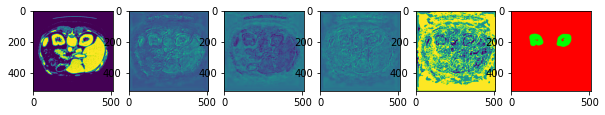

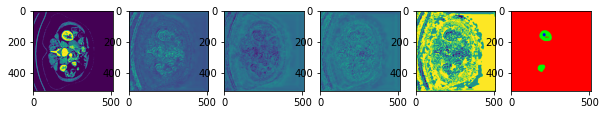

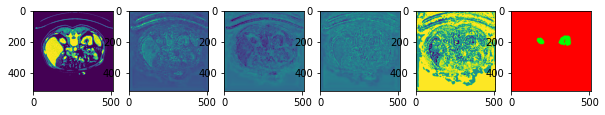

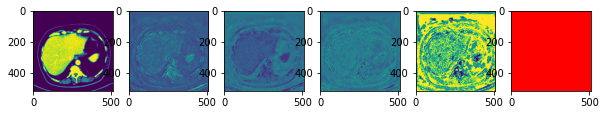

  4%|▍         | 50/1280 [02:25<1:07:21,  3.29s/it, loss=0.858, iou=0.00736]

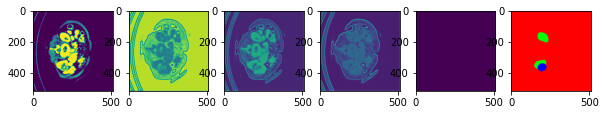

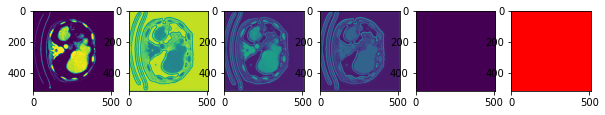

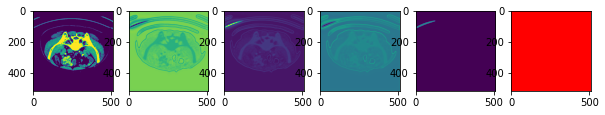

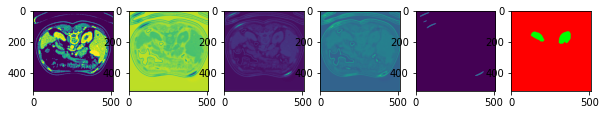

  8%|▊         | 100/1280 [04:59<59:17,  3.02s/it, loss=0.796, iou=0.00368]

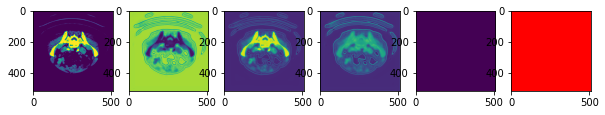

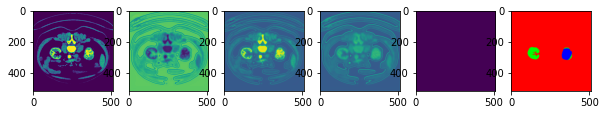

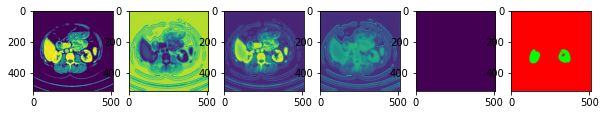

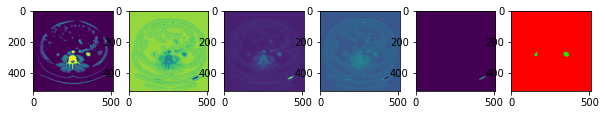

 12%|█▏        | 150/1280 [07:30<58:51,  3.12s/it, loss=0.758, iou=0.00245]  

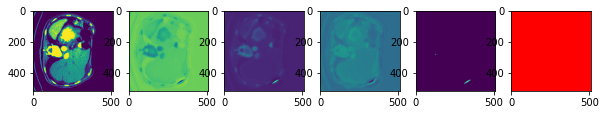

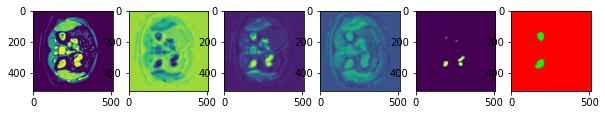

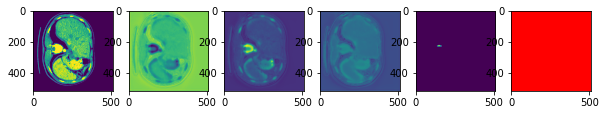

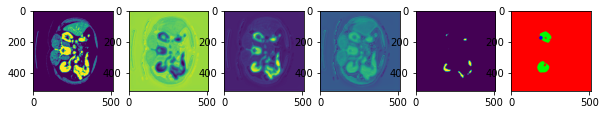

 16%|█▌        | 200/1280 [10:02<50:58,  2.83s/it, loss=0.73, iou=0.00247]

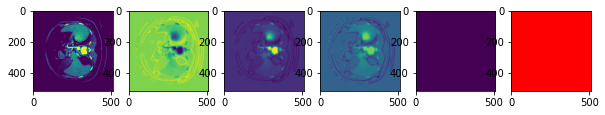

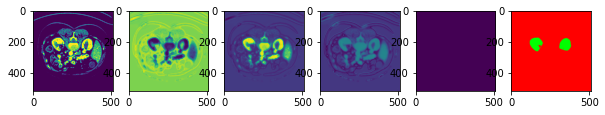

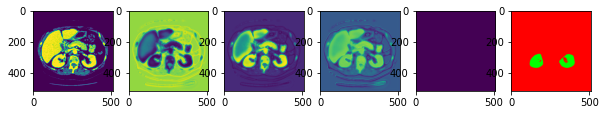

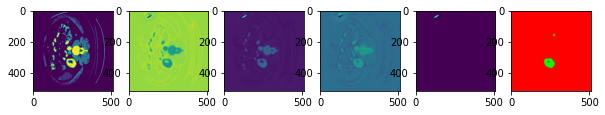

 20%|█▉        | 250/1280 [12:26<48:24,  2.82s/it, loss=0.707, iou=0.00851]

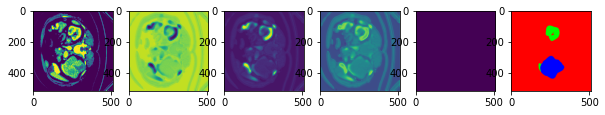

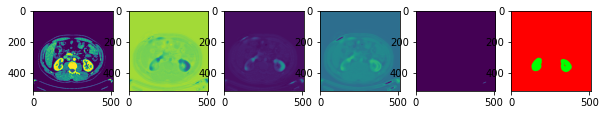

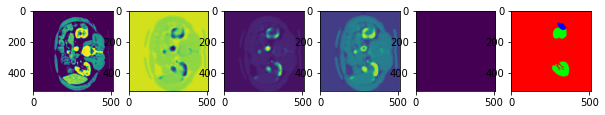

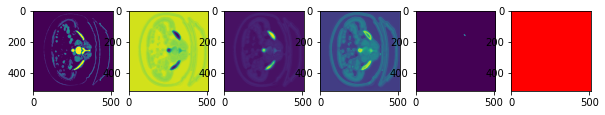

 23%|██▎       | 300/1280 [14:45<48:50,  2.99s/it, loss=0.688, iou=0.0339]

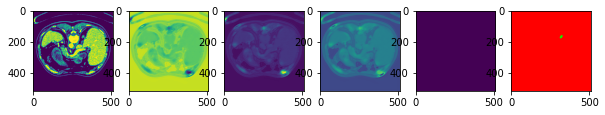

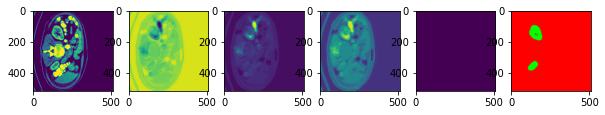

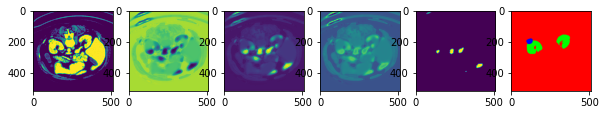

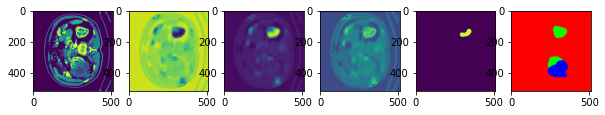

 27%|██▋       | 350/1280 [17:11<42:25,  2.74s/it, loss=0.673, iou=0.0646]

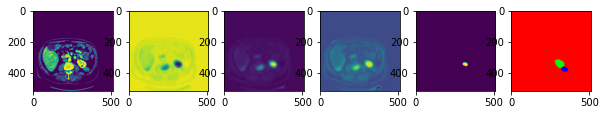

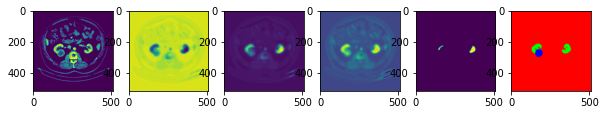

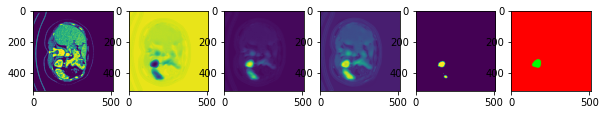

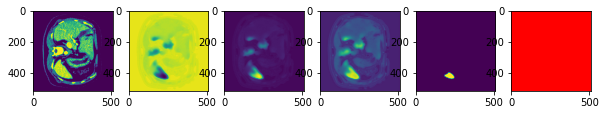

 31%|███▏      | 400/1280 [19:28<42:00,  2.86s/it, loss=0.66, iou=0.102]

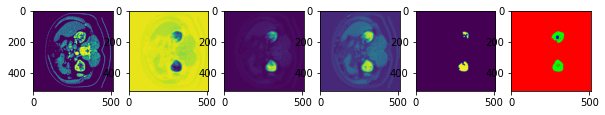

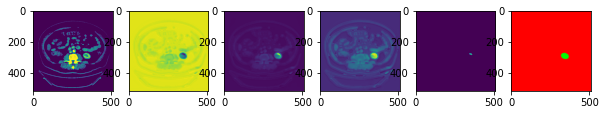

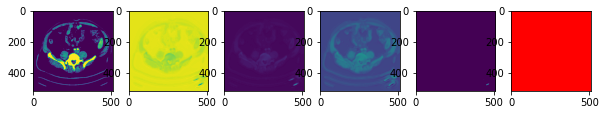

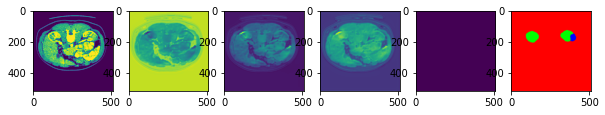

 35%|███▌      | 450/1280 [21:57<39:47,  2.88s/it, loss=0.649, iou=0.134]

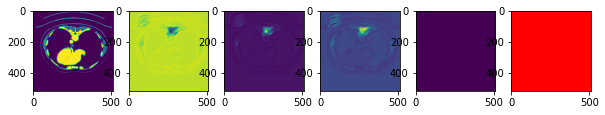

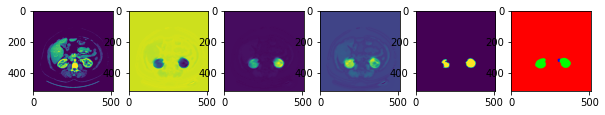

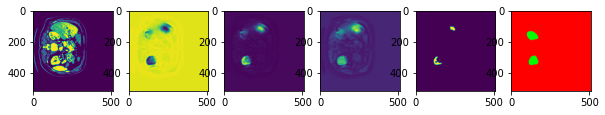

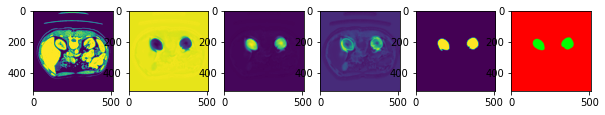

 39%|███▉      | 500/1280 [24:29<38:53,  2.99s/it, loss=0.639, iou=0.164]

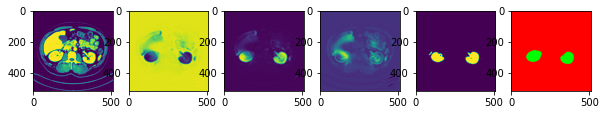

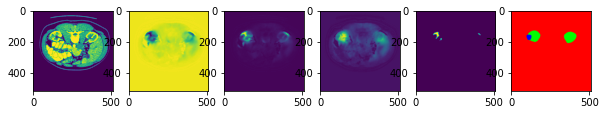

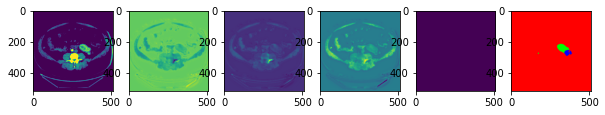

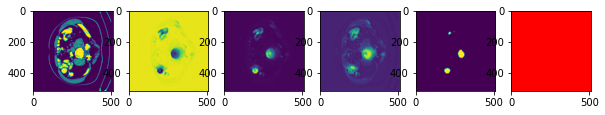

 43%|████▎     | 550/1280 [26:51<32:29,  2.67s/it, loss=0.631, iou=0.192]

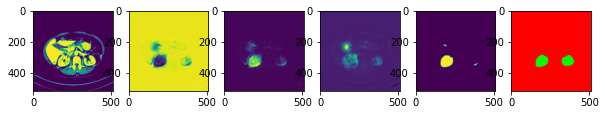

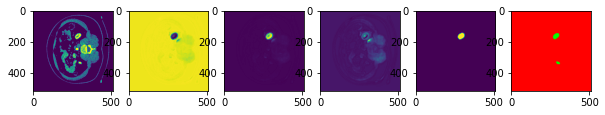

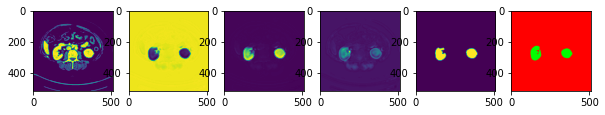

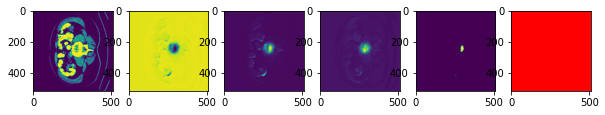

 47%|████▋     | 600/1280 [29:15<33:09,  2.93s/it, loss=0.624, iou=0.216]

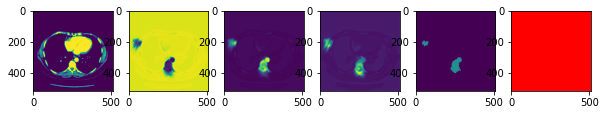

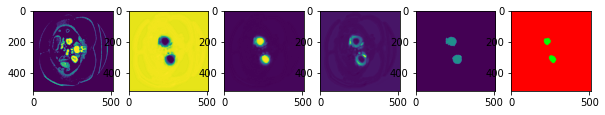

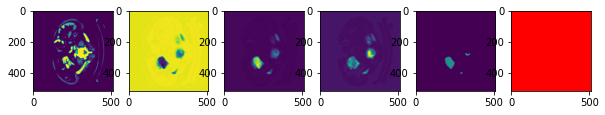

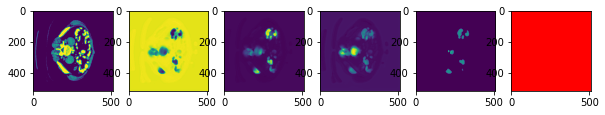

 51%|█████     | 650/1280 [31:45<30:33,  2.91s/it, loss=0.617, iou=0.227]

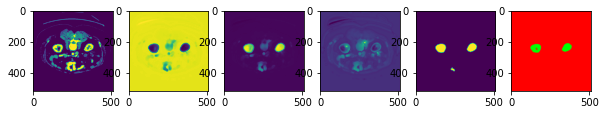

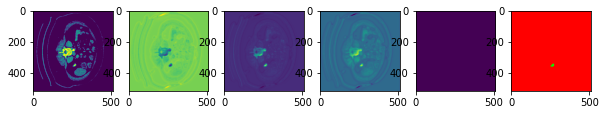

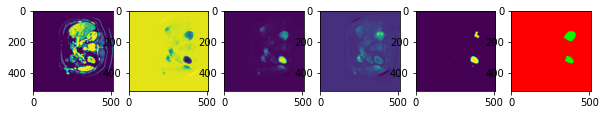

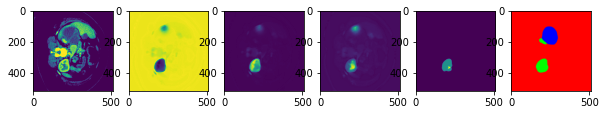

 55%|█████▍    | 700/1280 [34:16<28:12,  2.92s/it, loss=0.612, iou=0.235]

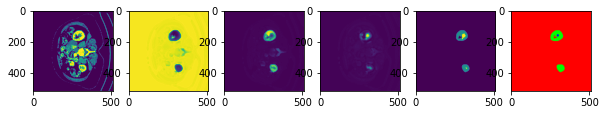

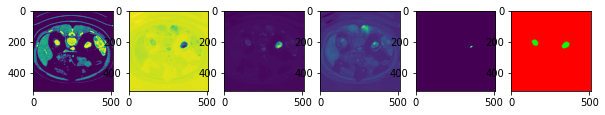

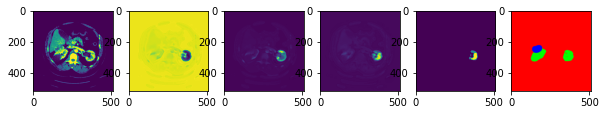

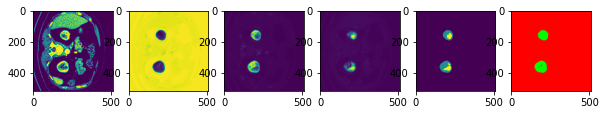

 59%|█████▊    | 750/1280 [36:51<27:02,  3.06s/it, loss=0.607, iou=0.24]

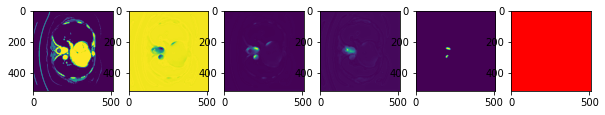

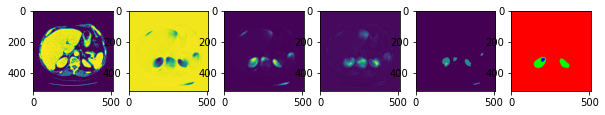

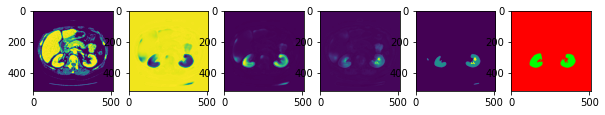

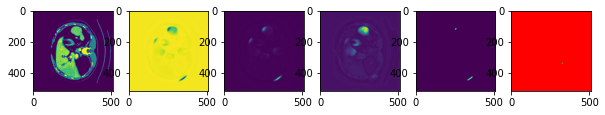

 62%|██████▎   | 800/1280 [39:28<25:05,  3.14s/it, loss=0.602, iou=0.248]

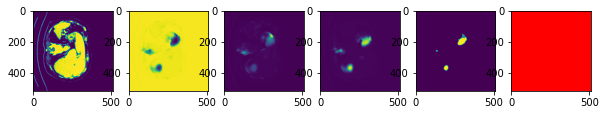

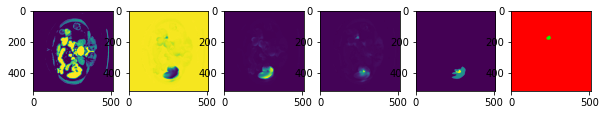

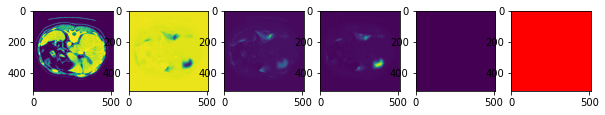

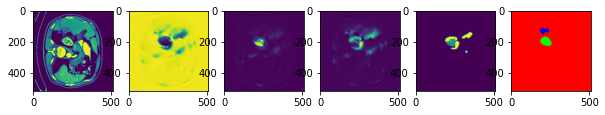

 66%|██████▋   | 850/1280 [41:59<20:38,  2.88s/it, loss=0.598, iou=0.252]

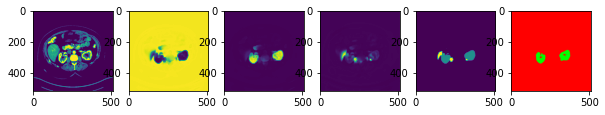

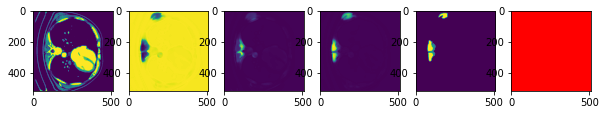

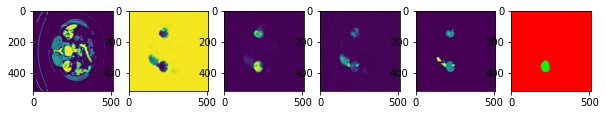

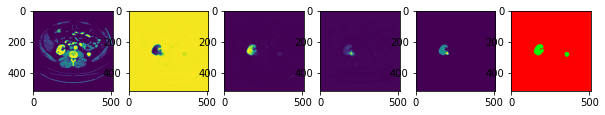

 70%|███████   | 900/1280 [44:25<18:41,  2.95s/it, loss=0.594, iou=0.254]

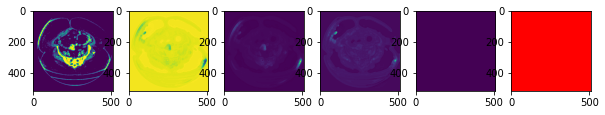

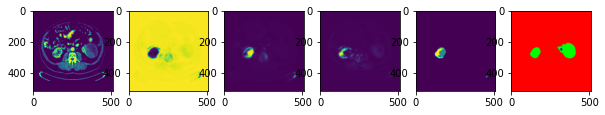

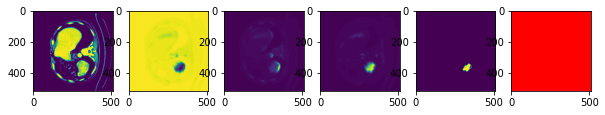

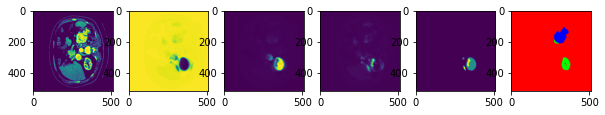

 74%|███████▍  | 950/1280 [46:50<16:34,  3.01s/it, loss=0.591, iou=0.258]

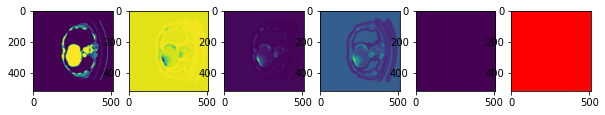

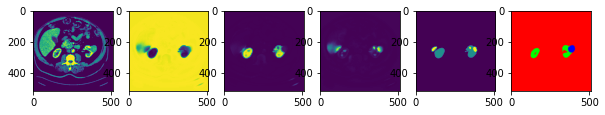

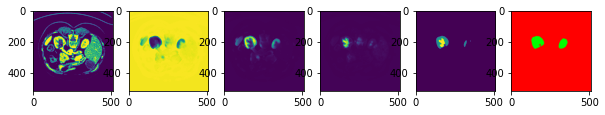

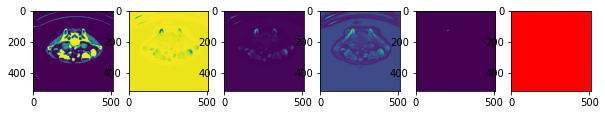

 78%|███████▊  | 1000/1280 [49:06<12:07,  2.60s/it, loss=0.588, iou=0.264]

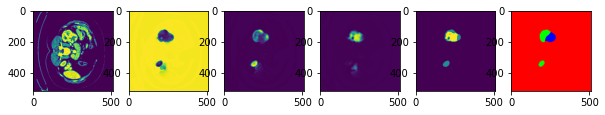

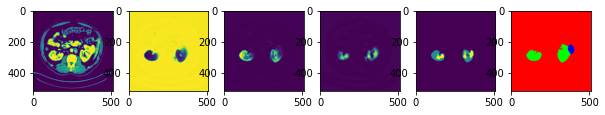

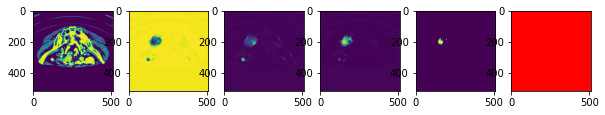

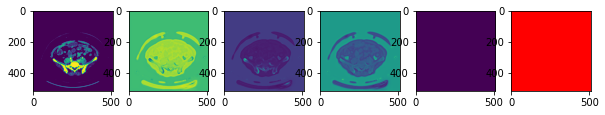

 82%|████████▏ | 1050/1280 [51:25<10:36,  2.77s/it, loss=0.585, iou=0.265]

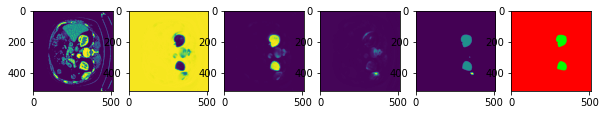

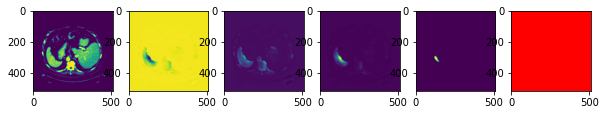

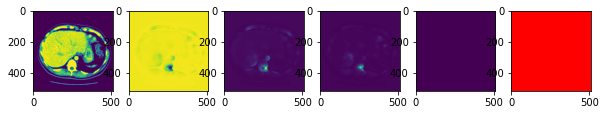

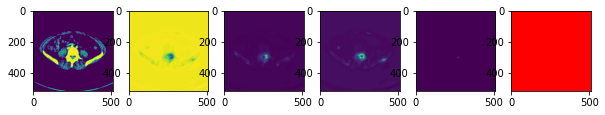

 86%|████████▌ | 1100/1280 [53:59<10:07,  3.38s/it, loss=0.582, iou=0.267]

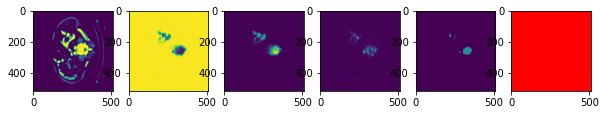

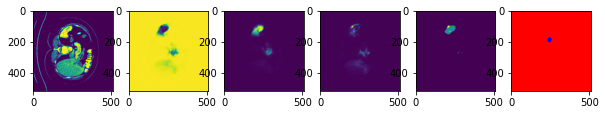

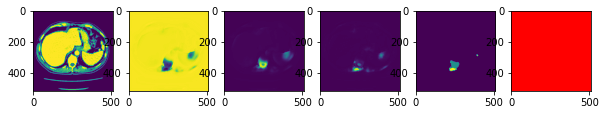

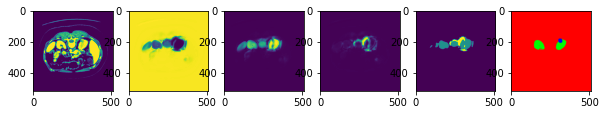

 90%|████████▉ | 1150/1280 [56:32<06:49,  3.15s/it, loss=0.579, iou=0.268]

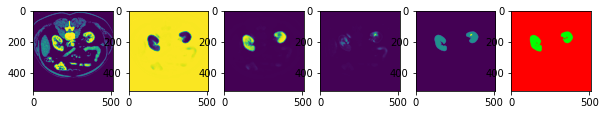

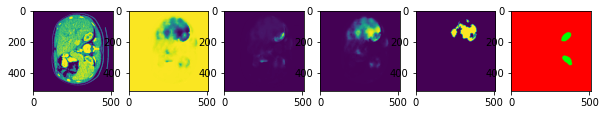

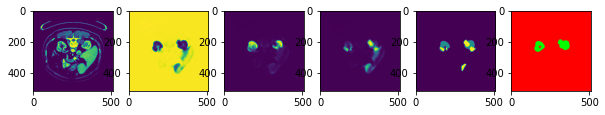

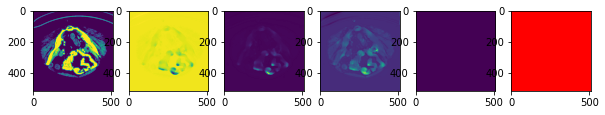

 94%|█████████▍| 1200/1280 [59:00<03:47,  2.84s/it, loss=0.577, iou=0.269]

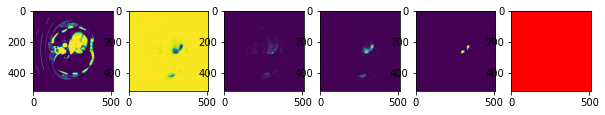

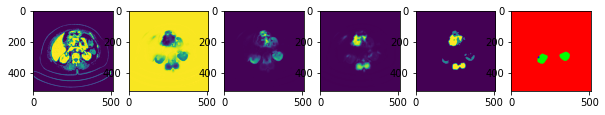

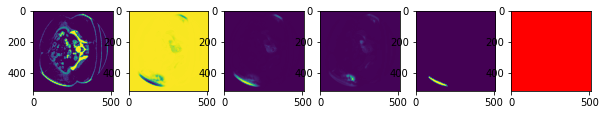

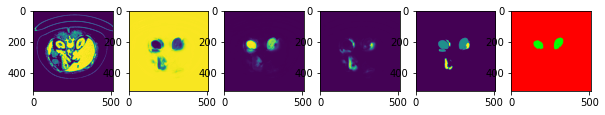

 98%|█████████▊| 1250/1280 [1:01:21<01:24,  2.82s/it, loss=0.575, iou=0.272]

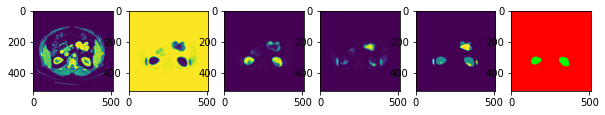

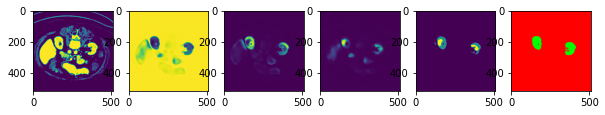

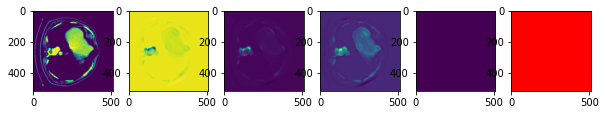

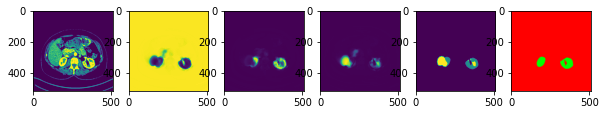

  0%|          | 0/320 [00:00<?, ?it/s]

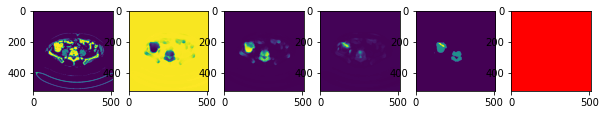

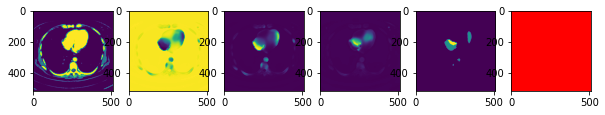

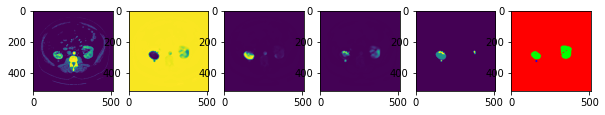

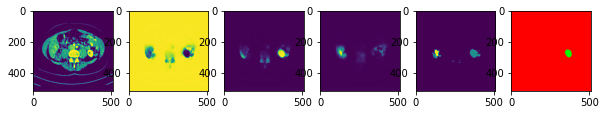

 16%|█▌        | 50/320 [02:33<13:40,  3.04s/it, loss=0.527, iou=0.303]

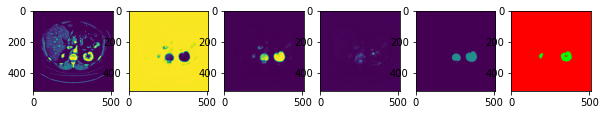

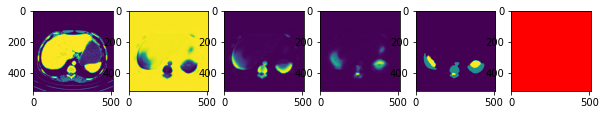

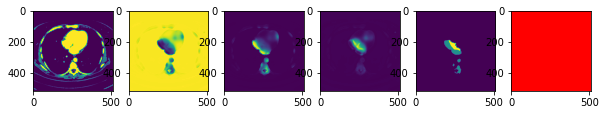

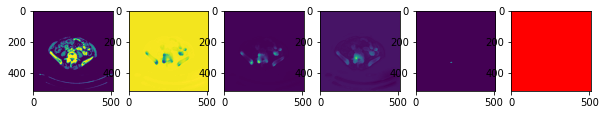

 31%|███▏      | 100/320 [05:06<11:25,  3.12s/it, loss=0.526, iou=0.307]

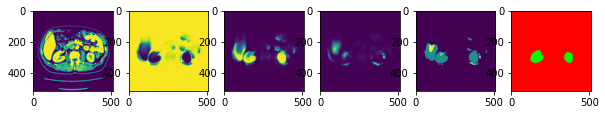

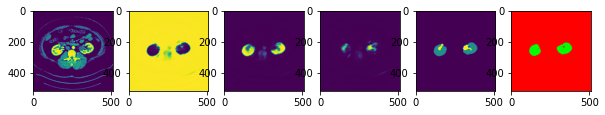

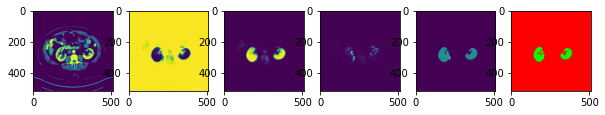

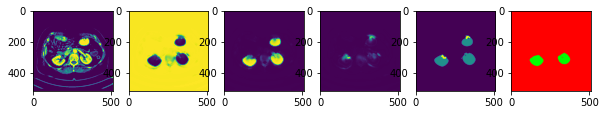

 47%|████▋     | 150/320 [07:34<08:43,  3.08s/it, loss=0.526, iou=0.312]

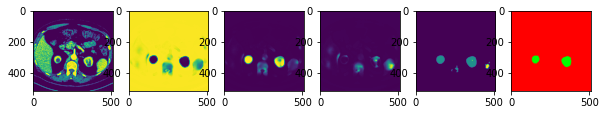

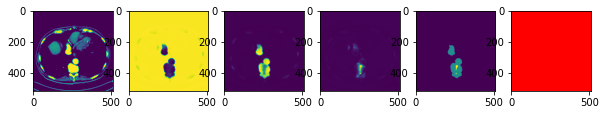

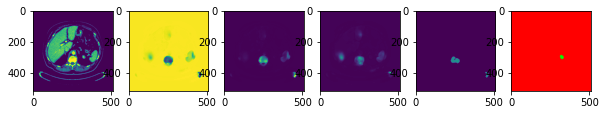

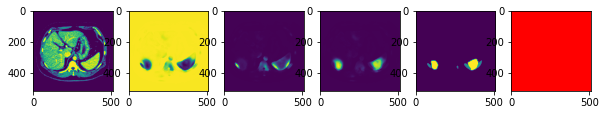

 62%|██████▎   | 200/320 [10:06<06:16,  3.13s/it, loss=0.525, iou=0.309]

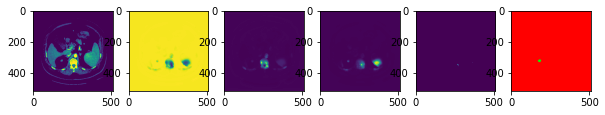

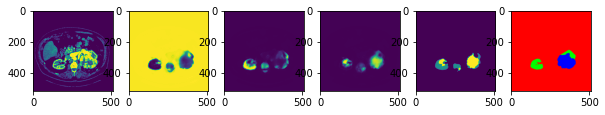

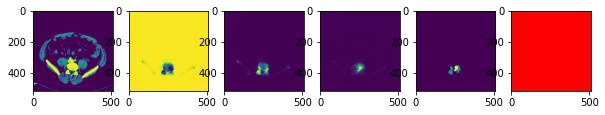

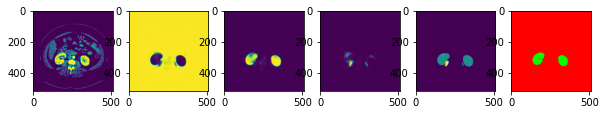

 78%|███████▊  | 250/320 [12:35<03:33,  3.05s/it, loss=0.525, iou=0.302]

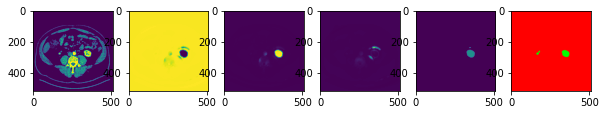

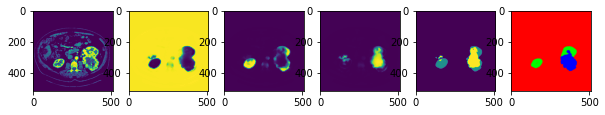

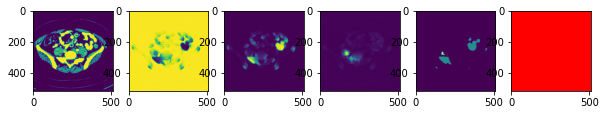

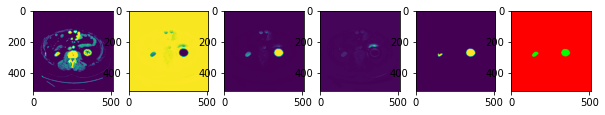

 94%|█████████▍| 300/320 [15:01<00:57,  2.86s/it, loss=0.525, iou=0.305]

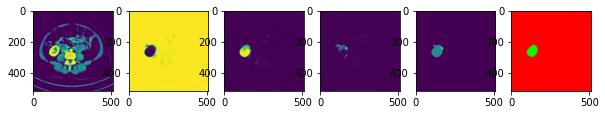

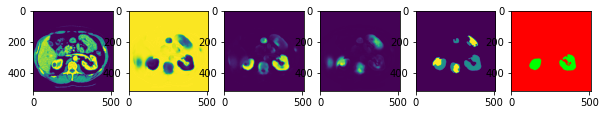

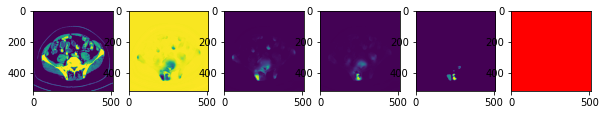

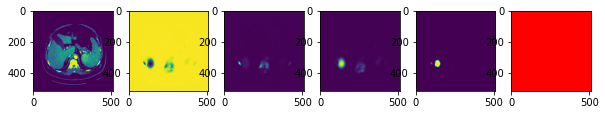

100%|██████████| 320/320 [16:01<00:00,  3.00s/it, loss=0.525, iou=0.307]


=>saving checkpoint...
=> SAVED BEST IOU
=>Training for epoch 1


  0%|          | 0/1280 [00:00<?, ?it/s]

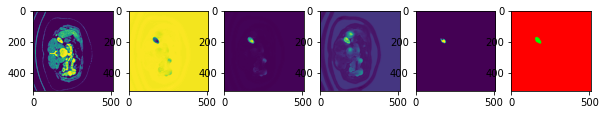

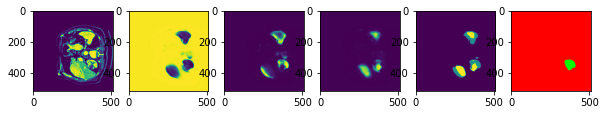

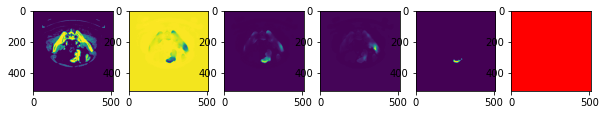

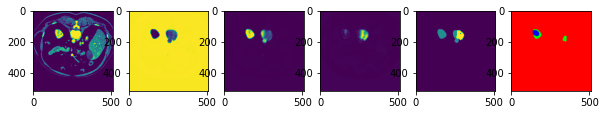

  4%|▍         | 50/1280 [00:53<21:08,  1.03s/it, loss=0.52, iou=0.338]

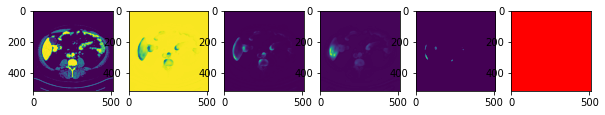

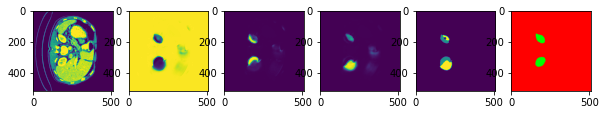

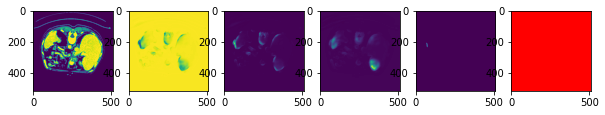

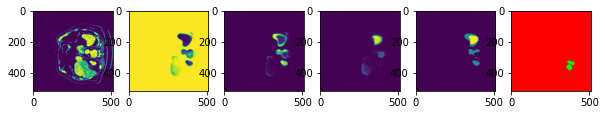

  8%|▊         | 100/1280 [01:48<20:45,  1.06s/it, loss=0.519, iou=0.348]

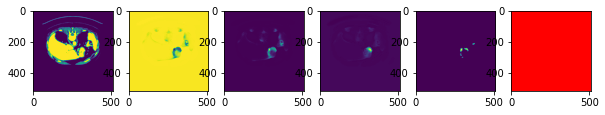

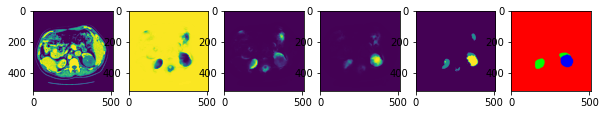

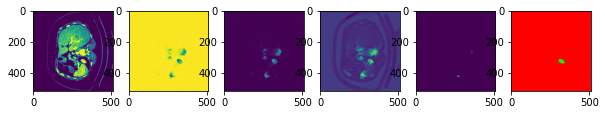

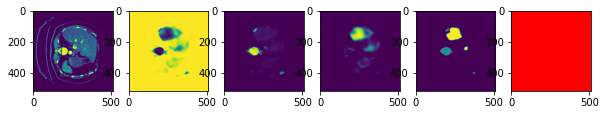

 12%|█▏        | 150/1280 [02:44<20:09,  1.07s/it, loss=0.519, iou=0.34]

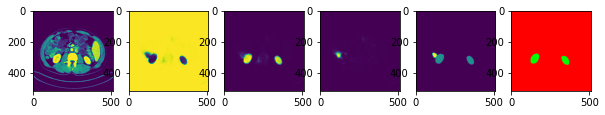

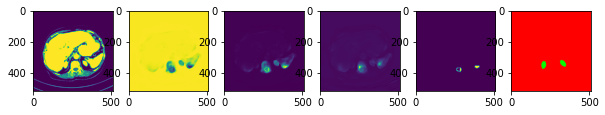

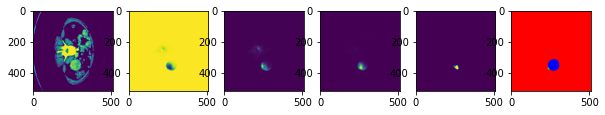

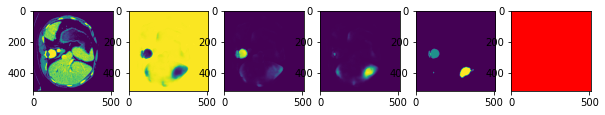

 16%|█▌        | 200/1280 [03:40<19:26,  1.08s/it, loss=0.518, iou=0.341]

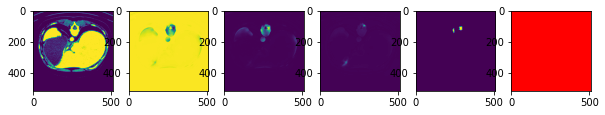

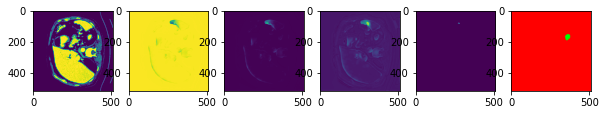

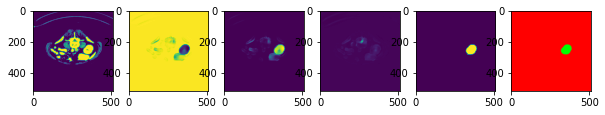

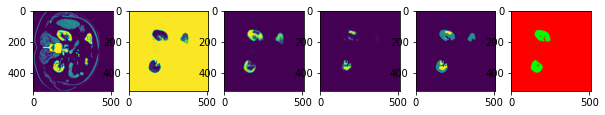

 20%|█▉        | 250/1280 [04:37<18:33,  1.08s/it, loss=0.517, iou=0.349]

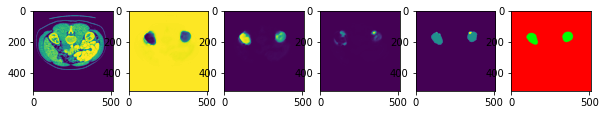

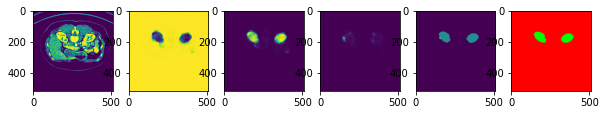

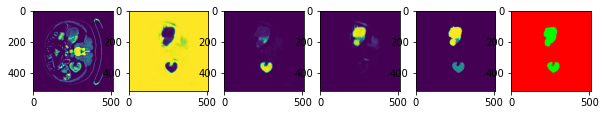

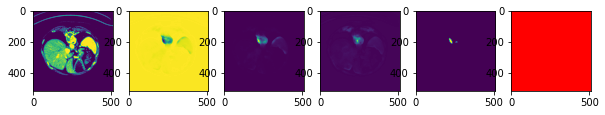

 23%|██▎       | 300/1280 [05:33<17:38,  1.08s/it, loss=0.516, iou=0.351]

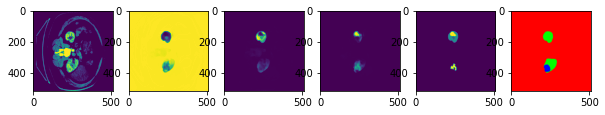

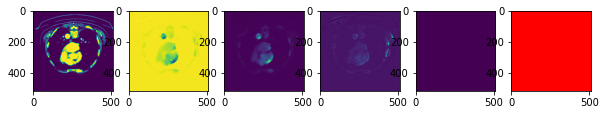

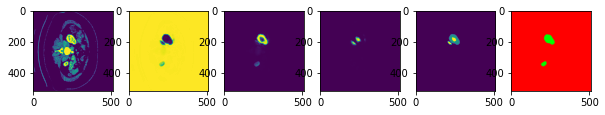

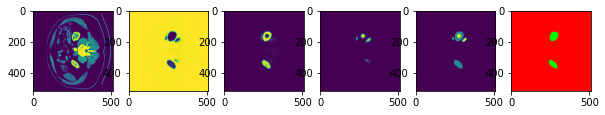

 27%|██▋       | 350/1280 [06:30<16:45,  1.08s/it, loss=0.515, iou=0.353]

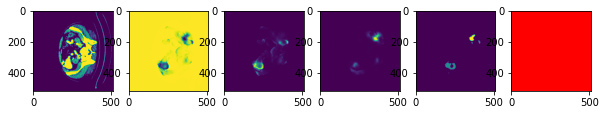

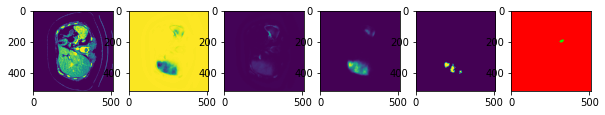

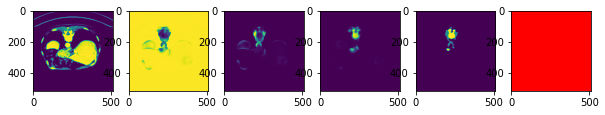

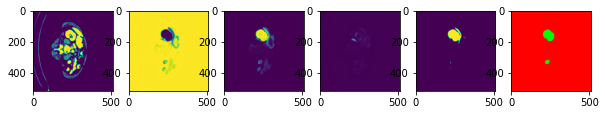

 31%|███▏      | 400/1280 [07:27<15:52,  1.08s/it, loss=0.515, iou=0.35]

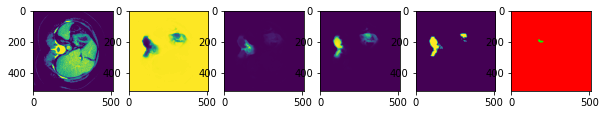

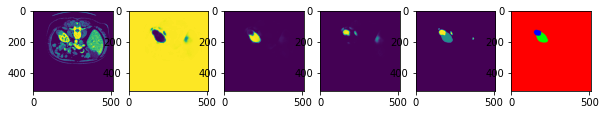

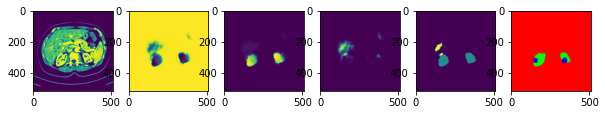

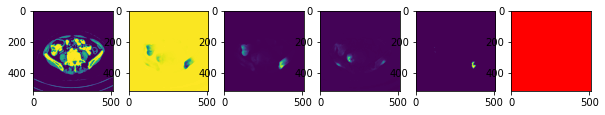

 35%|███▌      | 450/1280 [08:23<14:57,  1.08s/it, loss=0.515, iou=0.355]

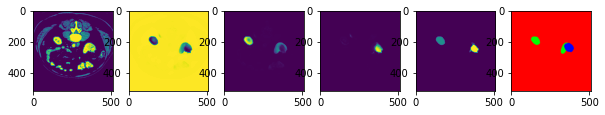

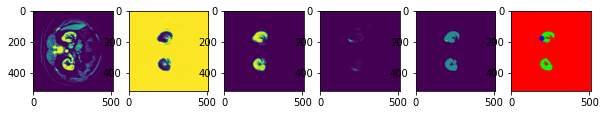

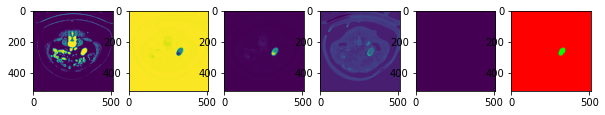

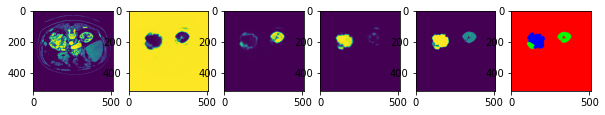

 39%|███▉      | 500/1280 [09:20<14:04,  1.08s/it, loss=0.514, iou=0.353]

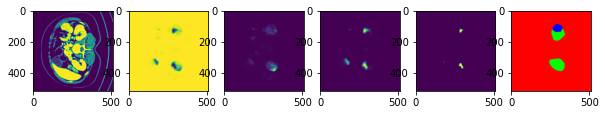

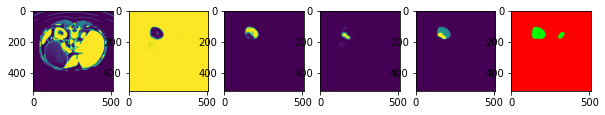

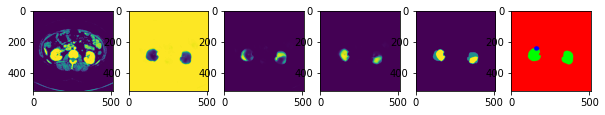

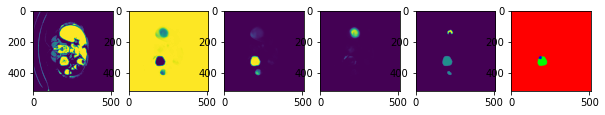

 43%|████▎     | 550/1280 [10:17<13:09,  1.08s/it, loss=0.514, iou=0.354]

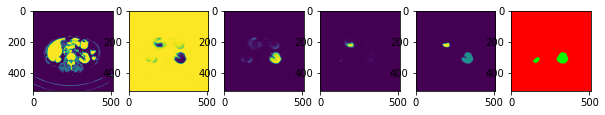

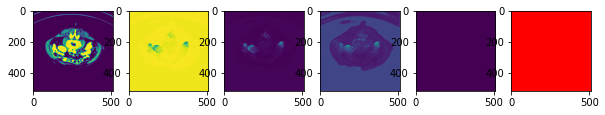

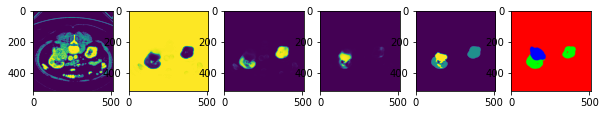

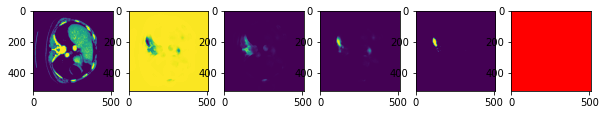

 47%|████▋     | 600/1280 [11:13<12:17,  1.08s/it, loss=0.514, iou=0.348]

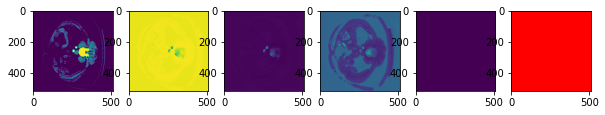

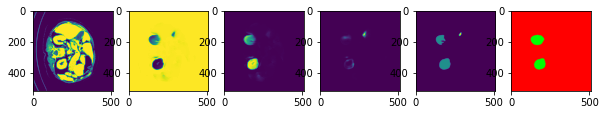

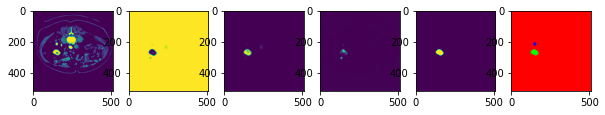

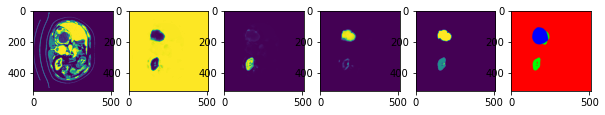

 51%|█████     | 650/1280 [12:10<11:19,  1.08s/it, loss=0.514, iou=0.343]

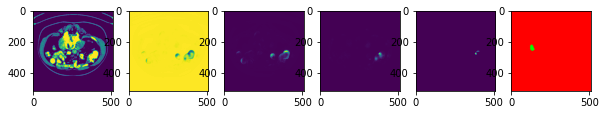

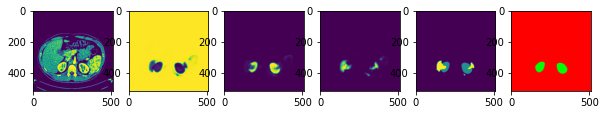

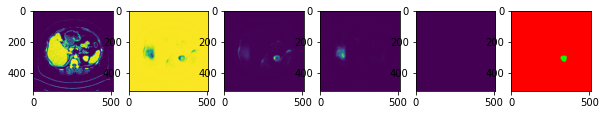

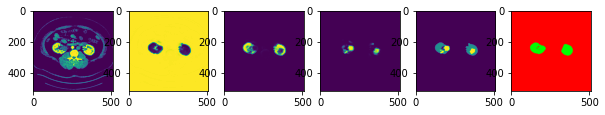

 55%|█████▍    | 700/1280 [13:07<10:26,  1.08s/it, loss=0.514, iou=0.347]

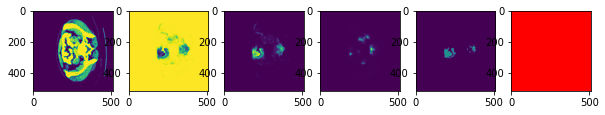

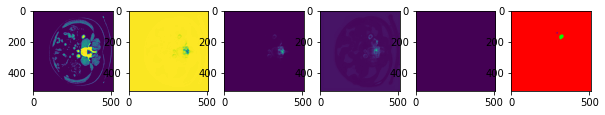

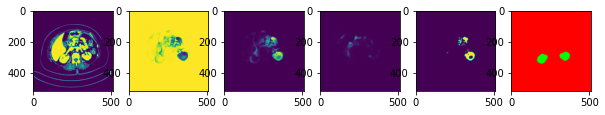

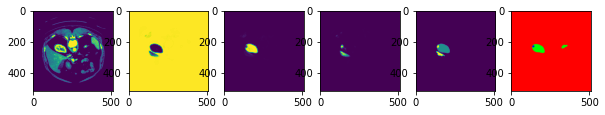

 59%|█████▊    | 750/1280 [14:03<09:32,  1.08s/it, loss=0.514, iou=0.346]

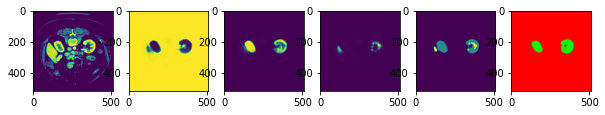

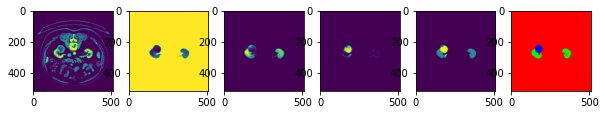

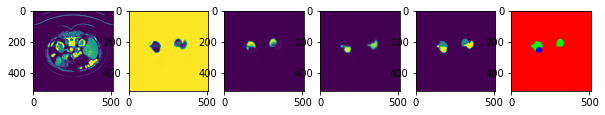

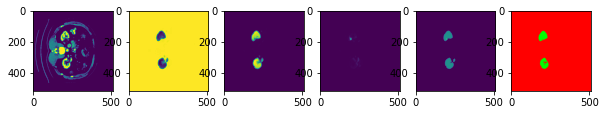

 62%|██████▎   | 800/1280 [15:00<08:39,  1.08s/it, loss=0.514, iou=0.348]

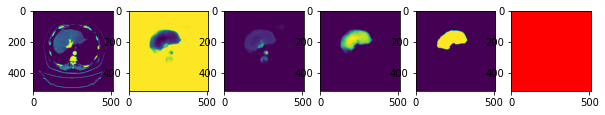

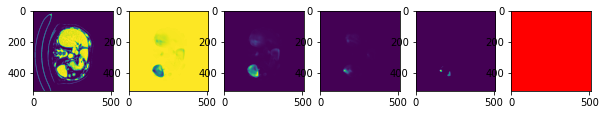

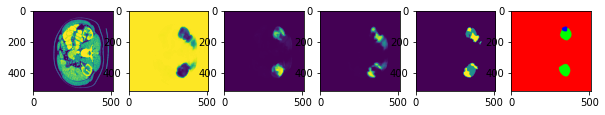

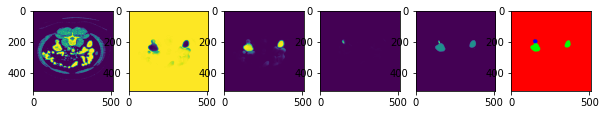

 66%|██████▋   | 850/1280 [15:57<07:43,  1.08s/it, loss=0.513, iou=0.348]

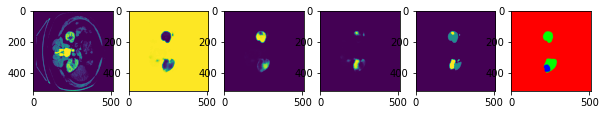

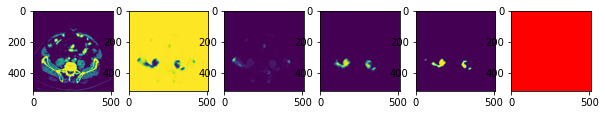

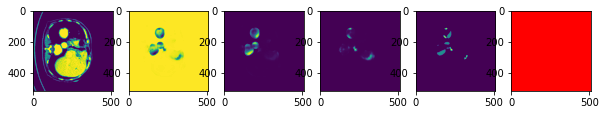

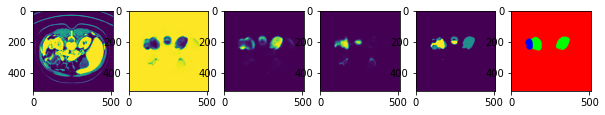

 70%|███████   | 900/1280 [16:53<06:50,  1.08s/it, loss=0.513, iou=0.346]

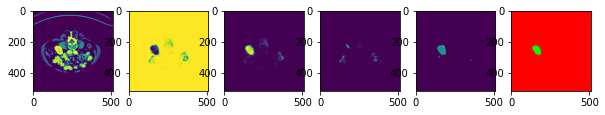

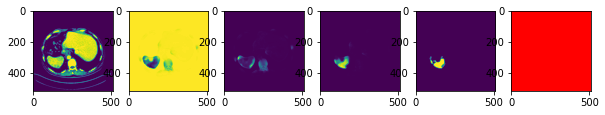

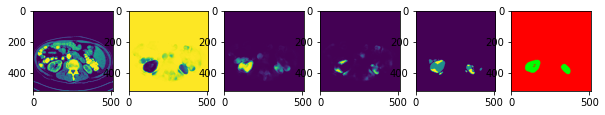

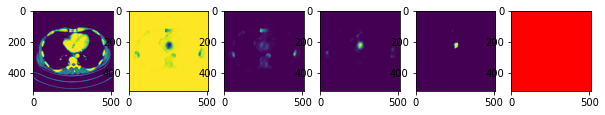

 74%|███████▍  | 950/1280 [17:50<05:57,  1.08s/it, loss=0.513, iou=0.347]

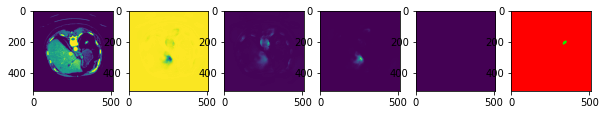

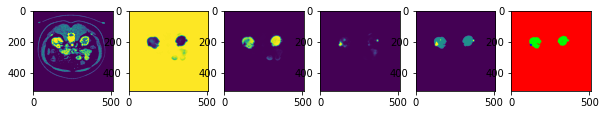

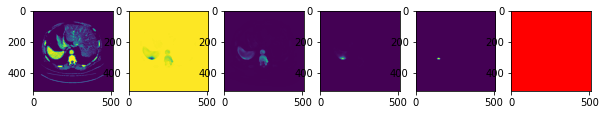

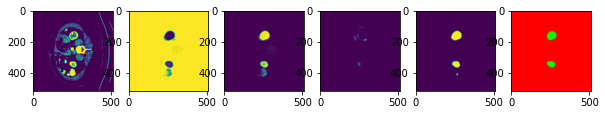

 78%|███████▊  | 1000/1280 [18:46<05:02,  1.08s/it, loss=0.513, iou=0.351]

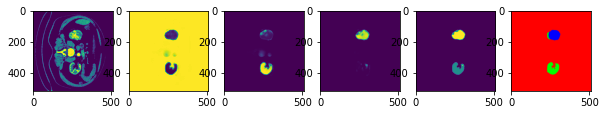

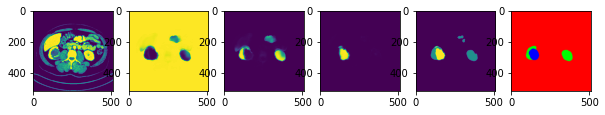

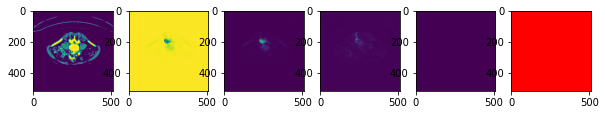

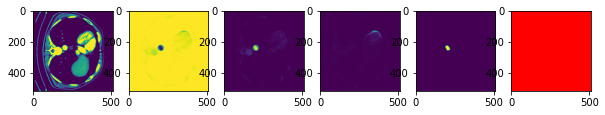

 82%|████████▏ | 1050/1280 [19:43<04:09,  1.08s/it, loss=0.512, iou=0.351]

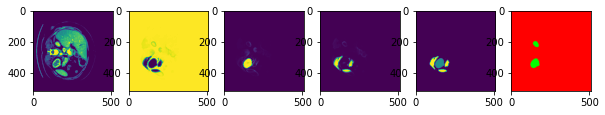

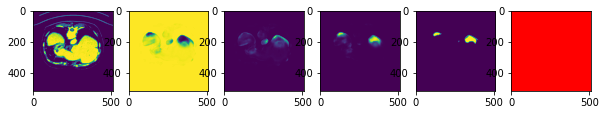

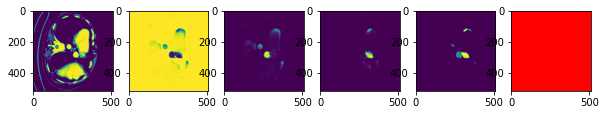

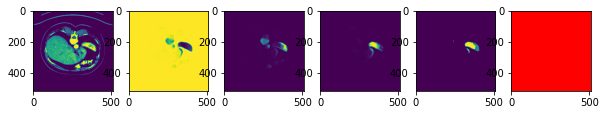

 86%|████████▌ | 1100/1280 [20:40<03:14,  1.08s/it, loss=0.512, iou=0.353]

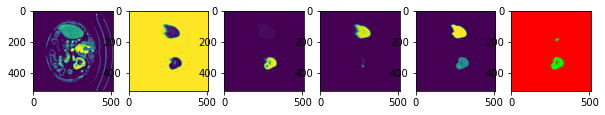

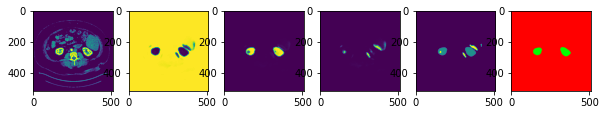

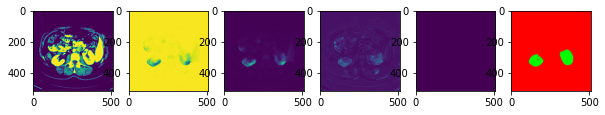

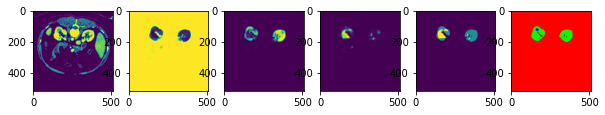

 90%|████████▉ | 1150/1280 [21:36<02:20,  1.08s/it, loss=0.512, iou=0.352]

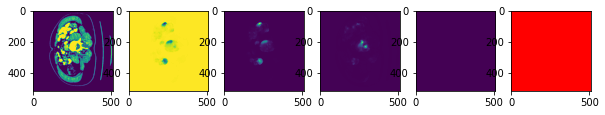

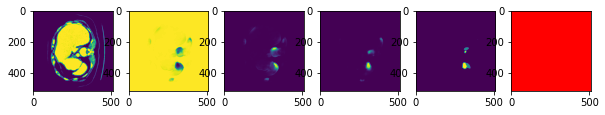

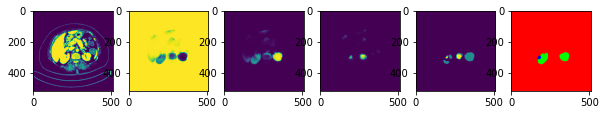

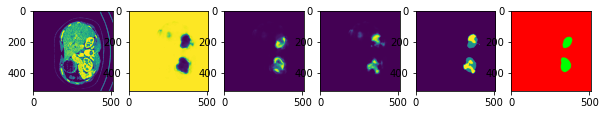

 94%|█████████▍| 1200/1280 [22:33<01:26,  1.08s/it, loss=0.512, iou=0.351]

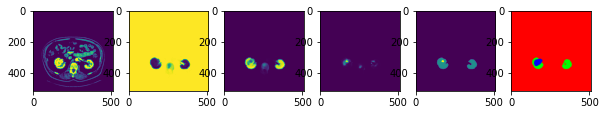

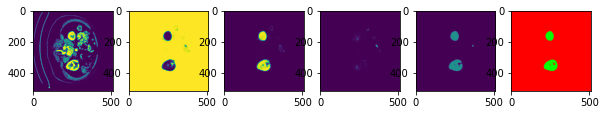

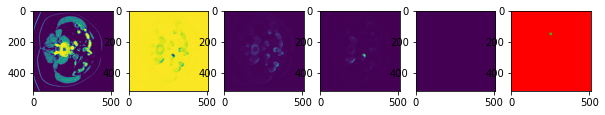

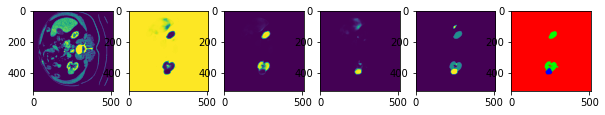

 98%|█████████▊| 1250/1280 [23:30<00:32,  1.08s/it, loss=0.511, iou=0.353]

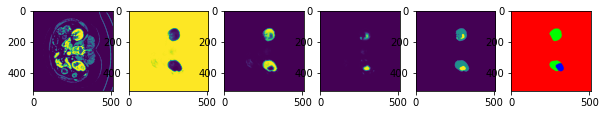

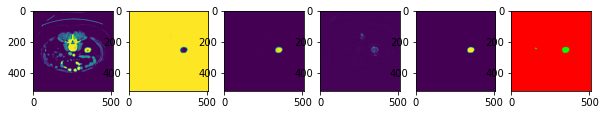

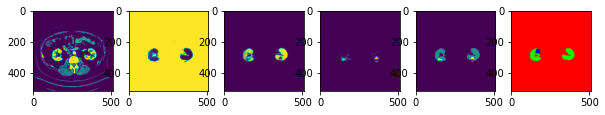

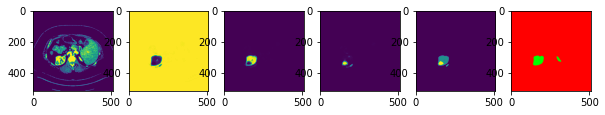

  0%|          | 0/320 [00:00<?, ?it/s]

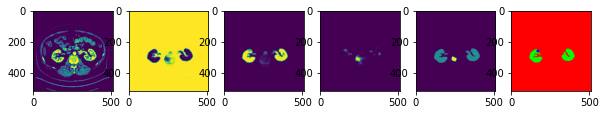

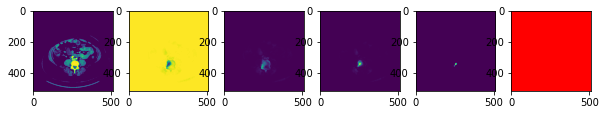

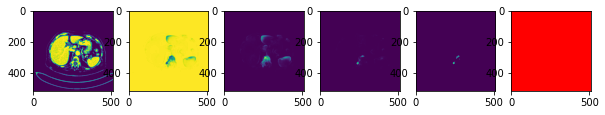

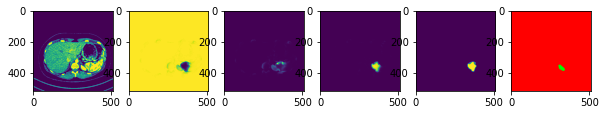

 16%|█▌        | 50/320 [00:19<01:28,  3.06it/s, loss=0.504, iou=0.413]

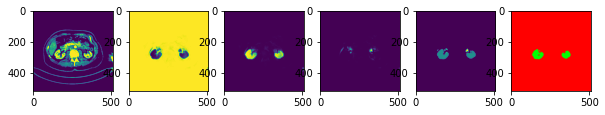

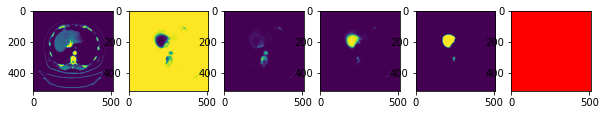

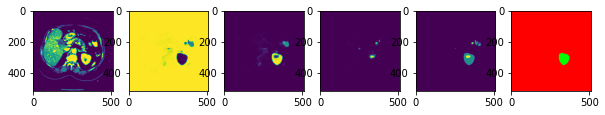

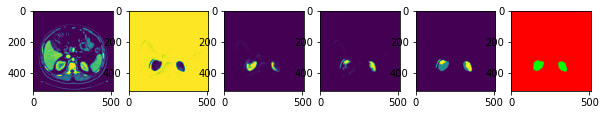

 31%|███▏      | 100/320 [00:38<01:12,  3.05it/s, loss=0.503, iou=0.416]

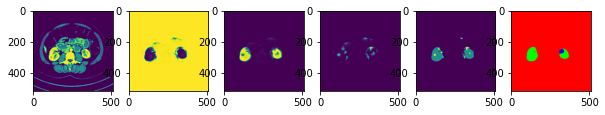

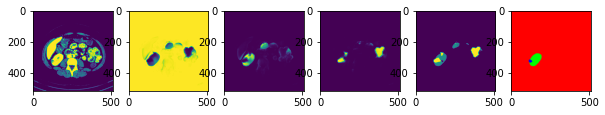

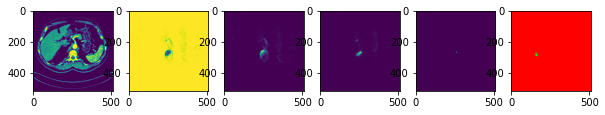

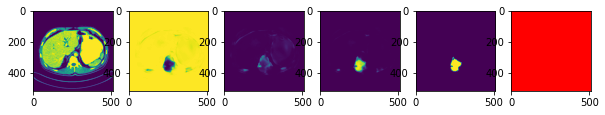

 47%|████▋     | 150/320 [00:57<00:55,  3.05it/s, loss=0.507, iou=0.404]

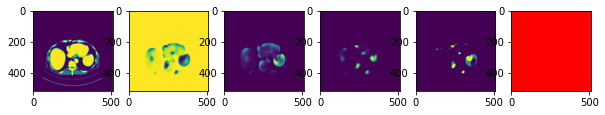

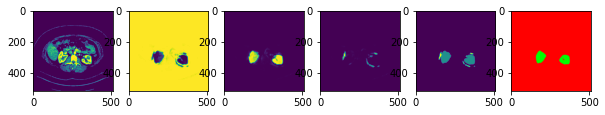

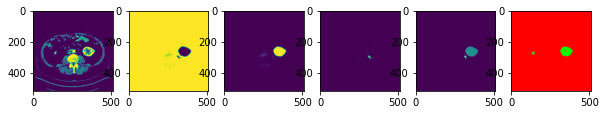

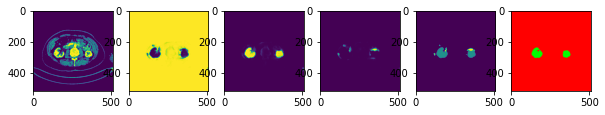

 62%|██████▎   | 200/320 [01:16<00:39,  3.05it/s, loss=0.508, iou=0.398]

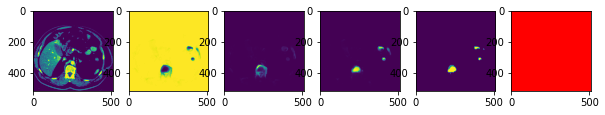

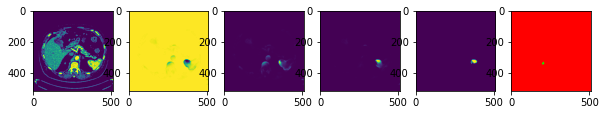

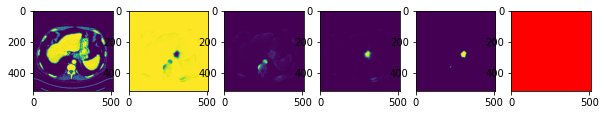

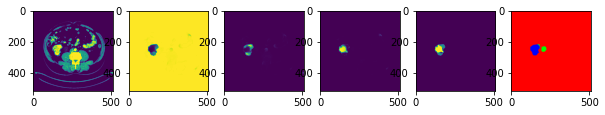

 78%|███████▊  | 250/320 [01:35<00:22,  3.06it/s, loss=0.508, iou=0.39]

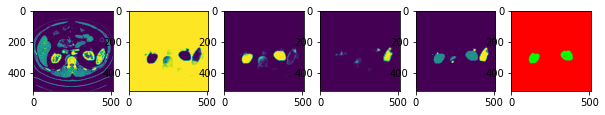

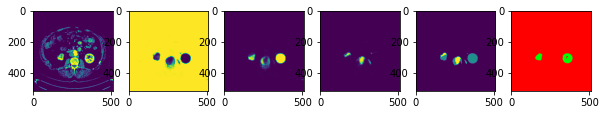

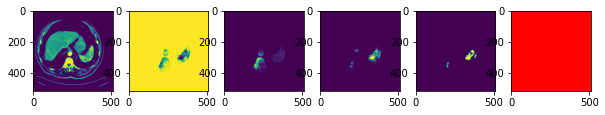

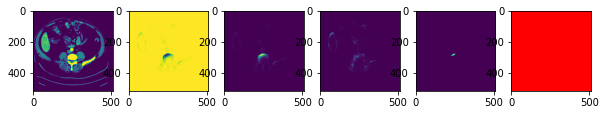

 94%|█████████▍| 300/320 [01:54<00:06,  3.06it/s, loss=0.508, iou=0.386]

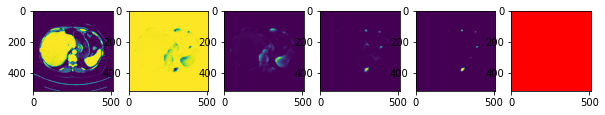

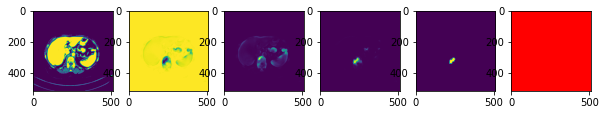

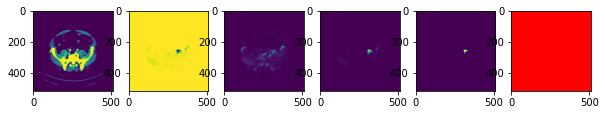

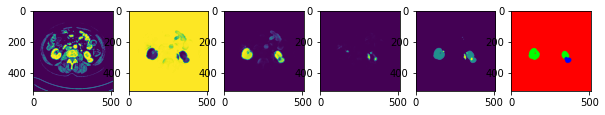

100%|██████████| 320/320 [02:03<00:00,  2.59it/s, loss=0.508, iou=0.387]


=>saving checkpoint...
=> SAVED BEST IOU
=>Training for epoch 2


  0%|          | 0/1280 [00:00<?, ?it/s]

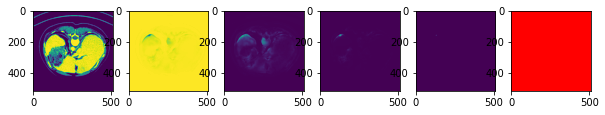

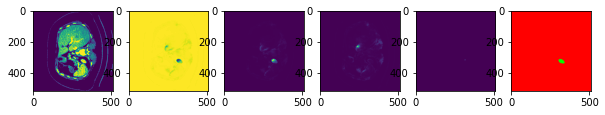

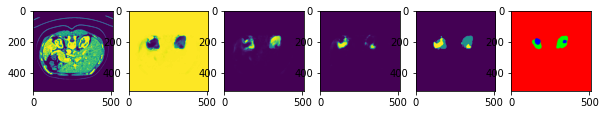

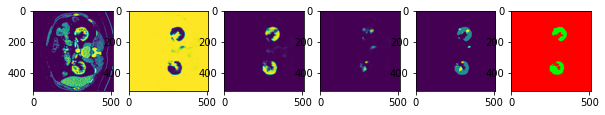

  4%|▍         | 50/1280 [00:56<21:56,  1.07s/it, loss=0.501, iou=0.383]

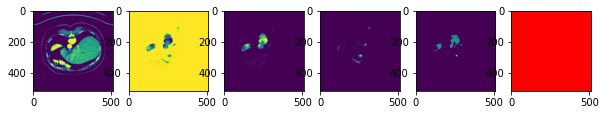

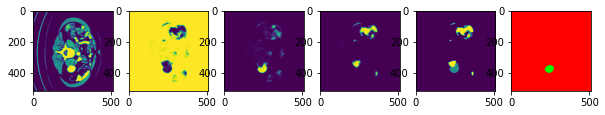

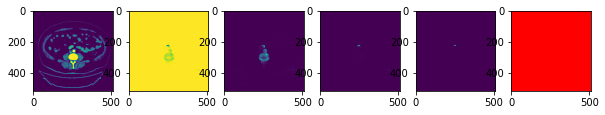

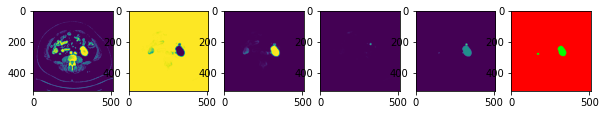

  8%|▊         | 100/1280 [01:52<21:17,  1.08s/it, loss=0.504, iou=0.383]

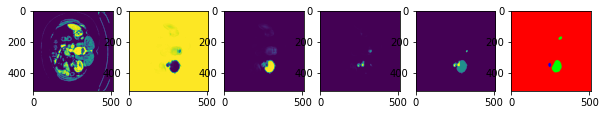

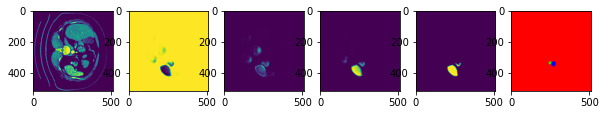

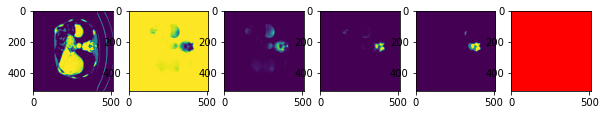

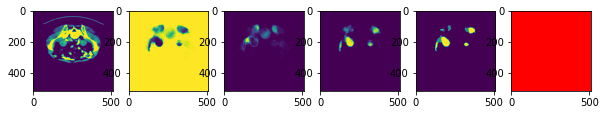

 12%|█▏        | 150/1280 [02:49<20:22,  1.08s/it, loss=0.504, iou=0.375]

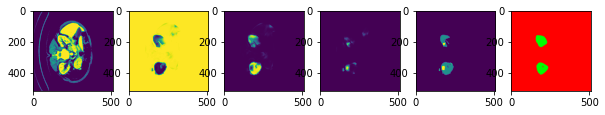

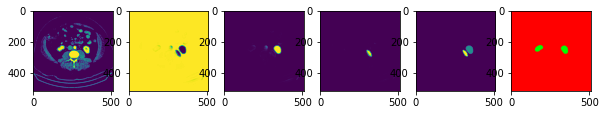

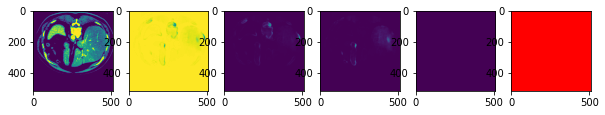

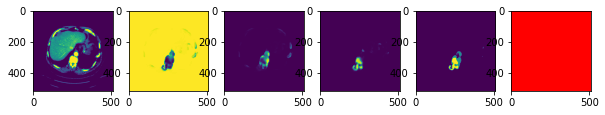

 16%|█▌        | 200/1280 [03:45<19:24,  1.08s/it, loss=0.504, iou=0.383]

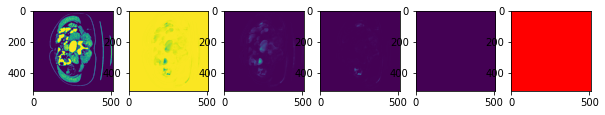

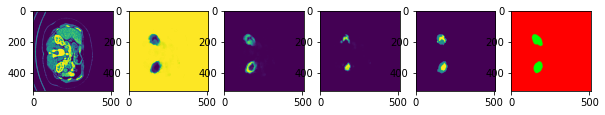

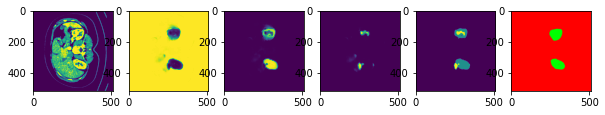

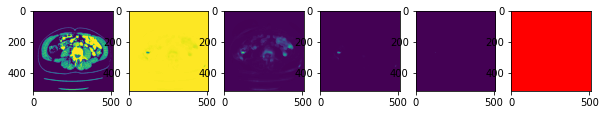

 20%|█▉        | 250/1280 [04:42<18:33,  1.08s/it, loss=0.504, iou=0.388]

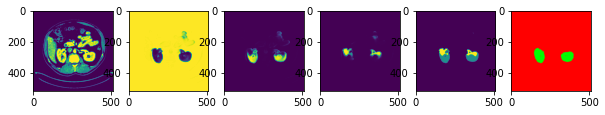

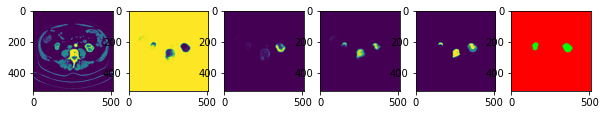

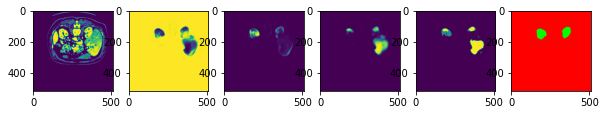

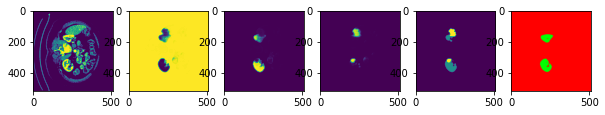

 23%|██▎       | 300/1280 [05:39<17:39,  1.08s/it, loss=0.505, iou=0.392]

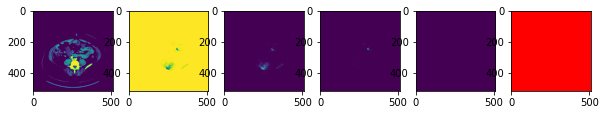

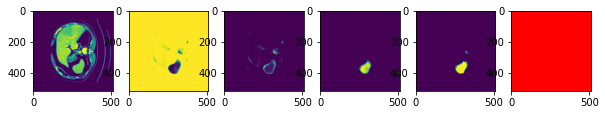

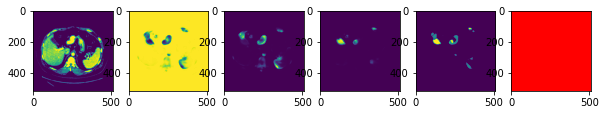

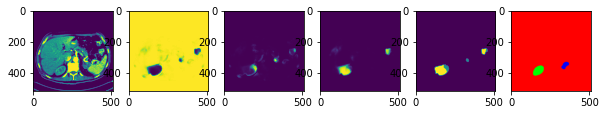

 27%|██▋       | 350/1280 [06:35<16:48,  1.08s/it, loss=0.505, iou=0.382]

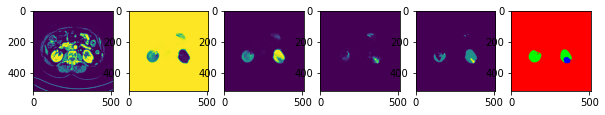

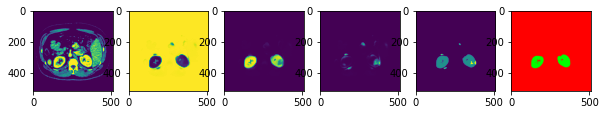

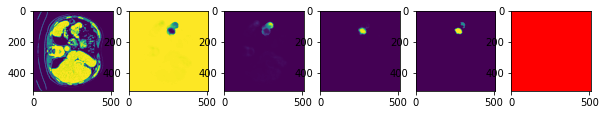

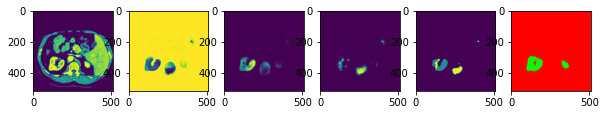

 31%|███▏      | 400/1280 [07:32<15:50,  1.08s/it, loss=0.506, iou=0.389]

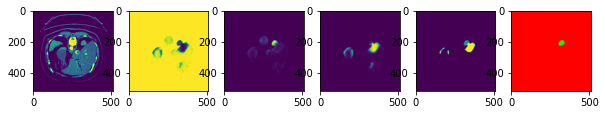

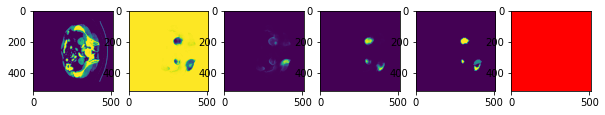

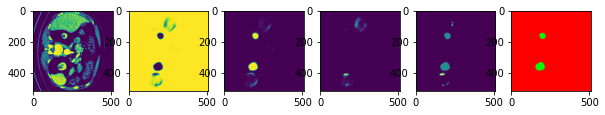

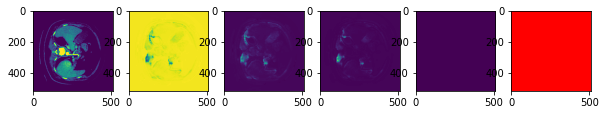

 35%|███▌      | 450/1280 [08:29<14:55,  1.08s/it, loss=0.506, iou=0.389]

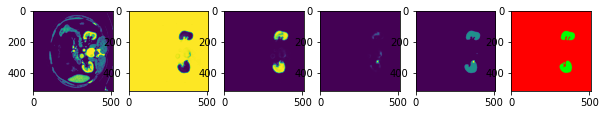

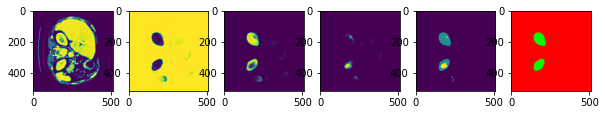

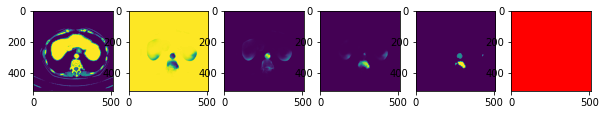

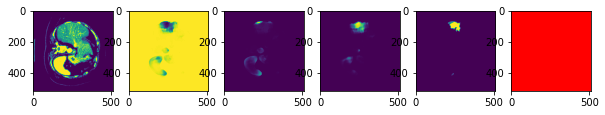

 39%|███▉      | 500/1280 [09:25<14:03,  1.08s/it, loss=0.505, iou=0.393]

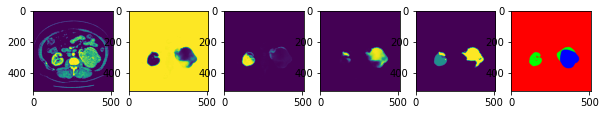

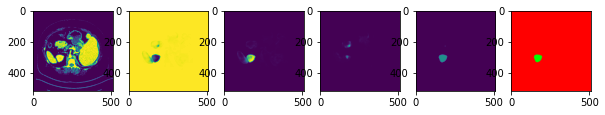

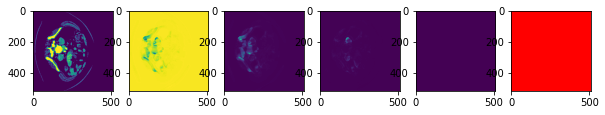

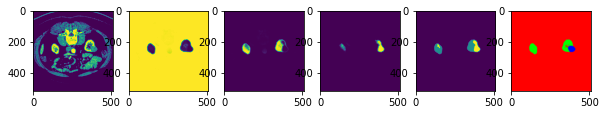

 43%|████▎     | 550/1280 [10:22<13:09,  1.08s/it, loss=0.505, iou=0.393]

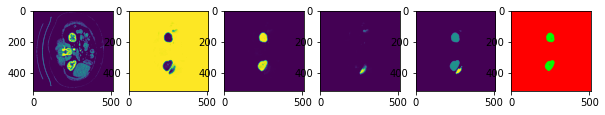

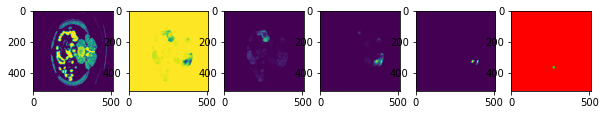

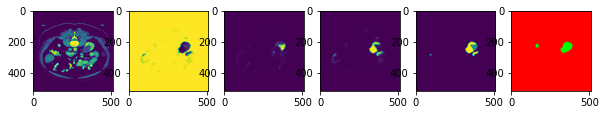

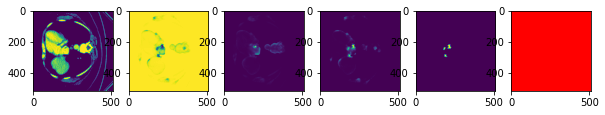

 47%|████▋     | 600/1280 [11:19<12:13,  1.08s/it, loss=0.504, iou=0.396]

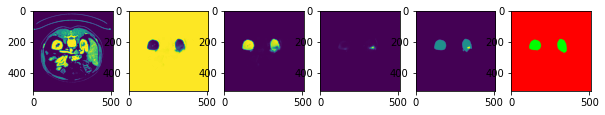

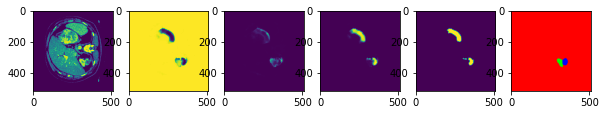

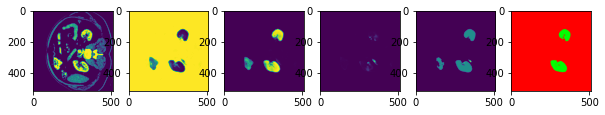

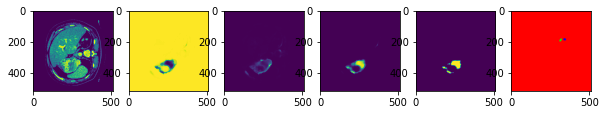

 51%|█████     | 650/1280 [12:16<11:20,  1.08s/it, loss=0.504, iou=0.402]

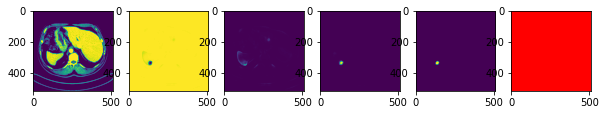

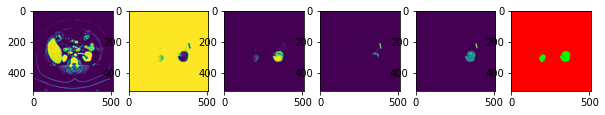

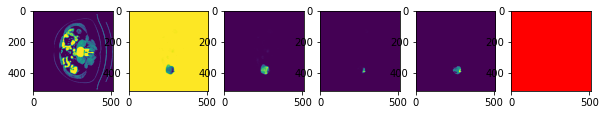

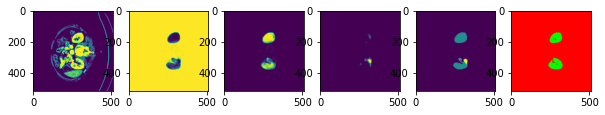

 55%|█████▍    | 700/1280 [13:12<10:27,  1.08s/it, loss=0.504, iou=0.404]

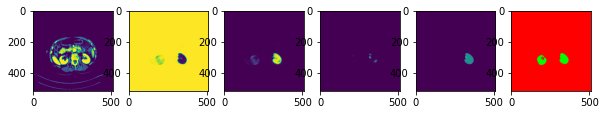

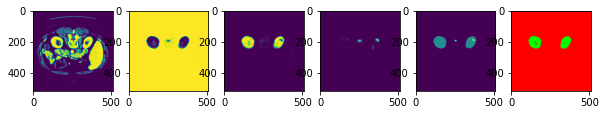

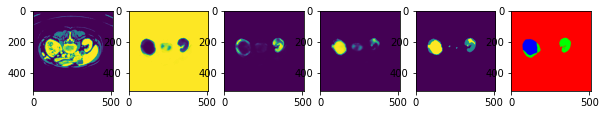

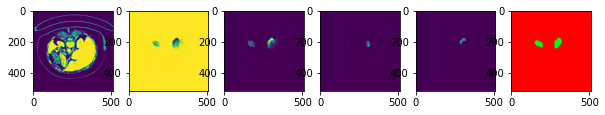

 59%|█████▊    | 750/1280 [14:09<09:32,  1.08s/it, loss=0.503, iou=0.405]

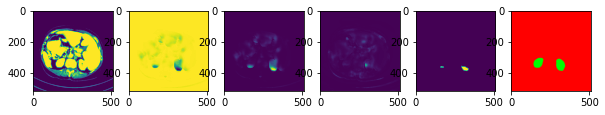

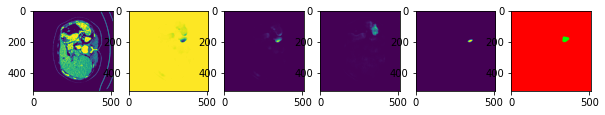

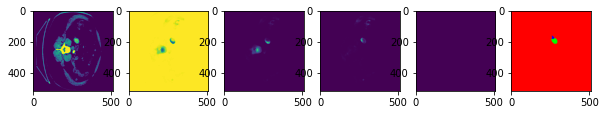

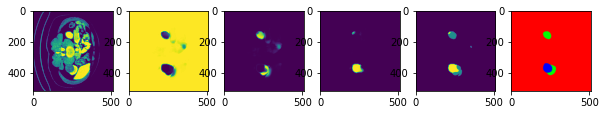

 62%|██████▎   | 800/1280 [15:05<08:39,  1.08s/it, loss=0.503, iou=0.406]

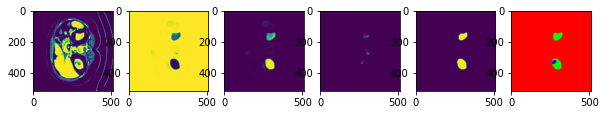

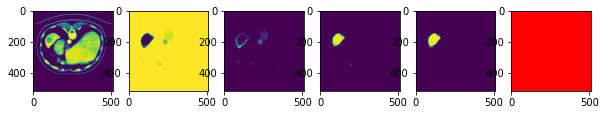

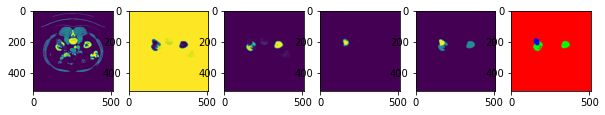

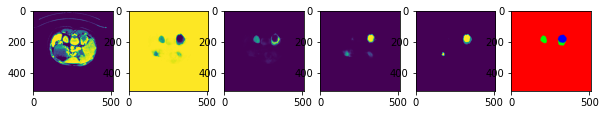

 66%|██████▋   | 850/1280 [16:02<07:44,  1.08s/it, loss=0.503, iou=0.407]

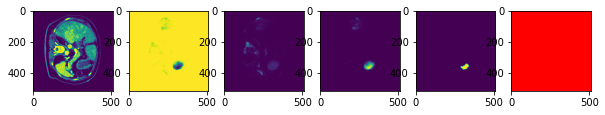

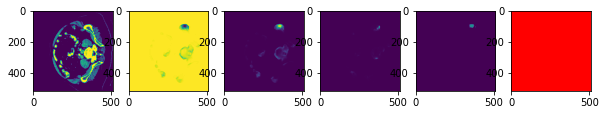

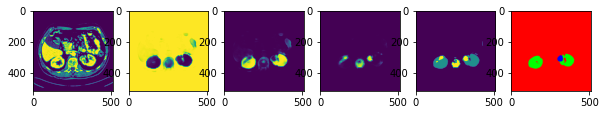

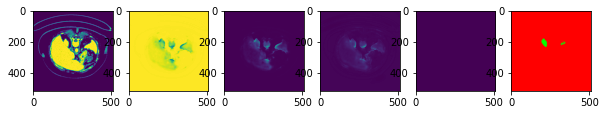

 70%|███████   | 900/1280 [16:59<06:51,  1.08s/it, loss=0.502, iou=0.406]

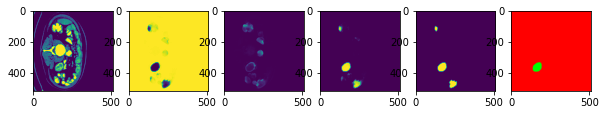

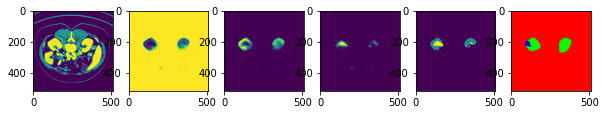

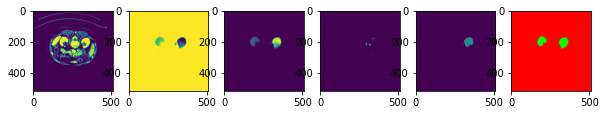

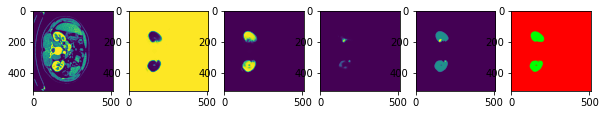

 74%|███████▍  | 950/1280 [17:55<05:57,  1.08s/it, loss=0.502, iou=0.406]

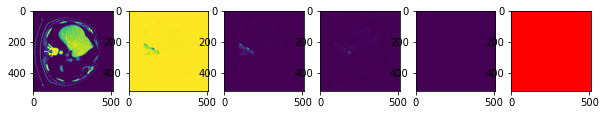

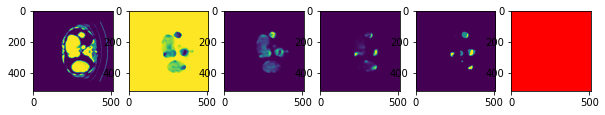

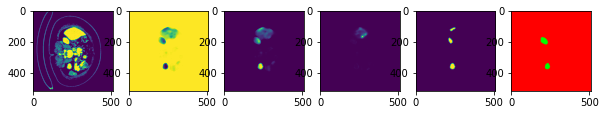

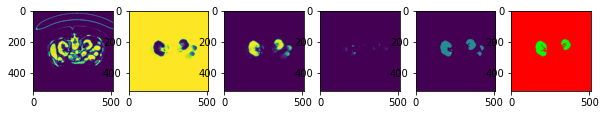

 78%|███████▊  | 1000/1280 [18:52<05:03,  1.08s/it, loss=0.502, iou=0.406]

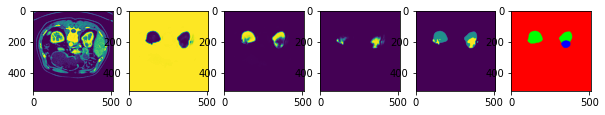

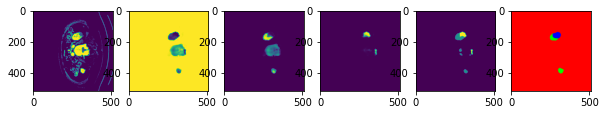

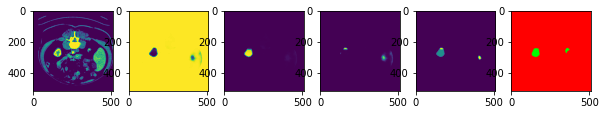

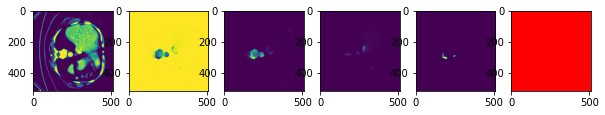

 82%|████████▏ | 1050/1280 [19:49<04:08,  1.08s/it, loss=0.502, iou=0.407]

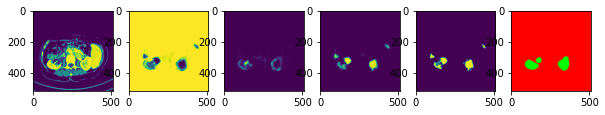

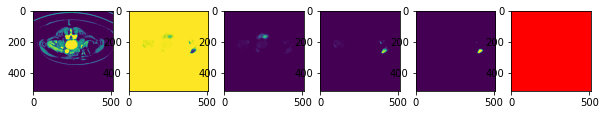

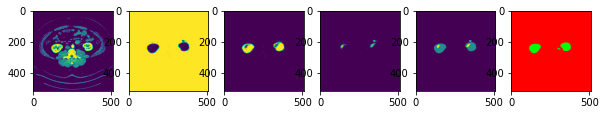

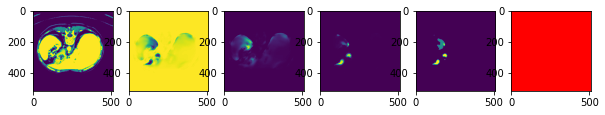

 86%|████████▌ | 1100/1280 [20:45<03:15,  1.08s/it, loss=0.502, iou=0.408]

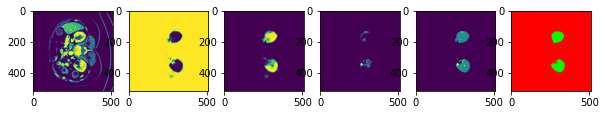

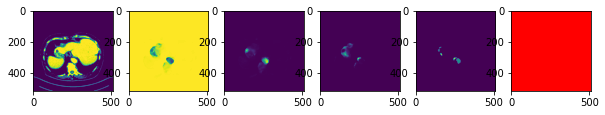

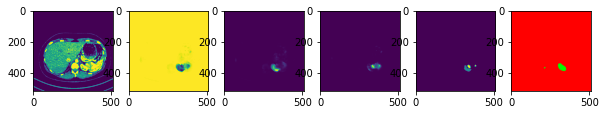

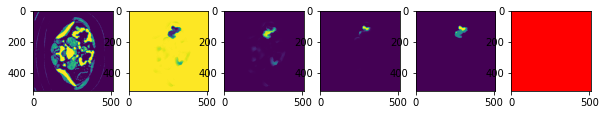

 90%|████████▉ | 1150/1280 [21:42<02:20,  1.08s/it, loss=0.502, iou=0.411]

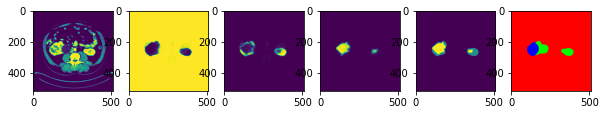

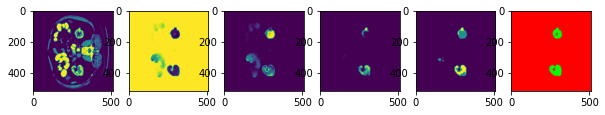

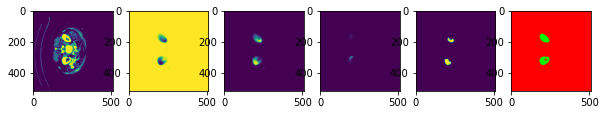

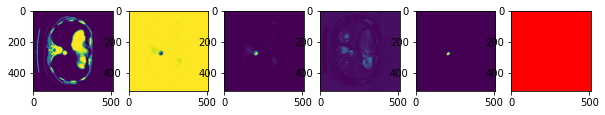

 94%|█████████▍| 1200/1280 [22:39<01:26,  1.08s/it, loss=0.502, iou=0.415]

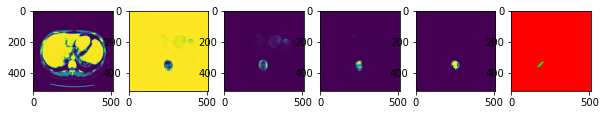

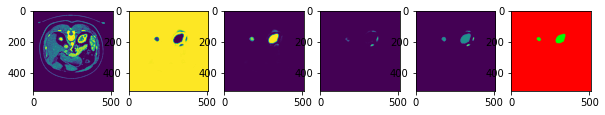

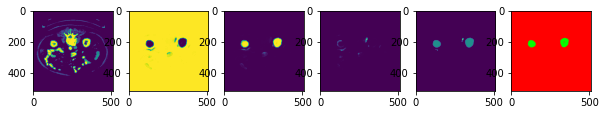

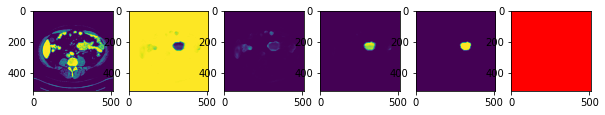

 98%|█████████▊| 1250/1280 [23:36<00:32,  1.08s/it, loss=0.501, iou=0.416]

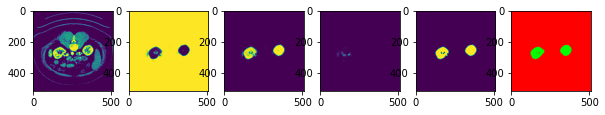

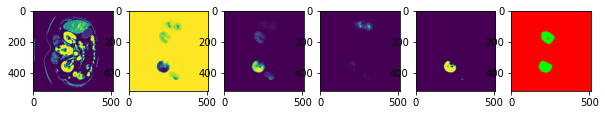

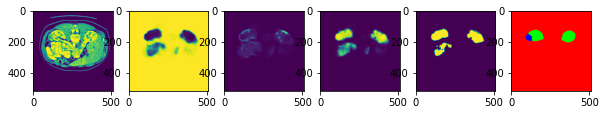

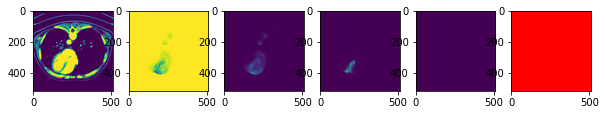

  0%|          | 0/320 [00:00<?, ?it/s]

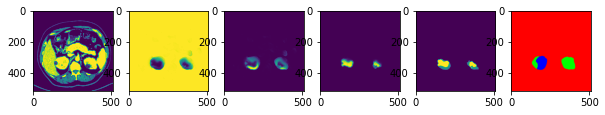

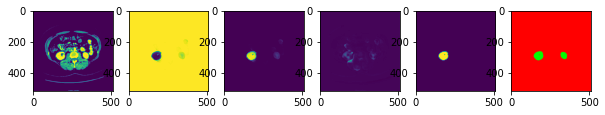

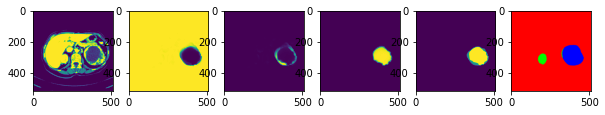

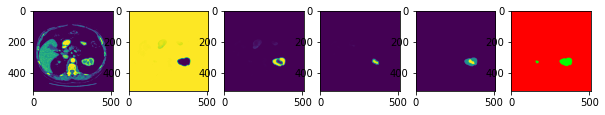

 16%|█▌        | 50/320 [00:19<01:28,  3.04it/s, loss=0.491, iou=0.516]

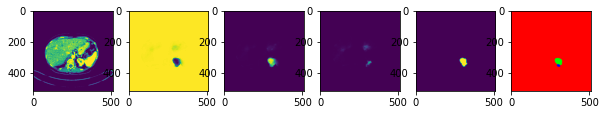

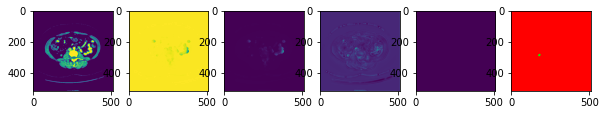

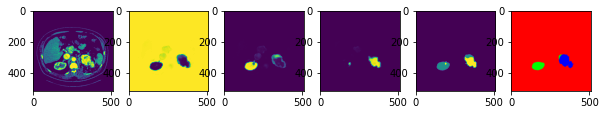

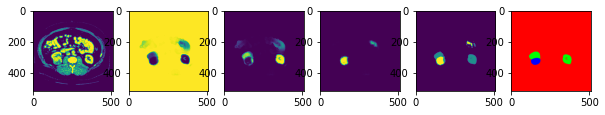

 31%|███▏      | 100/320 [00:38<01:12,  3.04it/s, loss=0.494, iou=0.509]

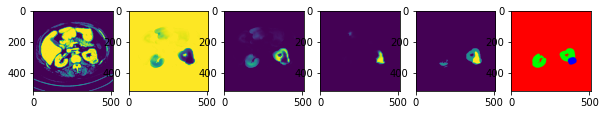

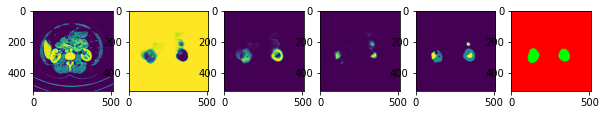

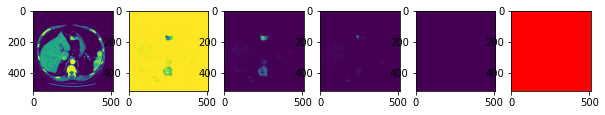

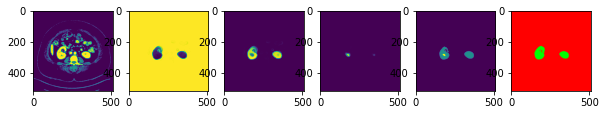

 47%|████▋     | 150/320 [00:57<00:56,  3.04it/s, loss=0.496, iou=0.52]

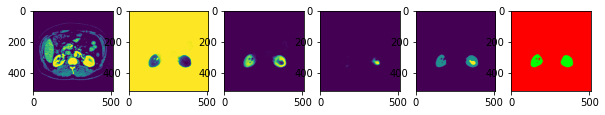

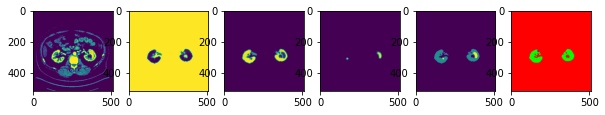

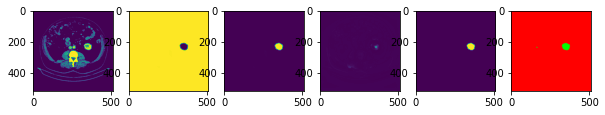

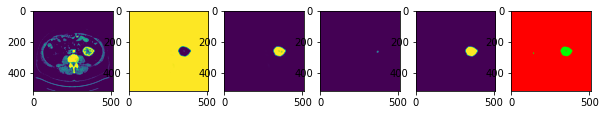

 62%|██████▎   | 200/320 [01:16<00:39,  3.04it/s, loss=0.498, iou=0.531]

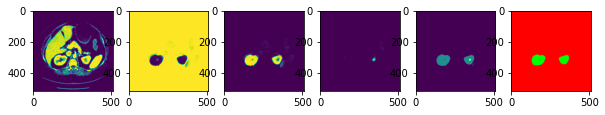

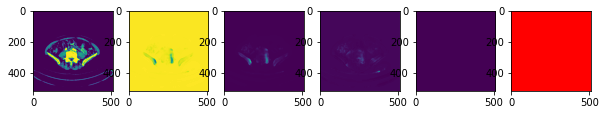

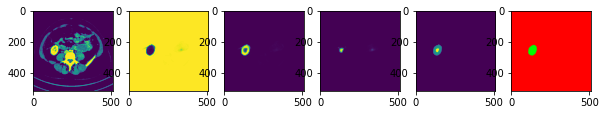

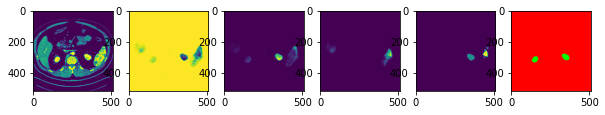

 78%|███████▊  | 250/320 [01:35<00:22,  3.04it/s, loss=0.498, iou=0.528]

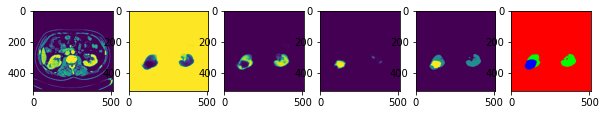

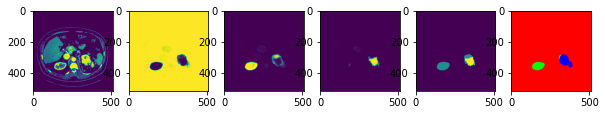

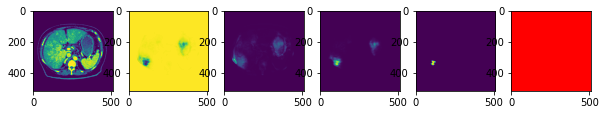

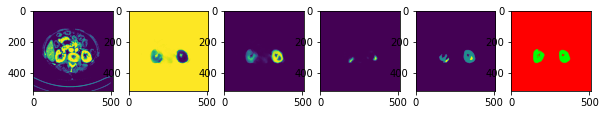

 94%|█████████▍| 300/320 [01:54<00:06,  3.03it/s, loss=0.498, iou=0.528]

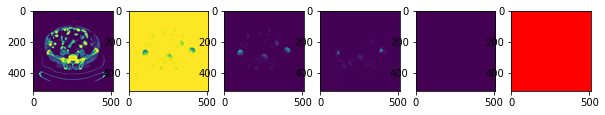

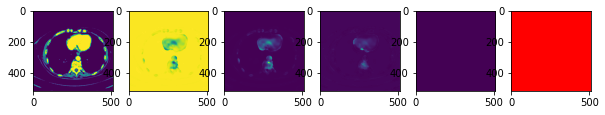

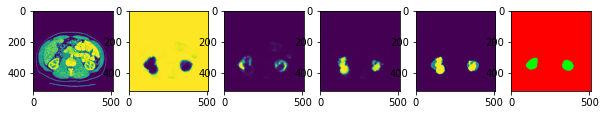

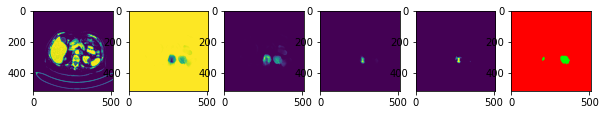

100%|██████████| 320/320 [02:03<00:00,  2.58it/s, loss=0.498, iou=0.528]


=>saving checkpoint...
=> SAVED BEST IOU
=>Training for epoch 3


  0%|          | 0/1280 [00:00<?, ?it/s]

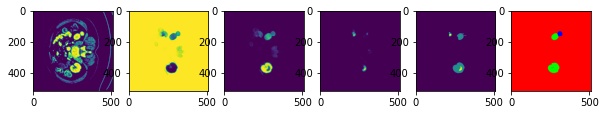

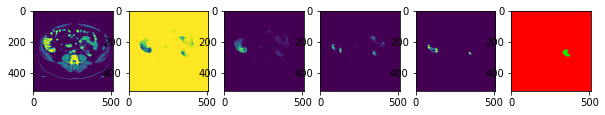

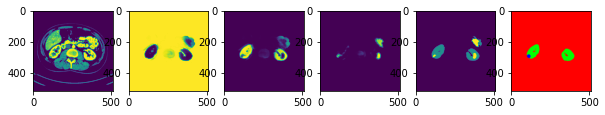

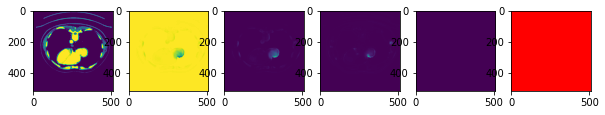

  4%|▍         | 50/1280 [00:56<22:01,  1.07s/it, loss=0.498, iou=0.432]

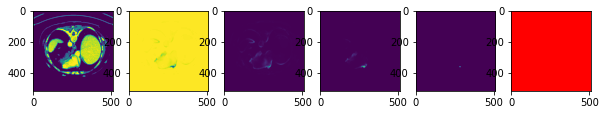

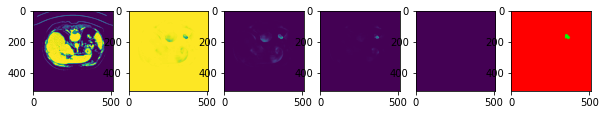

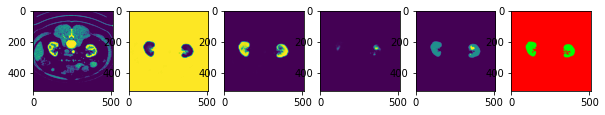

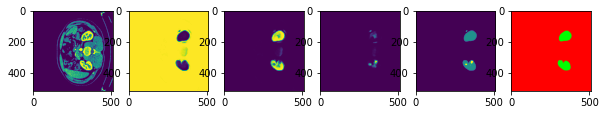

  8%|▊         | 100/1280 [01:52<21:16,  1.08s/it, loss=0.496, iou=0.443]

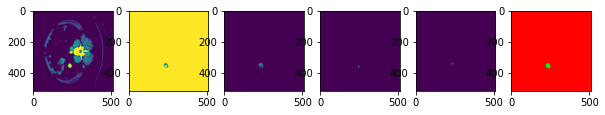

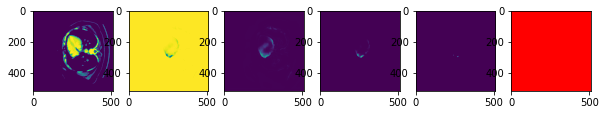

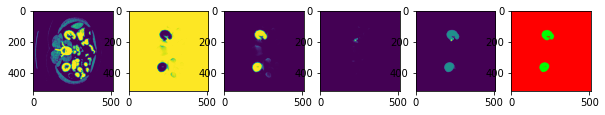

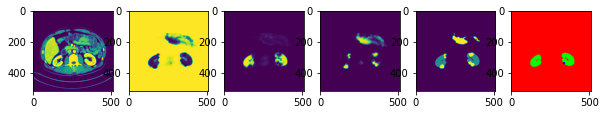

 12%|█▏        | 150/1280 [02:49<20:24,  1.08s/it, loss=0.5, iou=0.436]

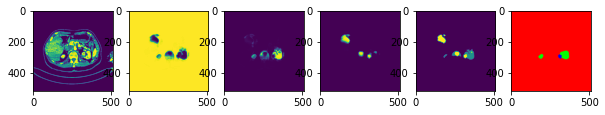

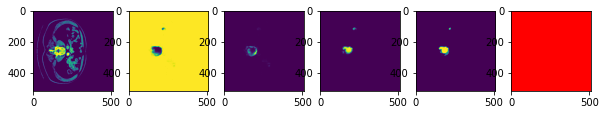

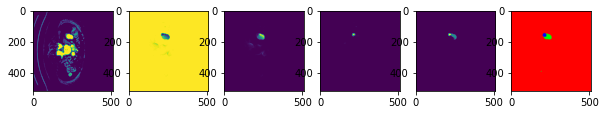

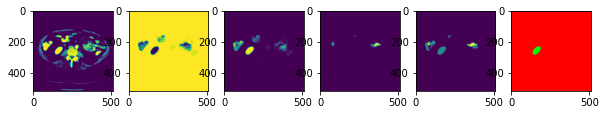

 16%|█▌        | 200/1280 [03:46<19:30,  1.08s/it, loss=0.498, iou=0.448]

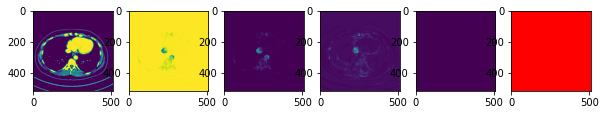

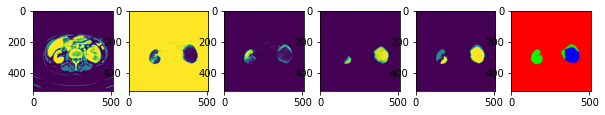

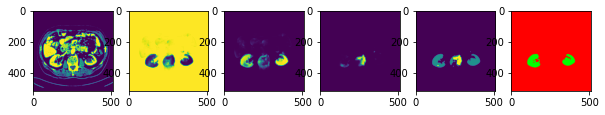

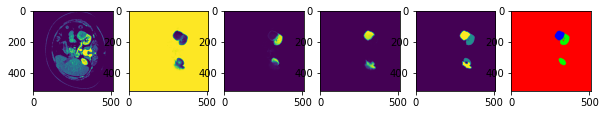

 20%|█▉        | 250/1280 [04:43<18:33,  1.08s/it, loss=0.497, iou=0.451]

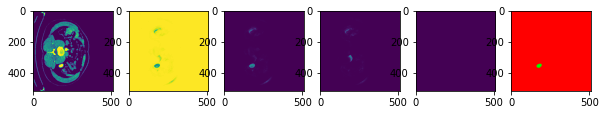

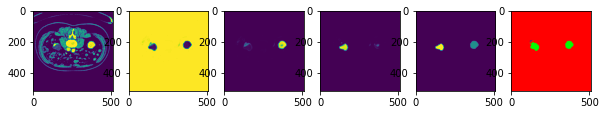

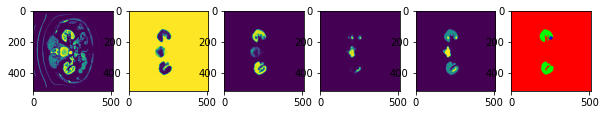

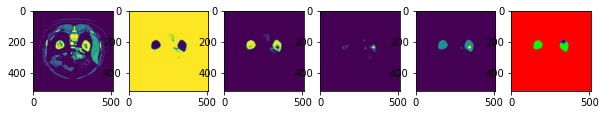

 23%|██▎       | 300/1280 [05:39<17:41,  1.08s/it, loss=0.497, iou=0.45]

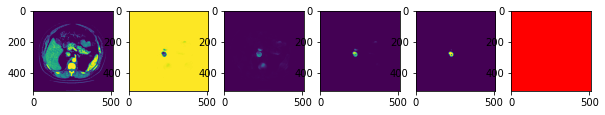

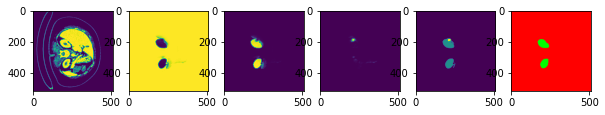

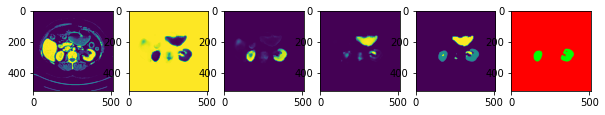

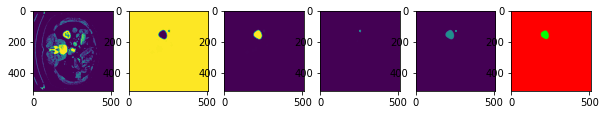

 27%|██▋       | 350/1280 [06:36<16:46,  1.08s/it, loss=0.498, iou=0.447]

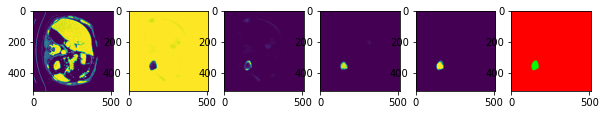

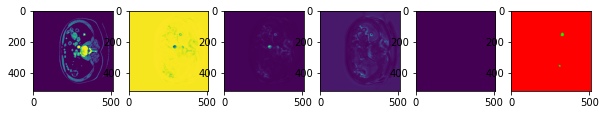

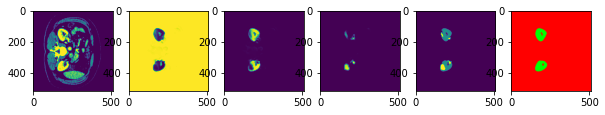

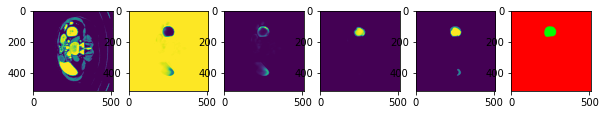

 31%|███▏      | 400/1280 [07:33<15:54,  1.08s/it, loss=0.498, iou=0.444]

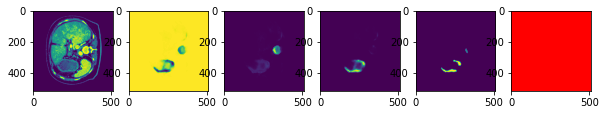

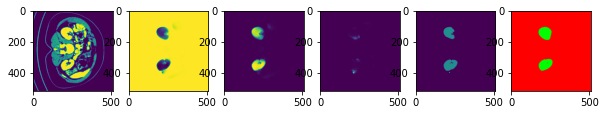

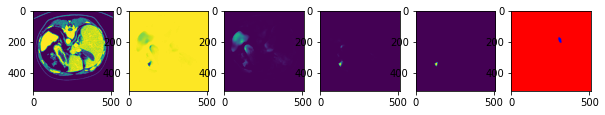

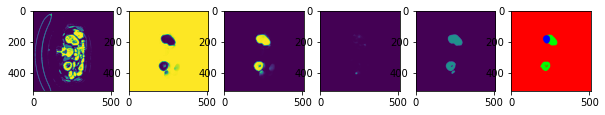

 35%|███▌      | 450/1280 [08:30<14:56,  1.08s/it, loss=0.498, iou=0.445]

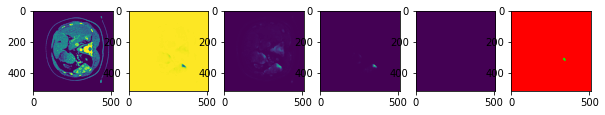

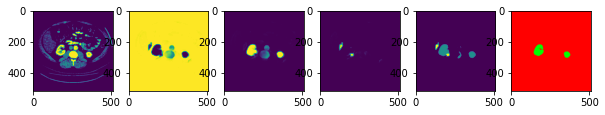

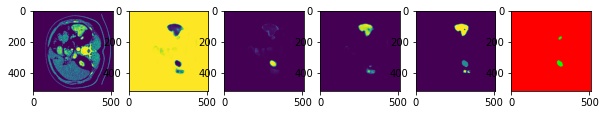

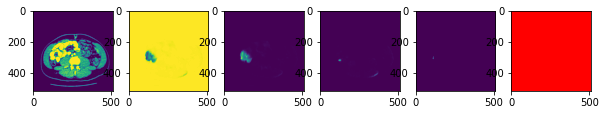

 39%|███▉      | 500/1280 [09:27<14:04,  1.08s/it, loss=0.498, iou=0.446]

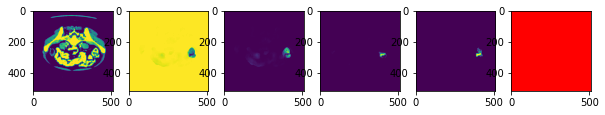

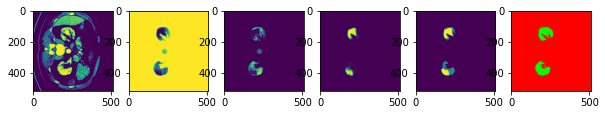

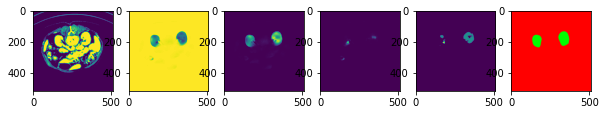

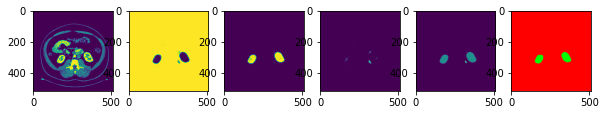

 43%|████▎     | 550/1280 [10:24<13:11,  1.08s/it, loss=0.499, iou=0.449]

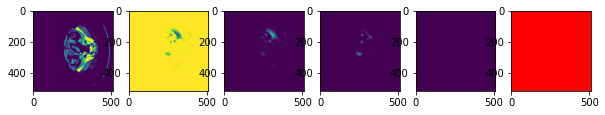

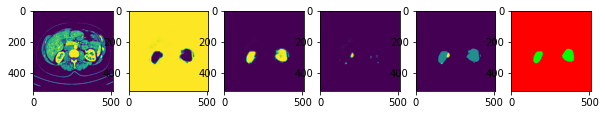

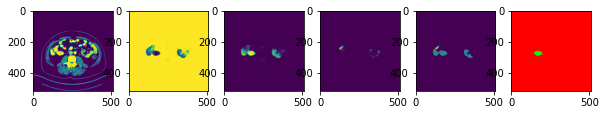

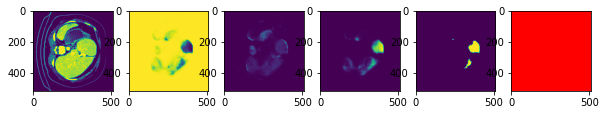

 47%|████▋     | 600/1280 [11:20<12:16,  1.08s/it, loss=0.498, iou=0.455]

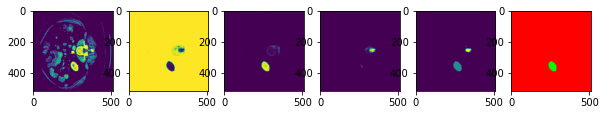

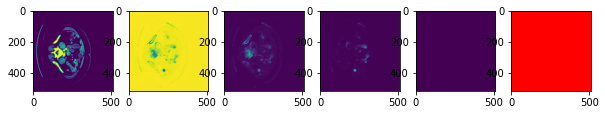

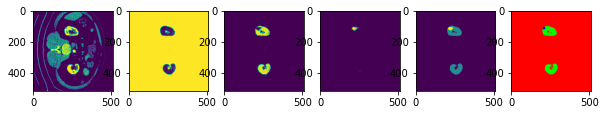

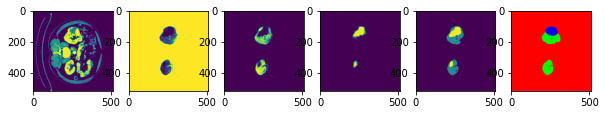

 51%|█████     | 650/1280 [12:17<11:21,  1.08s/it, loss=0.498, iou=0.455]

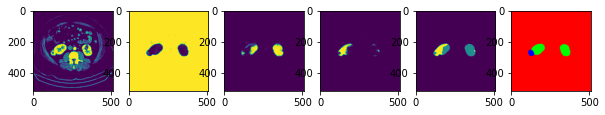

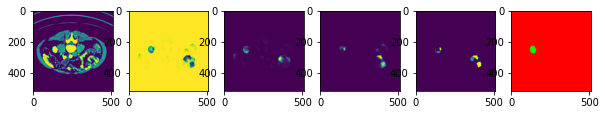

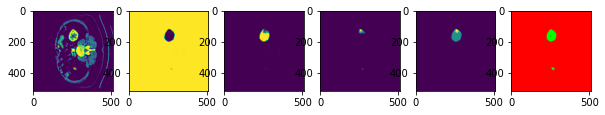

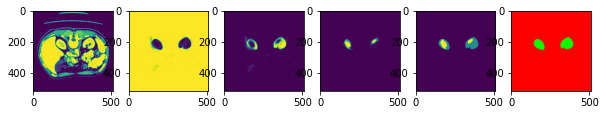

 55%|█████▍    | 700/1280 [13:14<10:29,  1.09s/it, loss=0.498, iou=0.454]

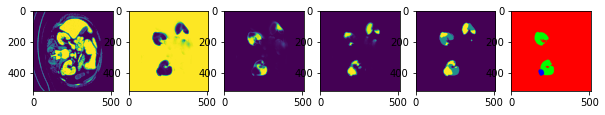

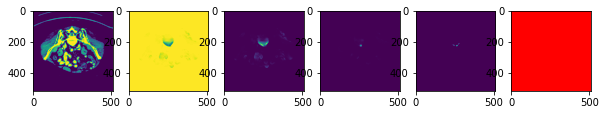

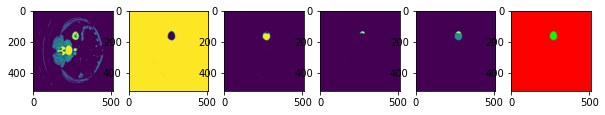

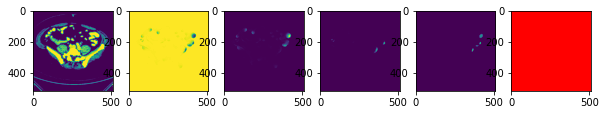

 59%|█████▊    | 750/1280 [14:10<09:33,  1.08s/it, loss=0.498, iou=0.453]

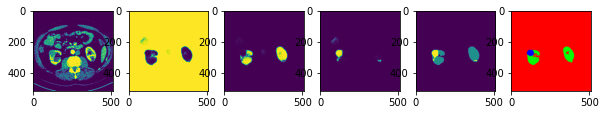

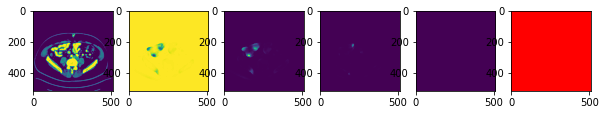

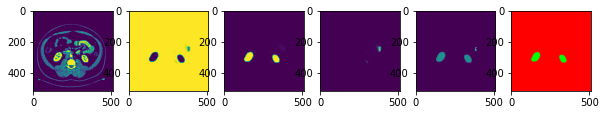

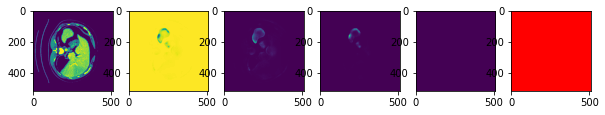

 62%|██████▎   | 800/1280 [15:07<08:39,  1.08s/it, loss=0.498, iou=0.453]

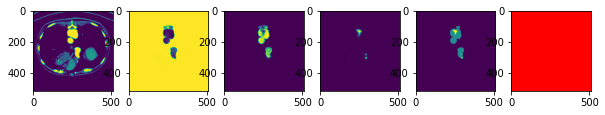

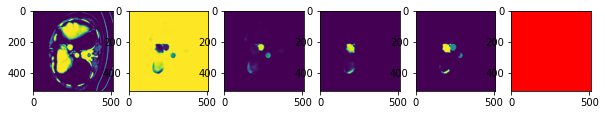

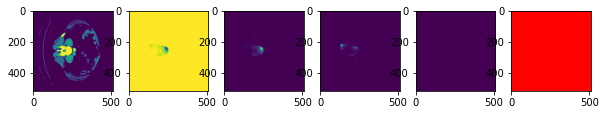

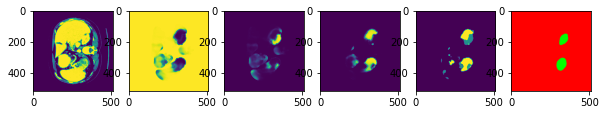

 66%|██████▋   | 850/1280 [16:04<07:46,  1.09s/it, loss=0.498, iou=0.456]

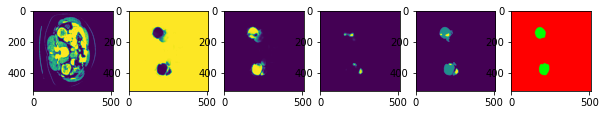

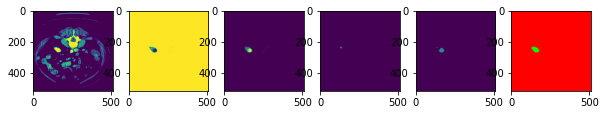

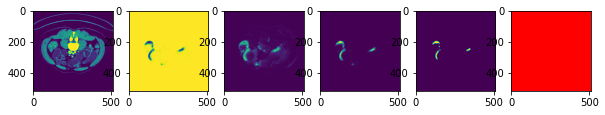

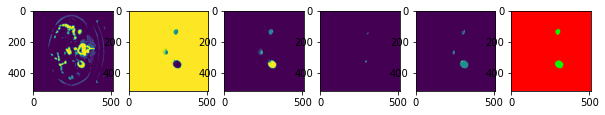

 70%|███████   | 900/1280 [17:01<06:51,  1.08s/it, loss=0.497, iou=0.456]

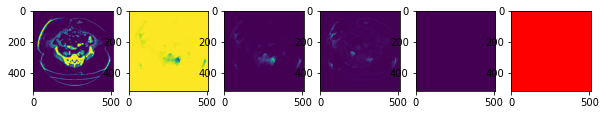

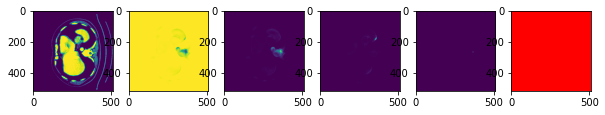

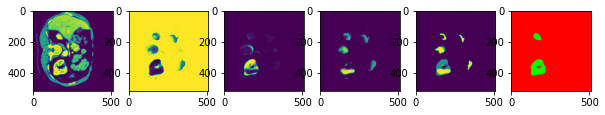

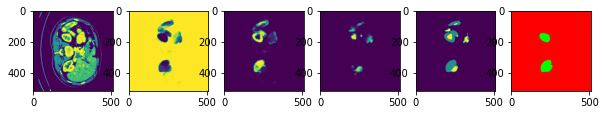

 74%|███████▍  | 950/1280 [17:58<05:57,  1.08s/it, loss=0.498, iou=0.455]

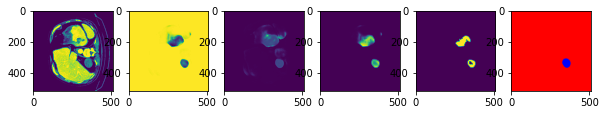

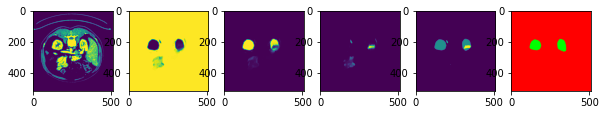

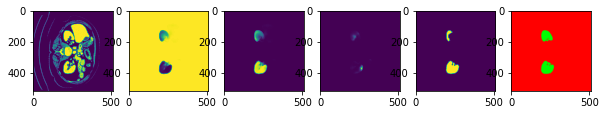

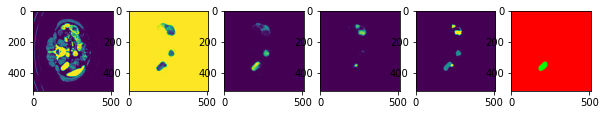

 78%|███████▊  | 1000/1280 [18:54<05:03,  1.09s/it, loss=0.497, iou=0.456]

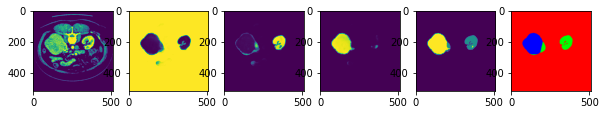

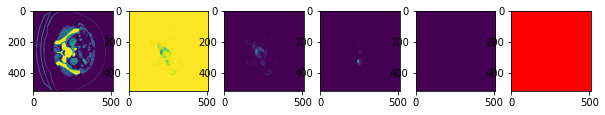

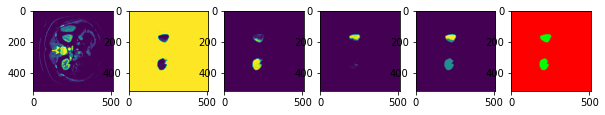

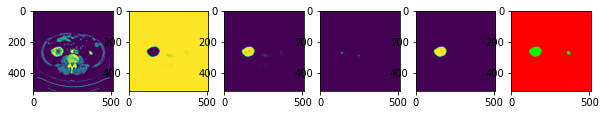

 82%|████████▏ | 1050/1280 [19:51<04:09,  1.08s/it, loss=0.497, iou=0.455]

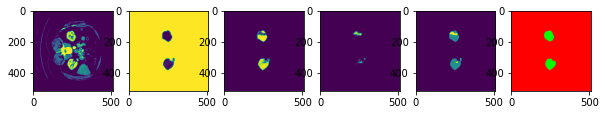

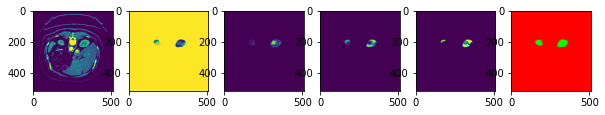

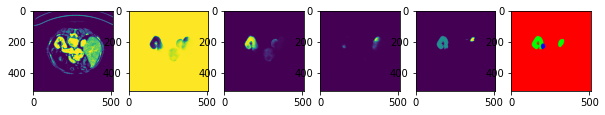

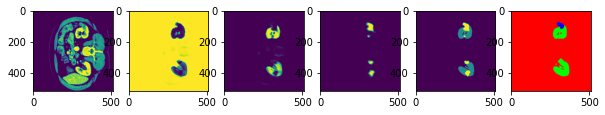

 86%|████████▌ | 1100/1280 [20:48<03:14,  1.08s/it, loss=0.497, iou=0.459]

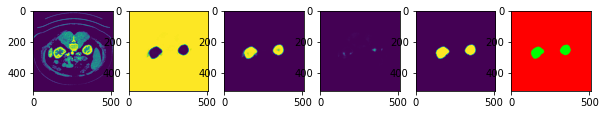

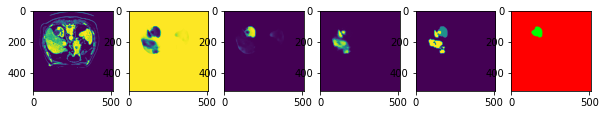

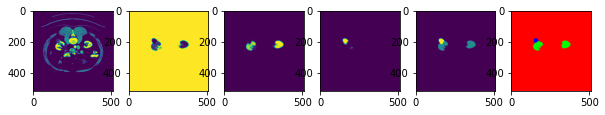

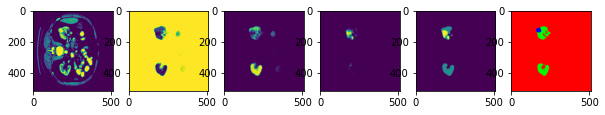

 90%|████████▉ | 1150/1280 [21:45<02:21,  1.09s/it, loss=0.496, iou=0.459]

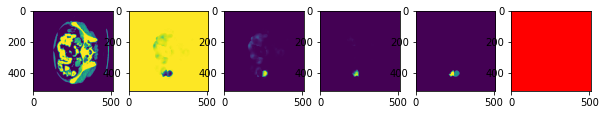

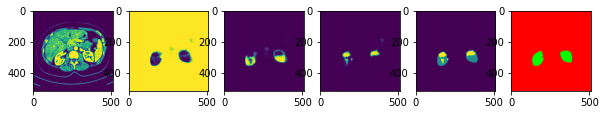

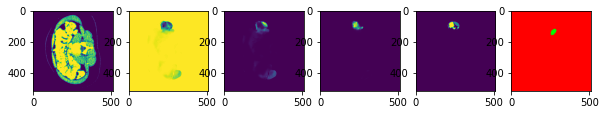

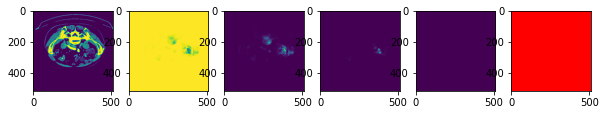

 94%|█████████▍| 1200/1280 [22:42<01:26,  1.08s/it, loss=0.496, iou=0.46]

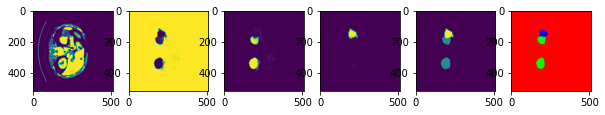

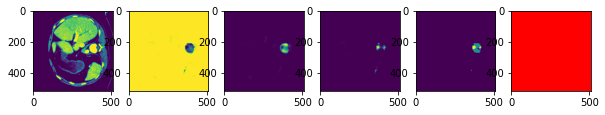

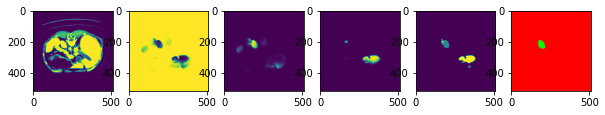

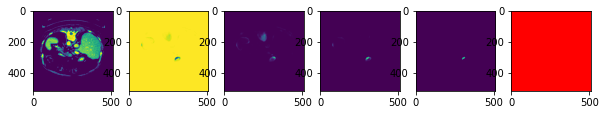

 98%|█████████▊| 1250/1280 [23:38<00:32,  1.09s/it, loss=0.496, iou=0.461]

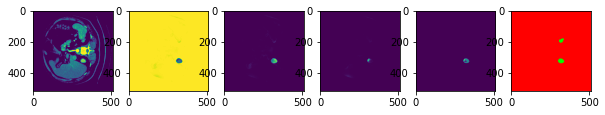

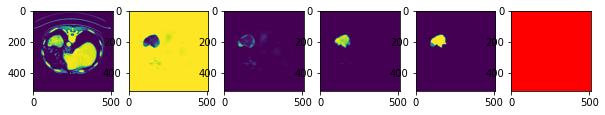

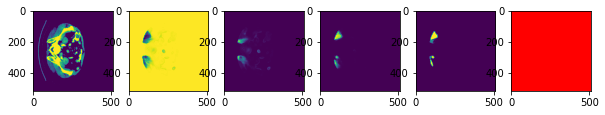

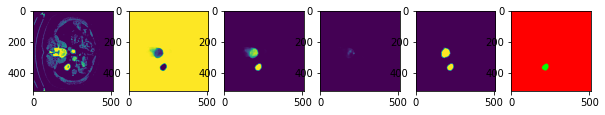

  0%|          | 0/320 [00:00<?, ?it/s]

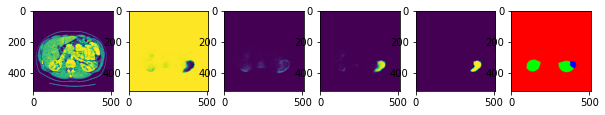

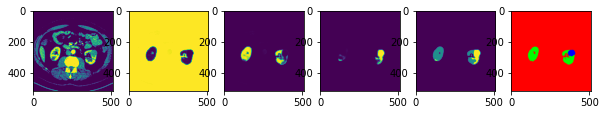

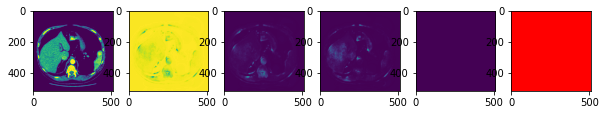

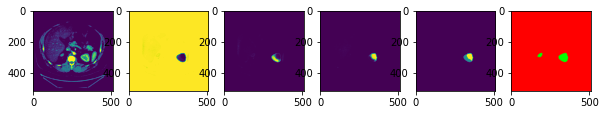

 16%|█▌        | 50/320 [00:19<01:28,  3.05it/s, loss=0.491, iou=0.526]

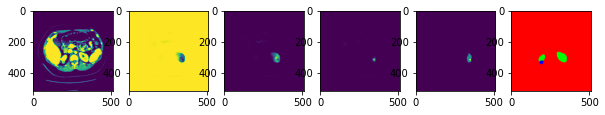

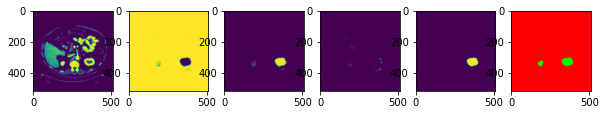

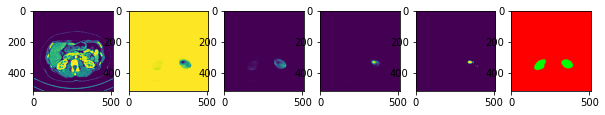

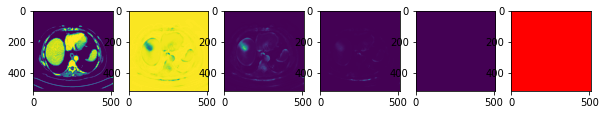

 31%|███▏      | 100/320 [00:38<01:12,  3.02it/s, loss=0.495, iou=0.511]

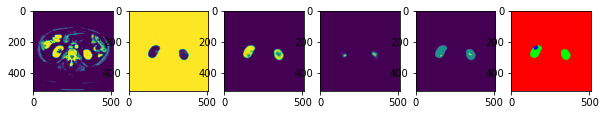

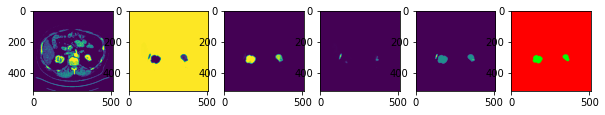

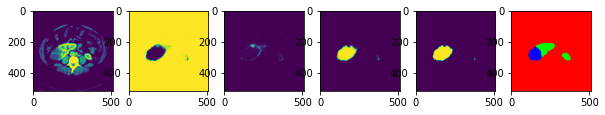

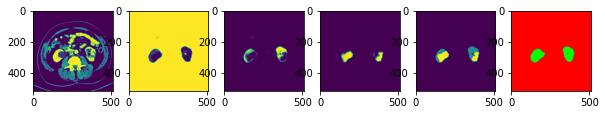

 47%|████▋     | 150/320 [00:57<00:56,  3.01it/s, loss=0.495, iou=0.536]

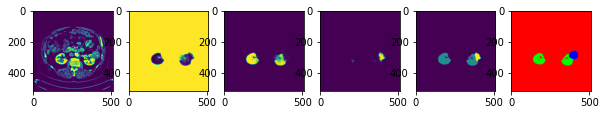

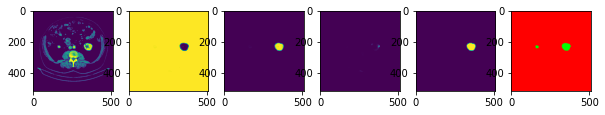

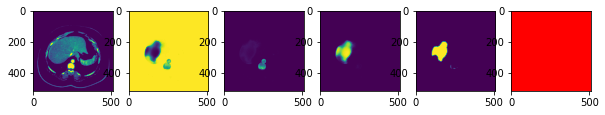

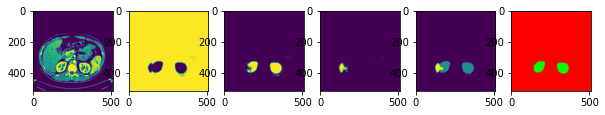

 62%|██████▎   | 200/320 [01:16<00:39,  3.02it/s, loss=0.493, iou=0.54]

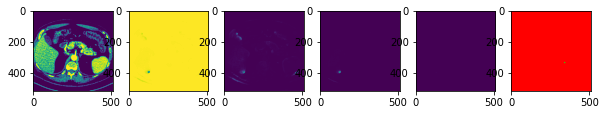

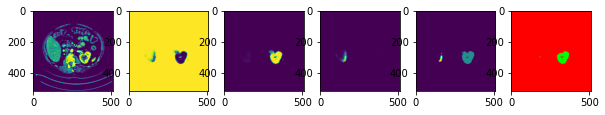

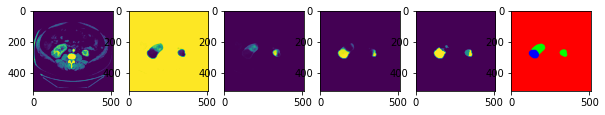

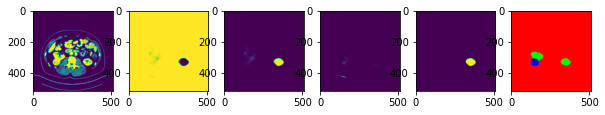

 78%|███████▊  | 250/320 [01:35<00:23,  3.02it/s, loss=0.495, iou=0.533]

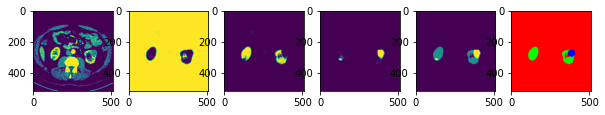

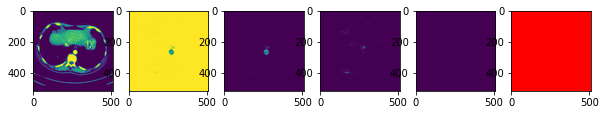

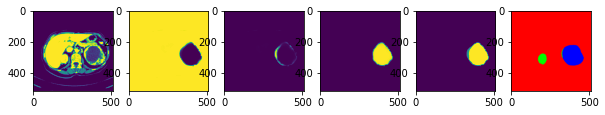

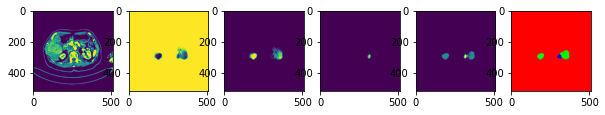

 94%|█████████▍| 300/320 [01:55<00:06,  3.02it/s, loss=0.493, iou=0.525]

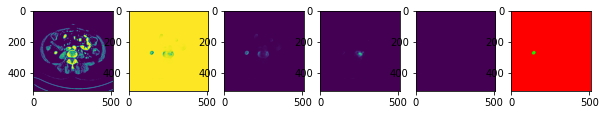

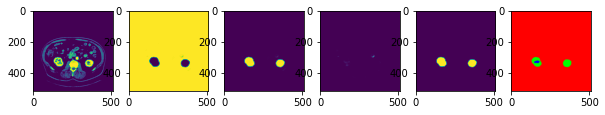

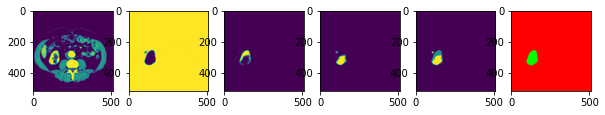

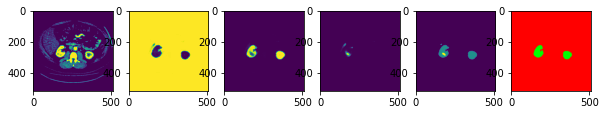

100%|██████████| 320/320 [02:04<00:00,  2.57it/s, loss=0.492, iou=0.523]


=>saving checkpoint...
=> SAVED BEST IOU
=>Training for epoch 4


  0%|          | 0/1280 [00:00<?, ?it/s]

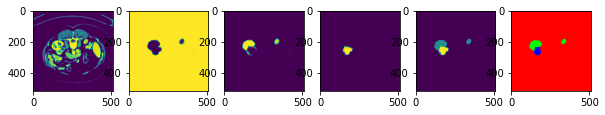

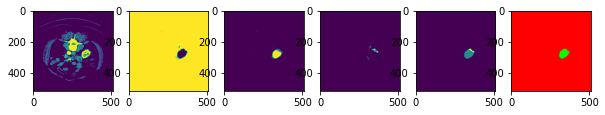

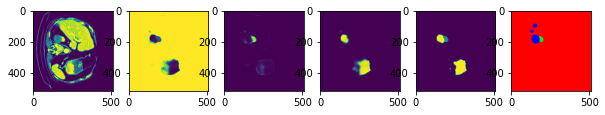

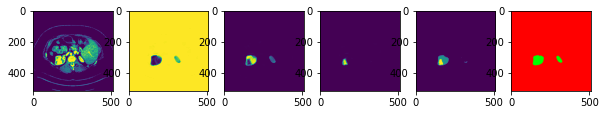

  4%|▍         | 50/1280 [00:55<21:57,  1.07s/it, loss=0.497, iou=0.495]

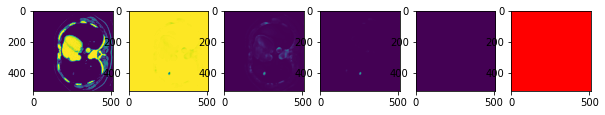

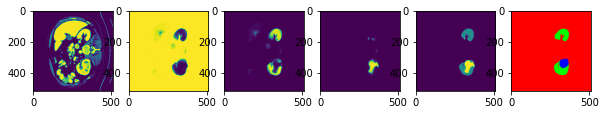

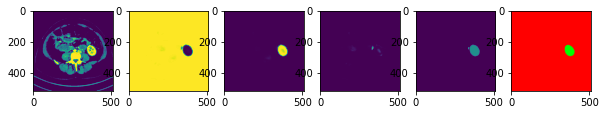

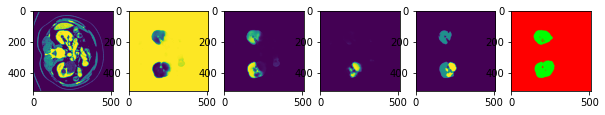

  8%|▊         | 100/1280 [01:52<21:22,  1.09s/it, loss=0.491, iou=0.49]

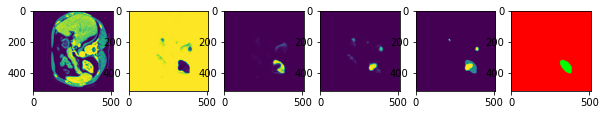

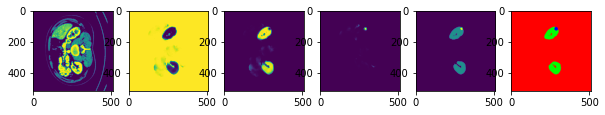

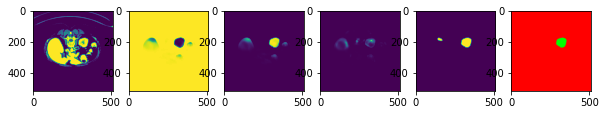

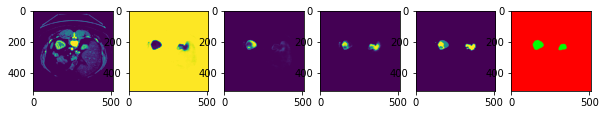

 12%|█▏        | 150/1280 [02:49<20:23,  1.08s/it, loss=0.491, iou=0.495]

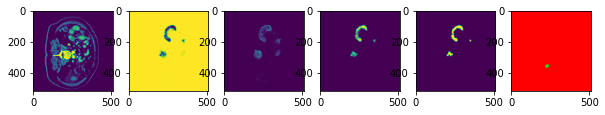

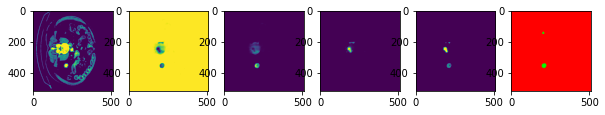

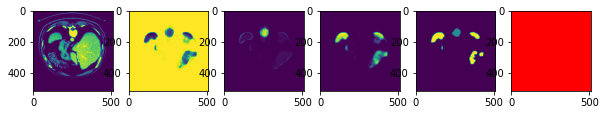

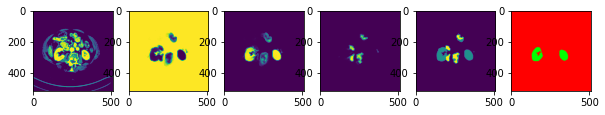

 16%|█▌        | 200/1280 [03:46<19:27,  1.08s/it, loss=0.493, iou=0.488]

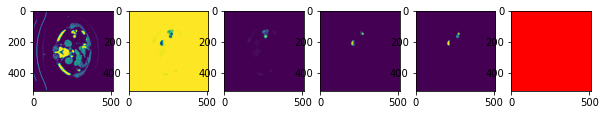

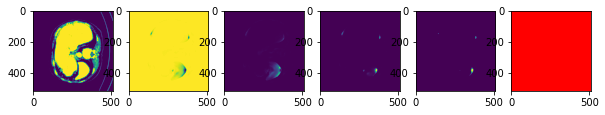

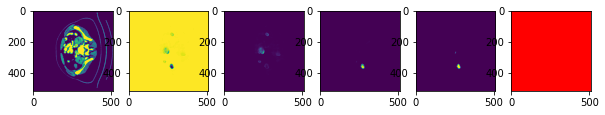

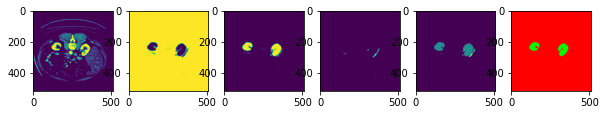

 20%|█▉        | 250/1280 [04:43<18:36,  1.08s/it, loss=0.491, iou=0.487]

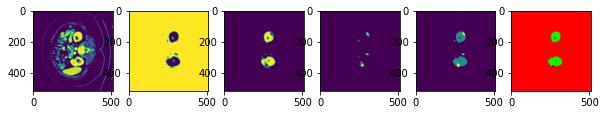

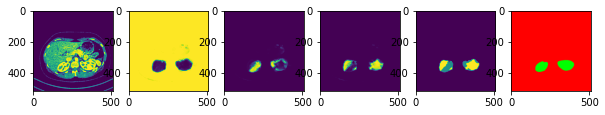

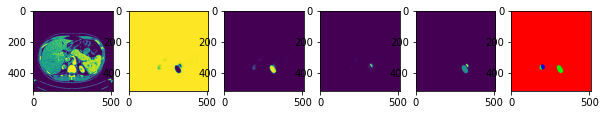

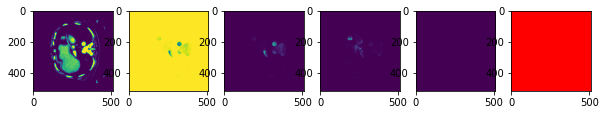

 23%|██▎       | 300/1280 [05:40<17:42,  1.08s/it, loss=0.491, iou=0.486]

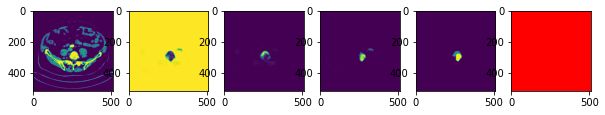

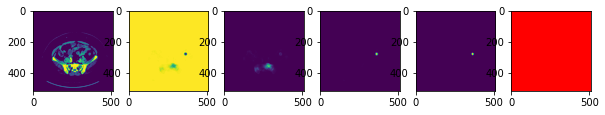

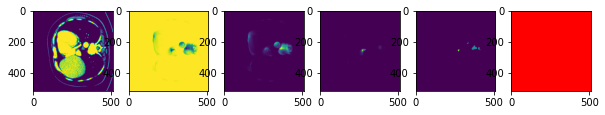

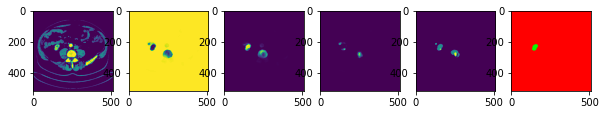

 27%|██▋       | 350/1280 [06:36<16:50,  1.09s/it, loss=0.491, iou=0.488]

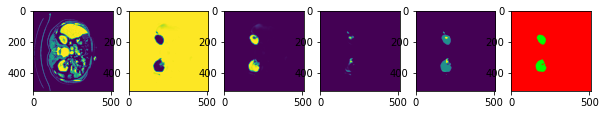

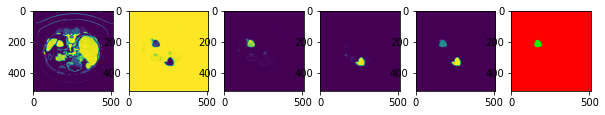

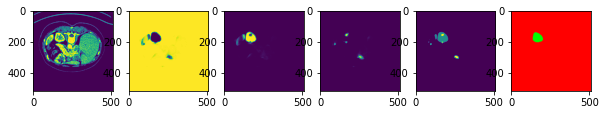

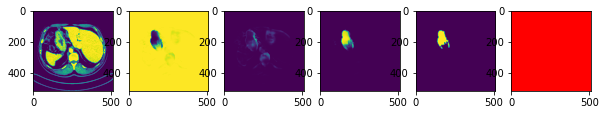

 31%|███▏      | 400/1280 [07:33<15:54,  1.08s/it, loss=0.492, iou=0.482]

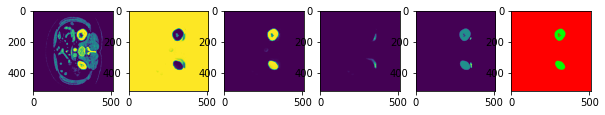

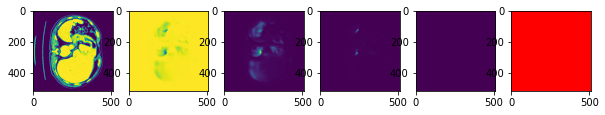

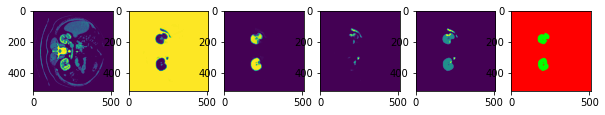

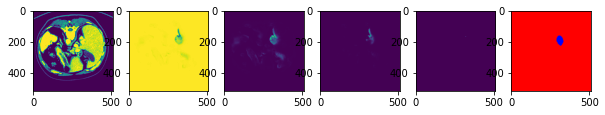

 35%|███▌      | 450/1280 [08:30<15:01,  1.09s/it, loss=0.493, iou=0.481]

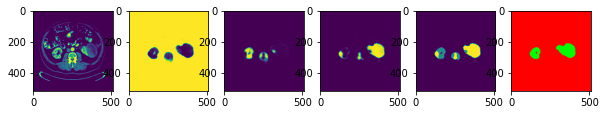

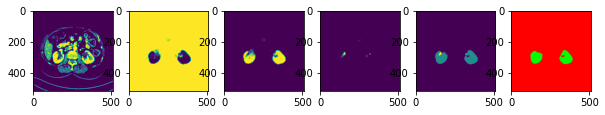

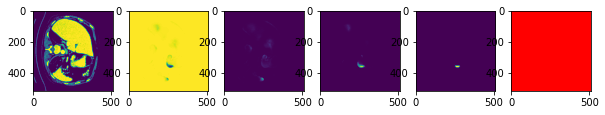

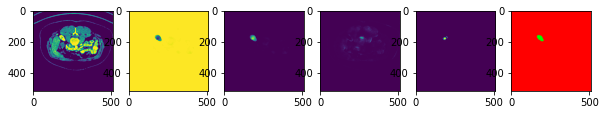

 39%|███▉      | 500/1280 [09:27<14:06,  1.09s/it, loss=0.493, iou=0.477]

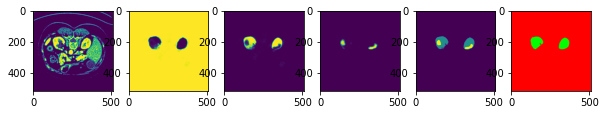

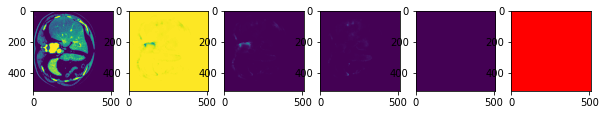

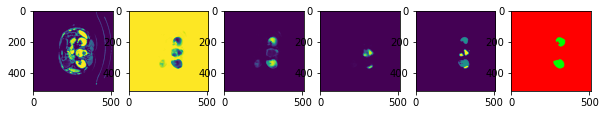

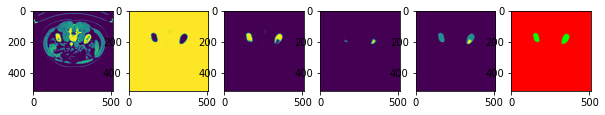

 43%|████▎     | 550/1280 [10:24<13:12,  1.09s/it, loss=0.492, iou=0.483]

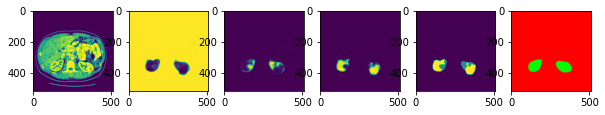

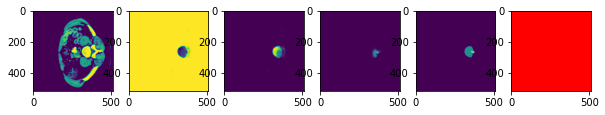

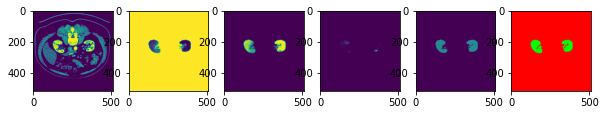

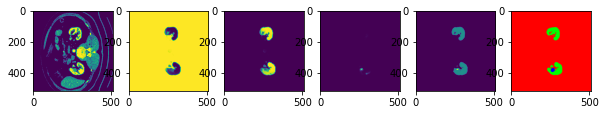

 47%|████▋     | 600/1280 [11:21<12:16,  1.08s/it, loss=0.493, iou=0.48]

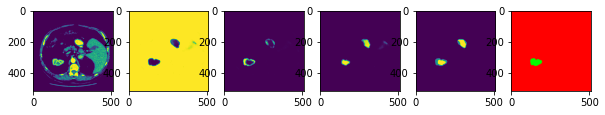

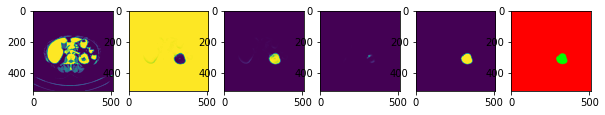

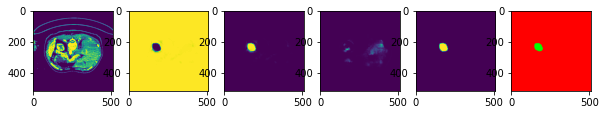

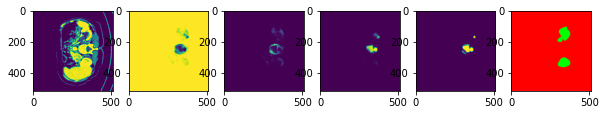

 51%|█████     | 650/1280 [12:17<11:21,  1.08s/it, loss=0.492, iou=0.479]

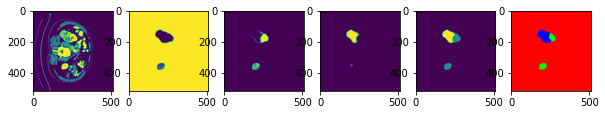

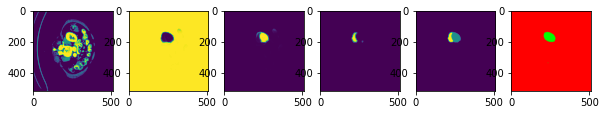

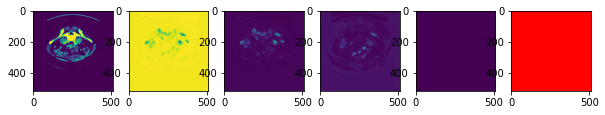

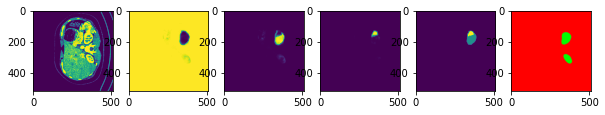

 55%|█████▍    | 700/1280 [13:14<10:27,  1.08s/it, loss=0.492, iou=0.48]

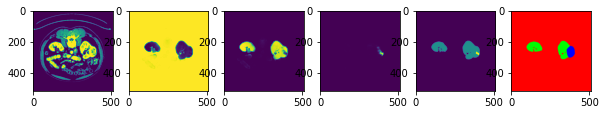

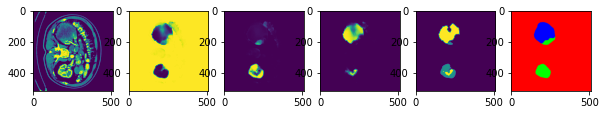

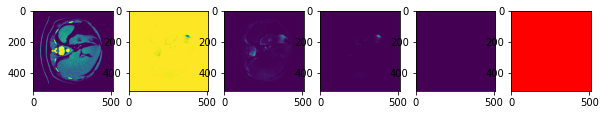

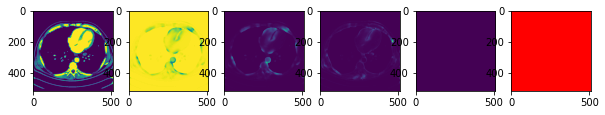

 59%|█████▊    | 750/1280 [14:11<09:33,  1.08s/it, loss=0.492, iou=0.479]

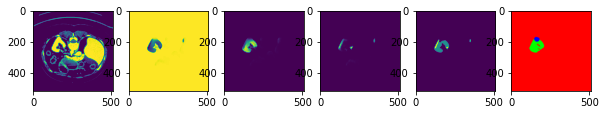

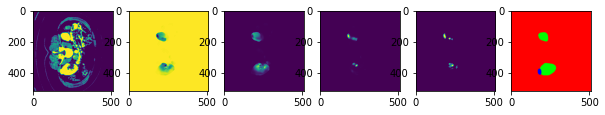

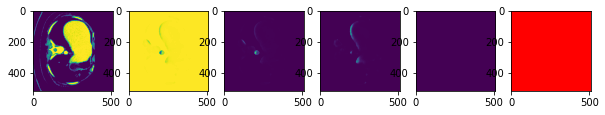

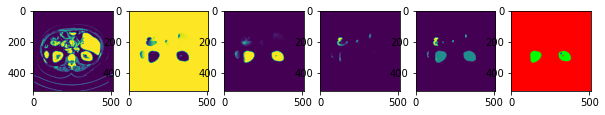

 62%|██████▎   | 800/1280 [15:08<08:41,  1.09s/it, loss=0.493, iou=0.485]

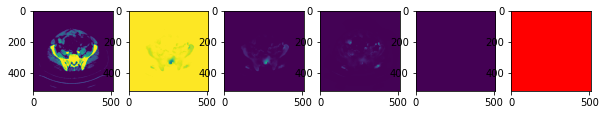

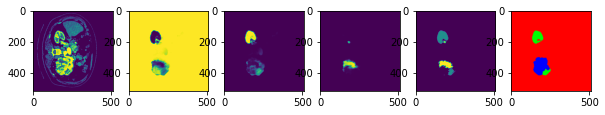

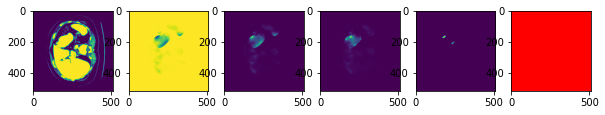

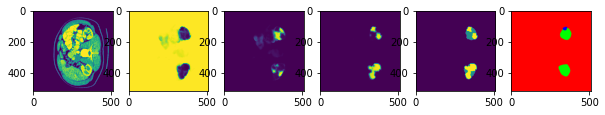

 66%|██████▋   | 850/1280 [16:04<07:46,  1.08s/it, loss=0.493, iou=0.488]

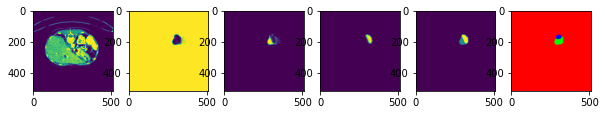

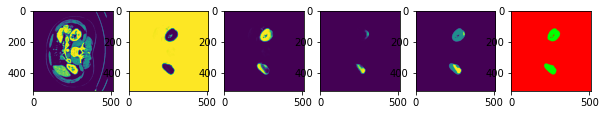

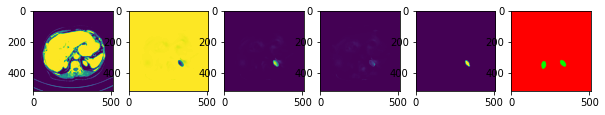

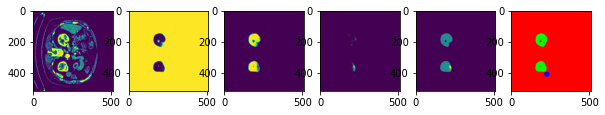

 70%|███████   | 900/1280 [17:01<06:52,  1.09s/it, loss=0.493, iou=0.488]

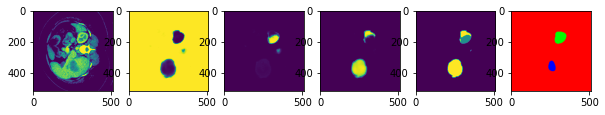

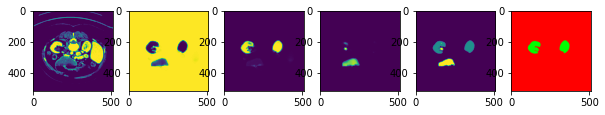

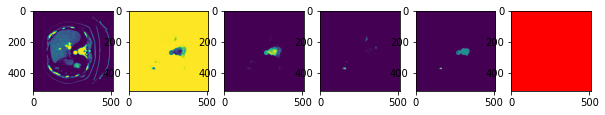

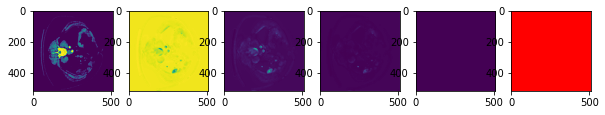

 74%|███████▍  | 950/1280 [17:58<05:58,  1.09s/it, loss=0.493, iou=0.491]

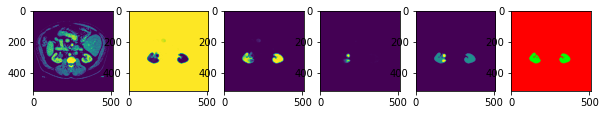

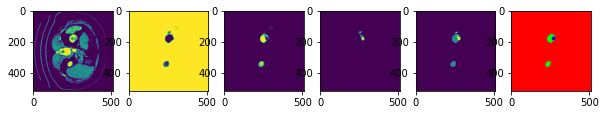

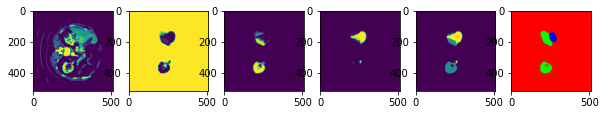

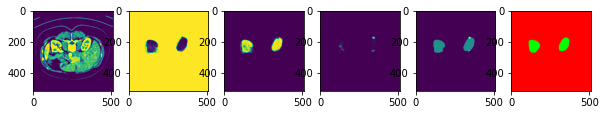

 78%|███████▊  | 1000/1280 [18:55<05:03,  1.08s/it, loss=0.493, iou=0.491]

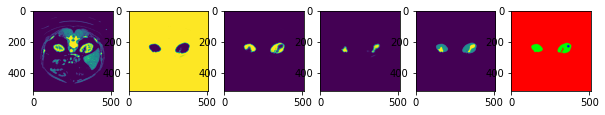

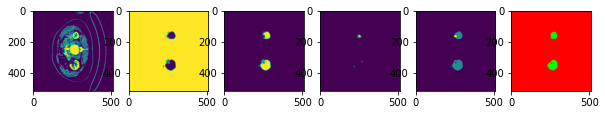

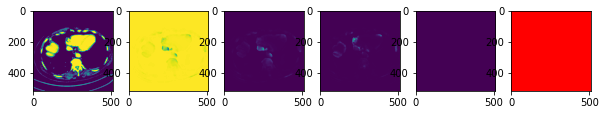

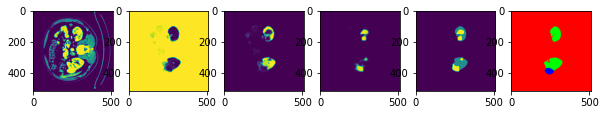

 82%|████████▏ | 1050/1280 [19:52<04:09,  1.09s/it, loss=0.493, iou=0.493]

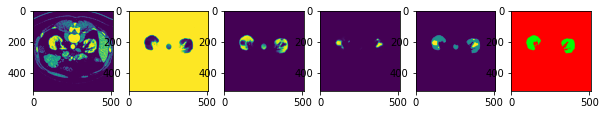

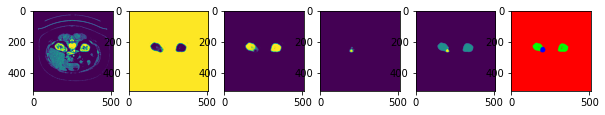

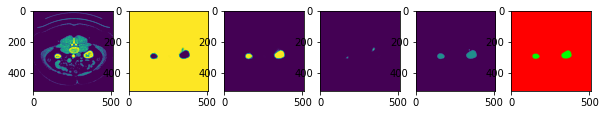

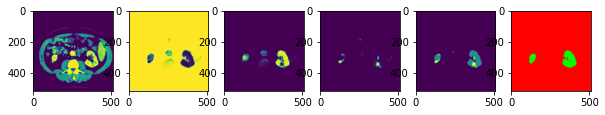

 86%|████████▌ | 1100/1280 [20:48<03:15,  1.08s/it, loss=0.493, iou=0.493]

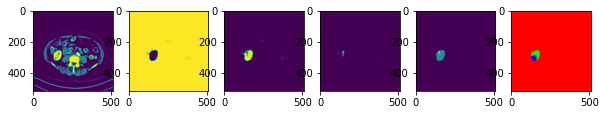

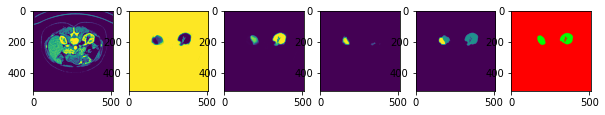

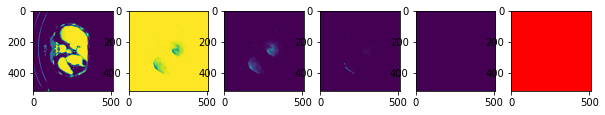

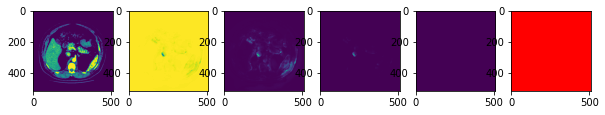

 90%|████████▉ | 1150/1280 [21:45<02:20,  1.08s/it, loss=0.492, iou=0.49]

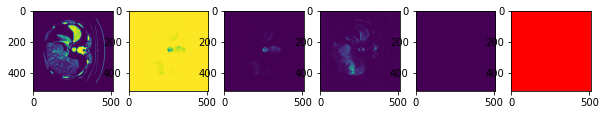

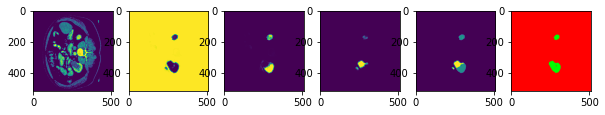

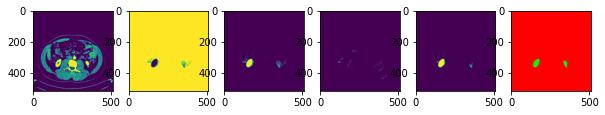

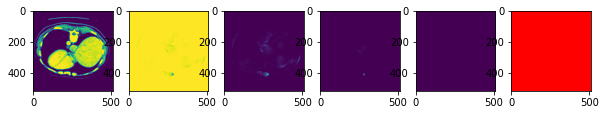

 94%|█████████▍| 1200/1280 [22:42<01:26,  1.09s/it, loss=0.493, iou=0.489]

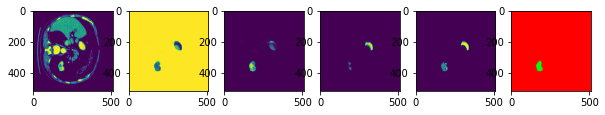

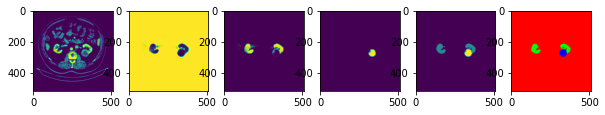

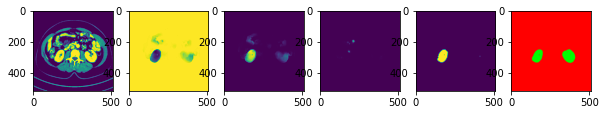

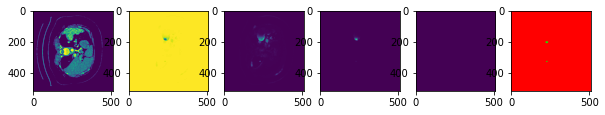

 98%|█████████▊| 1250/1280 [23:39<00:32,  1.08s/it, loss=0.493, iou=0.49]

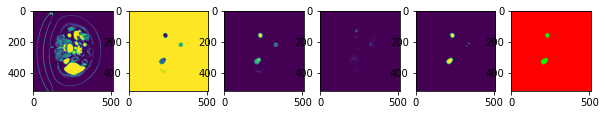

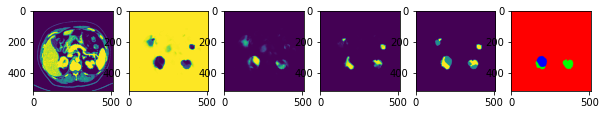

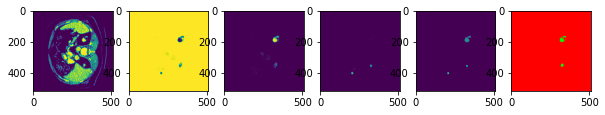

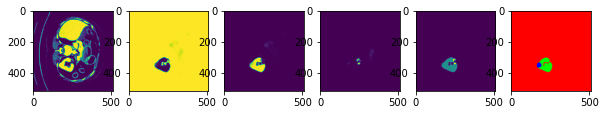

  0%|          | 0/320 [00:00<?, ?it/s]

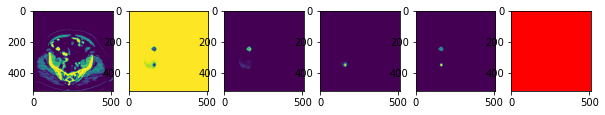

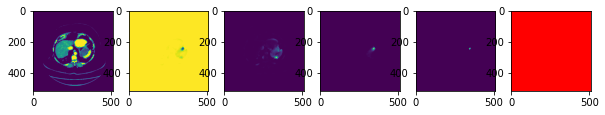

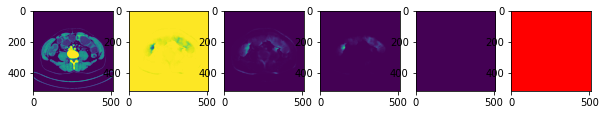

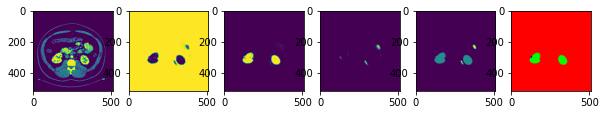

 16%|█▌        | 50/320 [00:19<01:28,  3.03it/s, loss=0.484, iou=0.524]

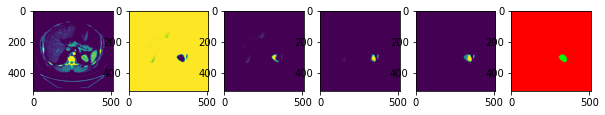

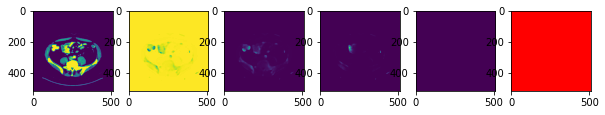

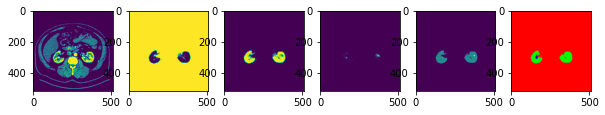

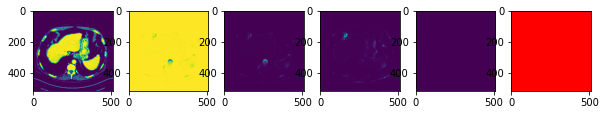

 31%|███▏      | 100/320 [00:38<01:12,  3.03it/s, loss=0.488, iou=0.548]

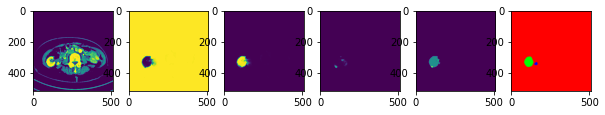

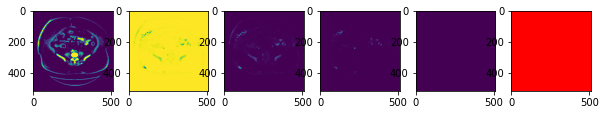

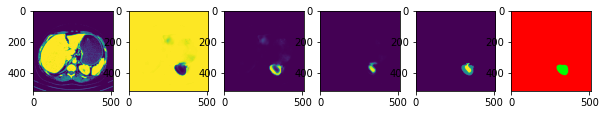

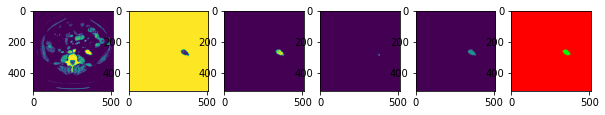

 47%|████▋     | 150/320 [00:57<00:55,  3.04it/s, loss=0.491, iou=0.55]

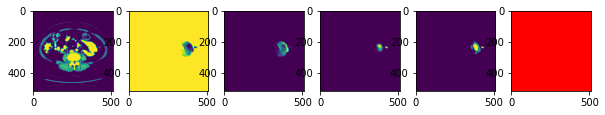

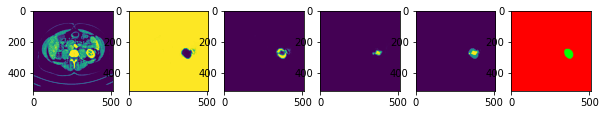

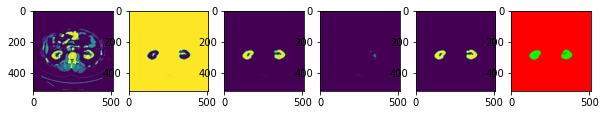

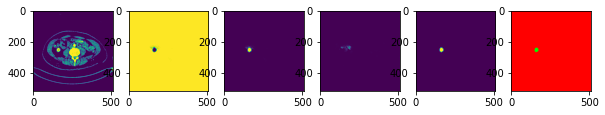

 62%|██████▎   | 200/320 [01:16<00:39,  3.04it/s, loss=0.491, iou=0.554]

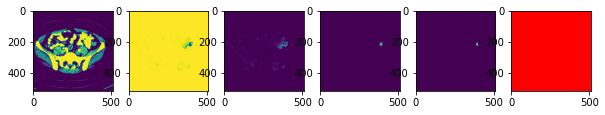

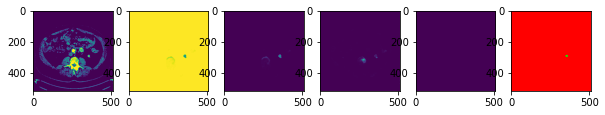

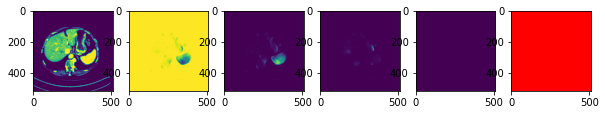

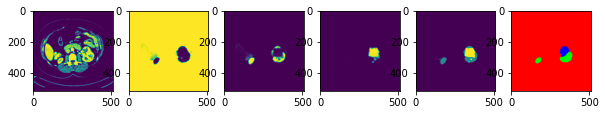

 78%|███████▊  | 250/320 [01:35<00:23,  3.03it/s, loss=0.489, iou=0.56]

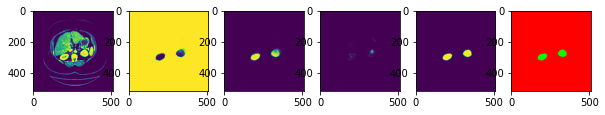

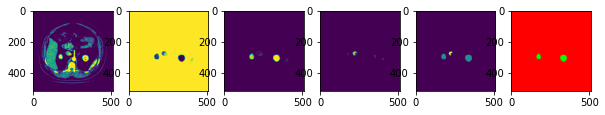

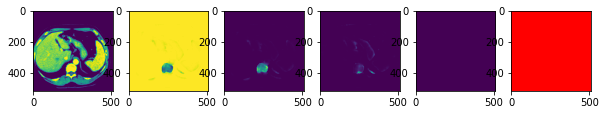

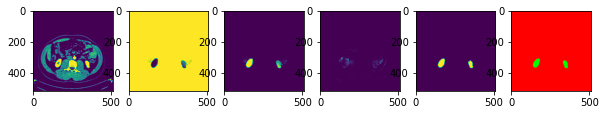

 94%|█████████▍| 300/320 [01:54<00:06,  3.05it/s, loss=0.489, iou=0.568]

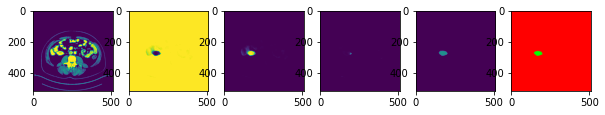

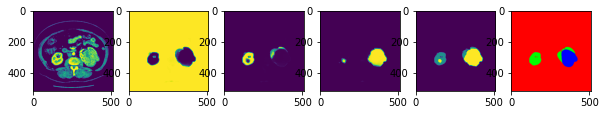

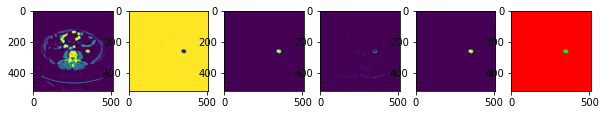

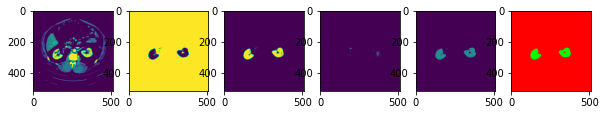

100%|██████████| 320/320 [02:04<00:00,  2.58it/s, loss=0.489, iou=0.572]


=>saving checkpoint...
=> SAVED BEST IOU
=>Training for epoch 5


  0%|          | 0/1280 [00:00<?, ?it/s]

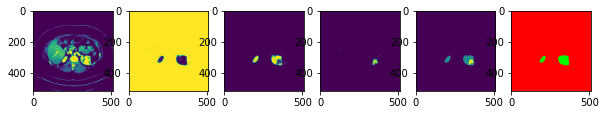

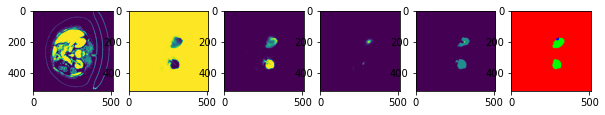

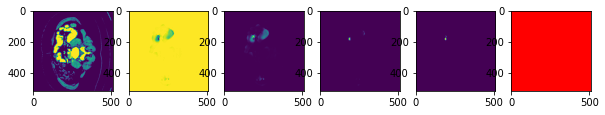

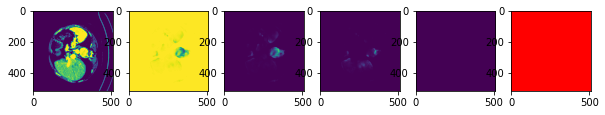

  4%|▍         | 50/1280 [00:56<21:57,  1.07s/it, loss=0.494, iou=0.558]

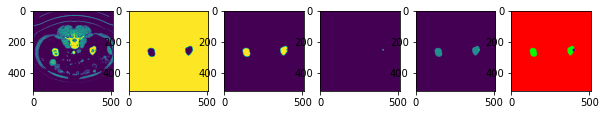

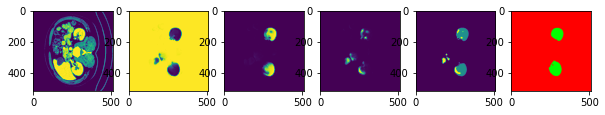

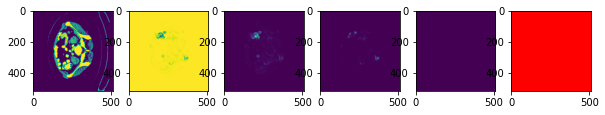

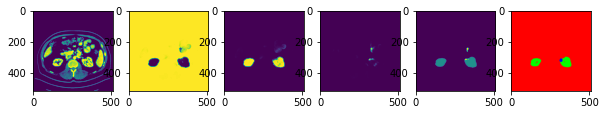

  8%|▊         | 100/1280 [01:52<21:23,  1.09s/it, loss=0.494, iou=0.519]

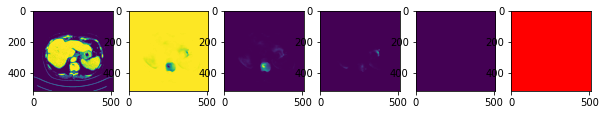

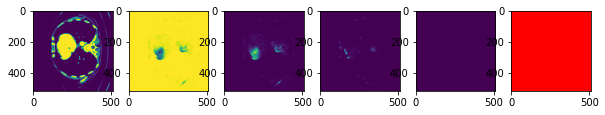

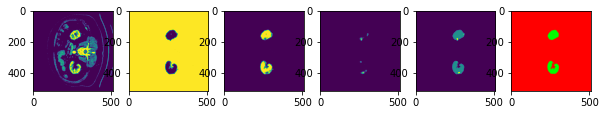

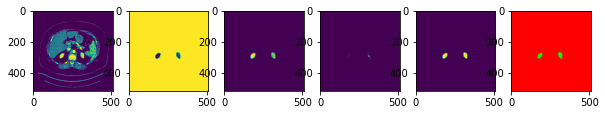

 12%|█▏        | 150/1280 [02:49<20:26,  1.09s/it, loss=0.494, iou=0.506]

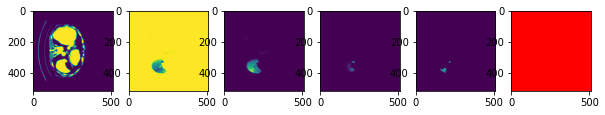

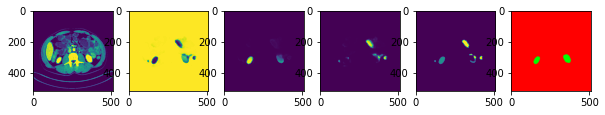

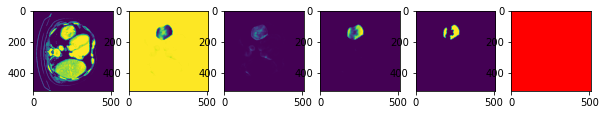

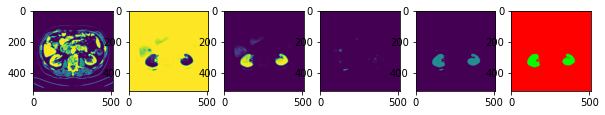

 16%|█▌        | 200/1280 [03:46<19:29,  1.08s/it, loss=0.492, iou=0.509]

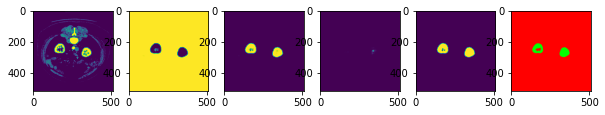

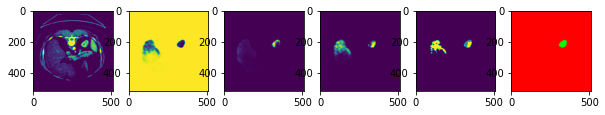

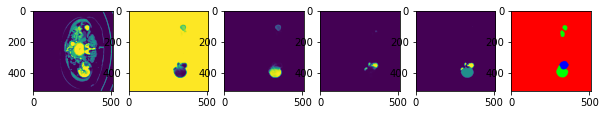

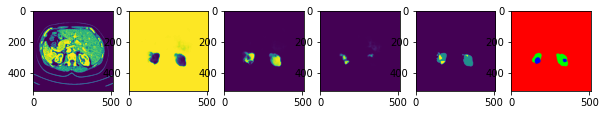

 20%|█▉        | 250/1280 [04:43<18:37,  1.09s/it, loss=0.493, iou=0.504]

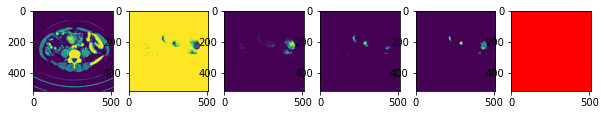

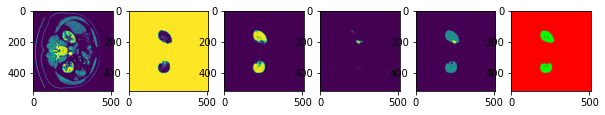

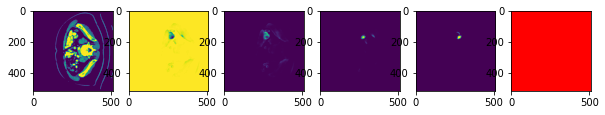

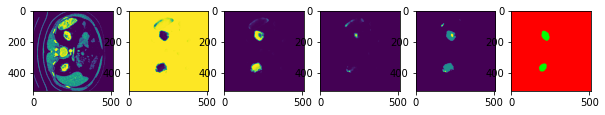

 23%|██▎       | 300/1280 [05:39<17:40,  1.08s/it, loss=0.491, iou=0.512]

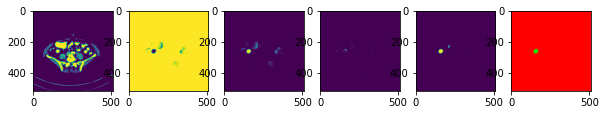

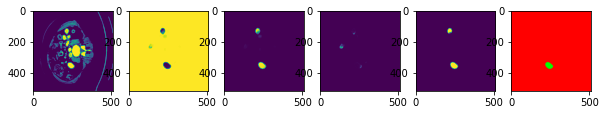

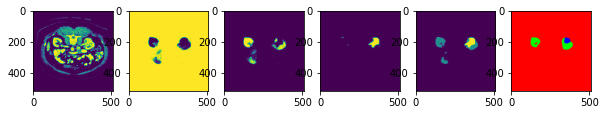

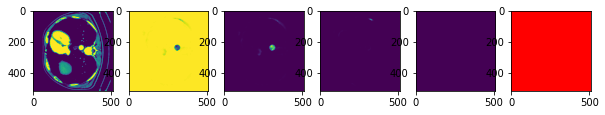

 27%|██▋       | 350/1280 [06:36<16:47,  1.08s/it, loss=0.491, iou=0.511]

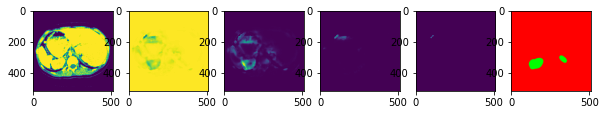

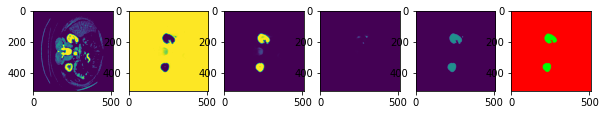

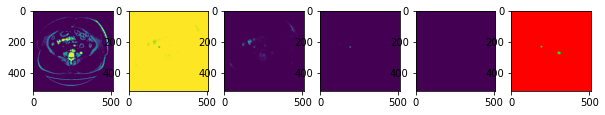

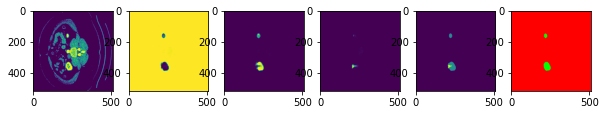

 31%|███▏      | 400/1280 [07:33<15:51,  1.08s/it, loss=0.49, iou=0.515]

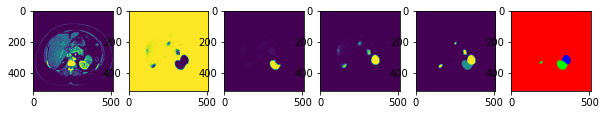

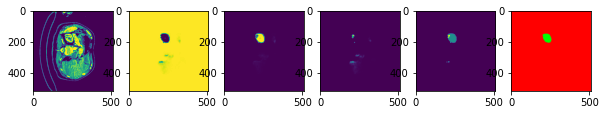

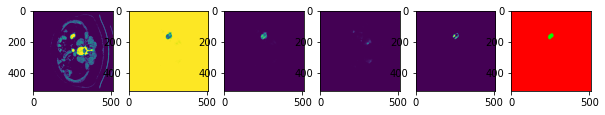

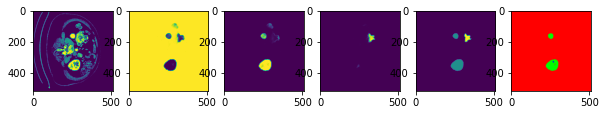

 35%|███▌      | 450/1280 [08:30<14:55,  1.08s/it, loss=0.49, iou=0.517]

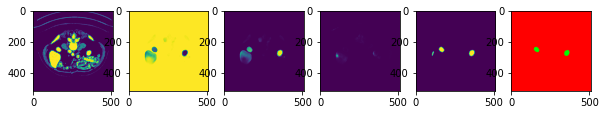

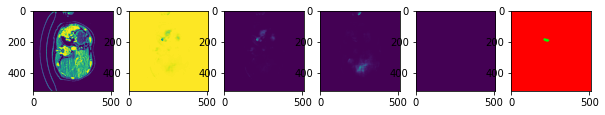

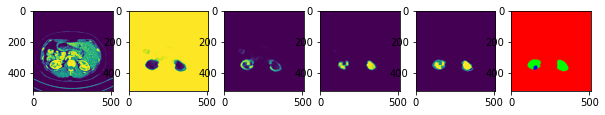

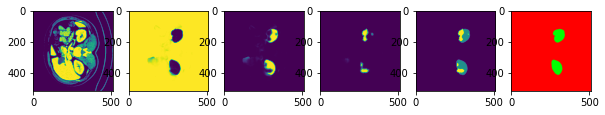

 39%|███▉      | 500/1280 [09:26<14:03,  1.08s/it, loss=0.49, iou=0.516]

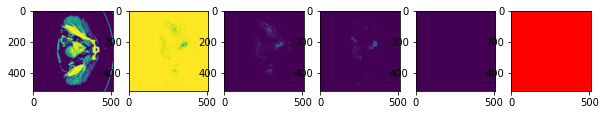

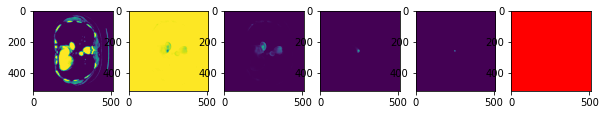

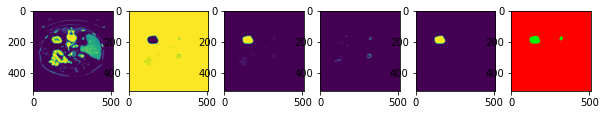

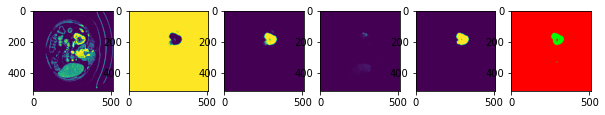

 43%|████▎     | 550/1280 [10:23<13:08,  1.08s/it, loss=0.491, iou=0.521]

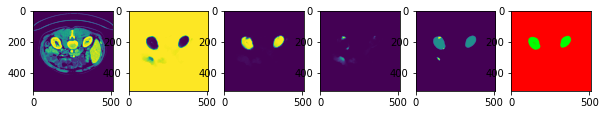

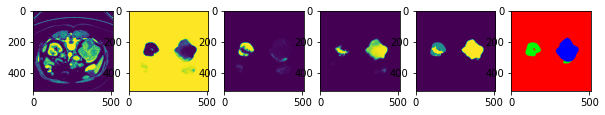

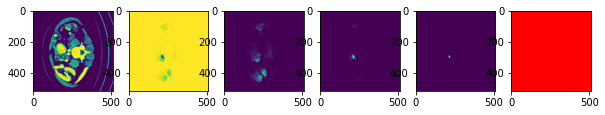

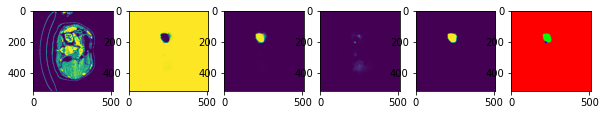

 47%|████▋     | 600/1280 [11:20<12:13,  1.08s/it, loss=0.491, iou=0.516]

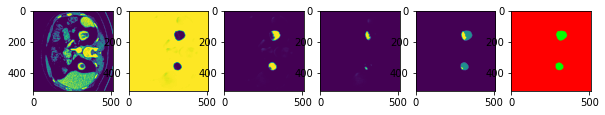

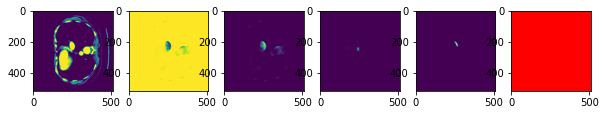

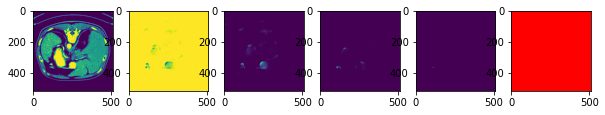

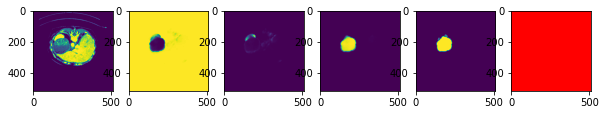

 51%|█████     | 650/1280 [12:17<11:21,  1.08s/it, loss=0.491, iou=0.512]

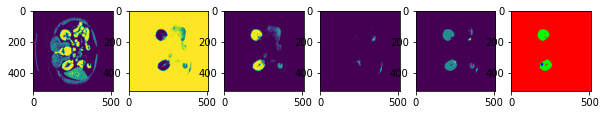

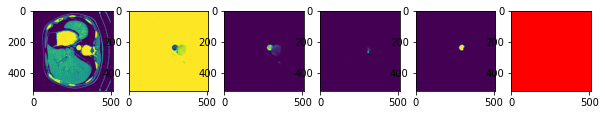

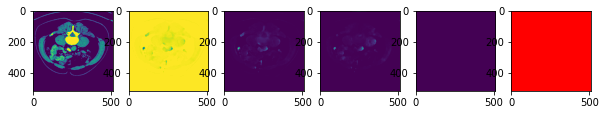

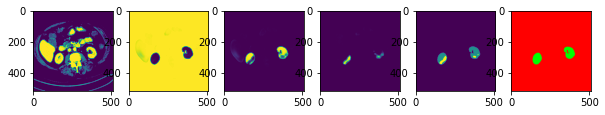

 55%|█████▍    | 700/1280 [13:14<10:26,  1.08s/it, loss=0.492, iou=0.513]

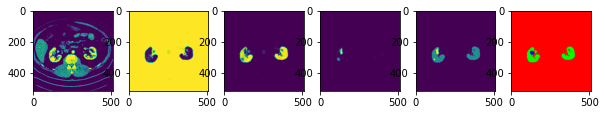

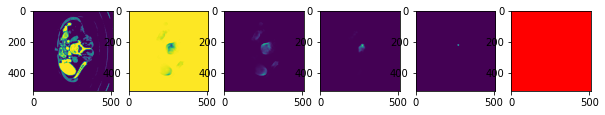

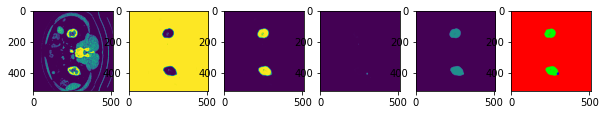

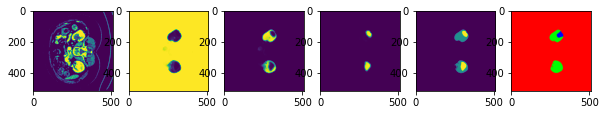

 59%|█████▊    | 750/1280 [14:10<09:31,  1.08s/it, loss=0.492, iou=0.515]

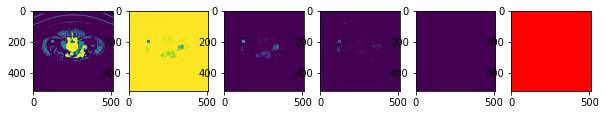

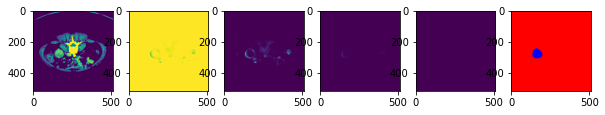

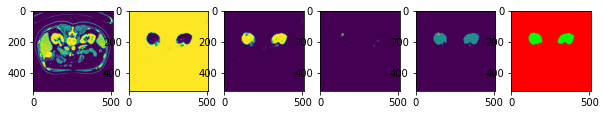

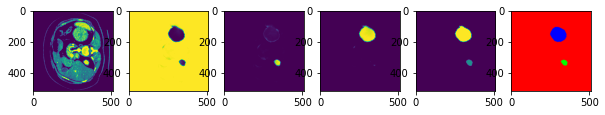

 62%|██████▎   | 800/1280 [15:07<08:39,  1.08s/it, loss=0.492, iou=0.514]

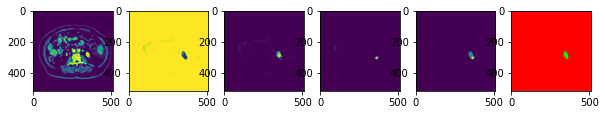

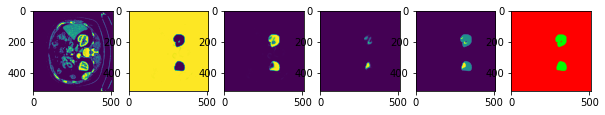

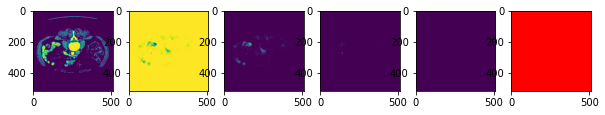

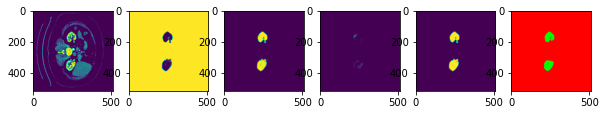

 66%|██████▋   | 850/1280 [16:04<07:44,  1.08s/it, loss=0.491, iou=0.516]

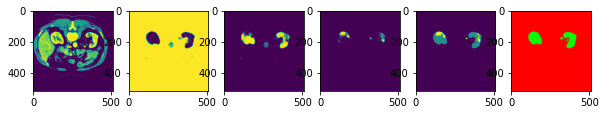

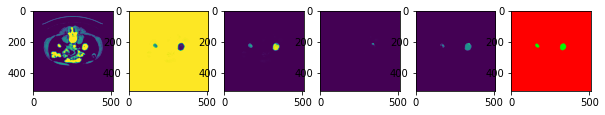

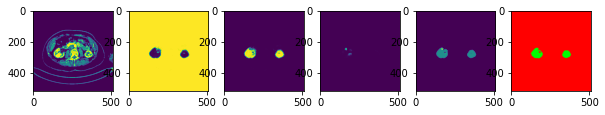

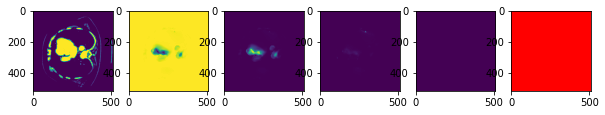

 70%|███████   | 900/1280 [17:00<06:51,  1.08s/it, loss=0.491, iou=0.518]

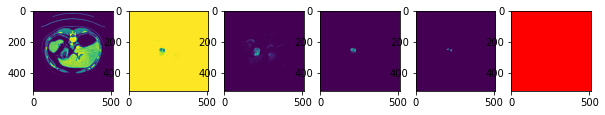

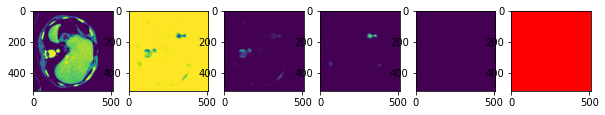

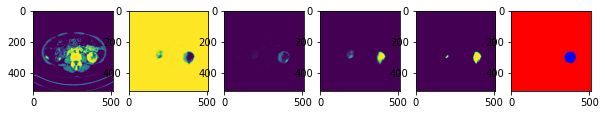

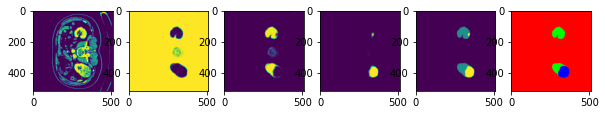

 74%|███████▍  | 950/1280 [17:57<05:55,  1.08s/it, loss=0.491, iou=0.522]

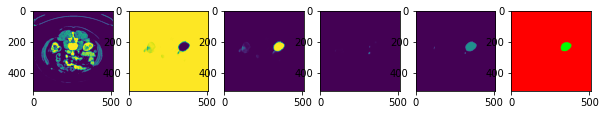

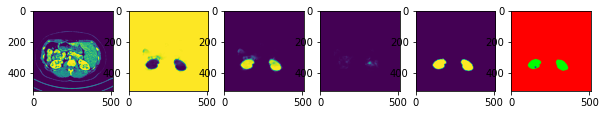

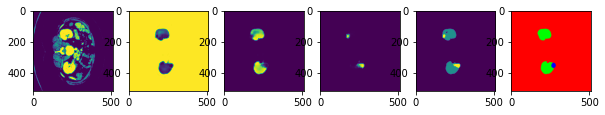

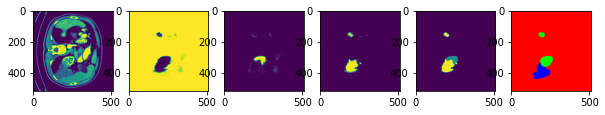

 78%|███████▊  | 1000/1280 [18:54<05:02,  1.08s/it, loss=0.491, iou=0.522]

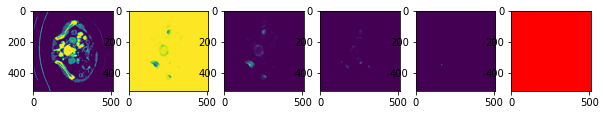

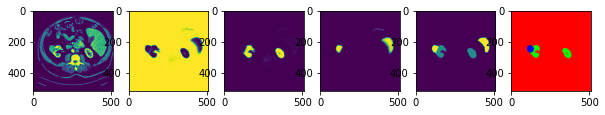

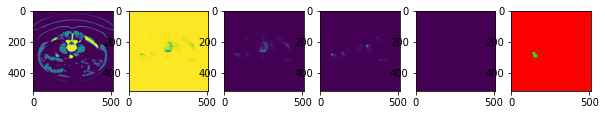

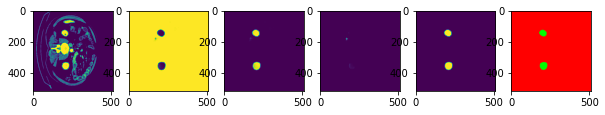

 82%|████████▏ | 1050/1280 [19:50<04:09,  1.08s/it, loss=0.49, iou=0.521]

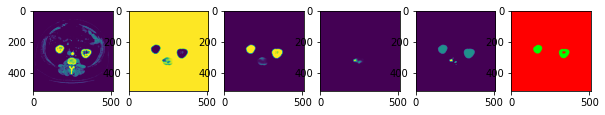

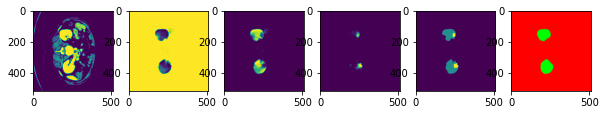

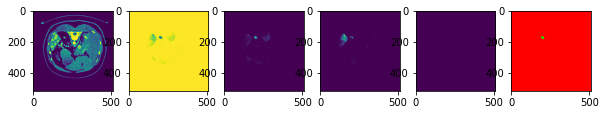

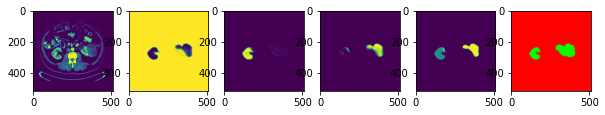

 86%|████████▌ | 1100/1280 [20:47<03:14,  1.08s/it, loss=0.49, iou=0.522]

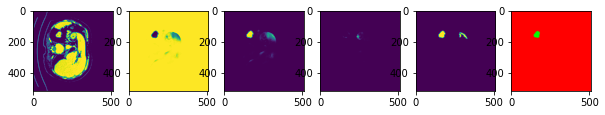

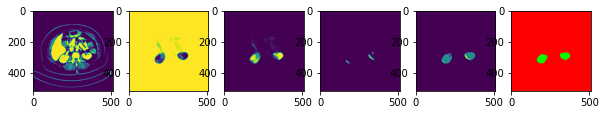

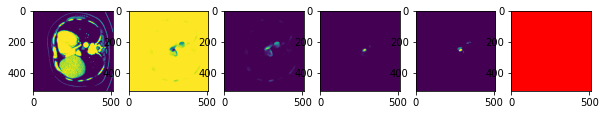

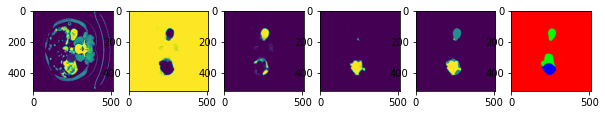

 90%|████████▉ | 1150/1280 [21:44<02:20,  1.08s/it, loss=0.49, iou=0.523]

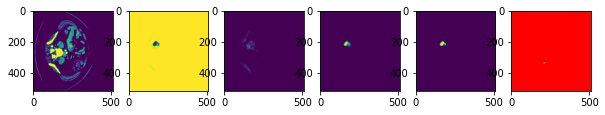

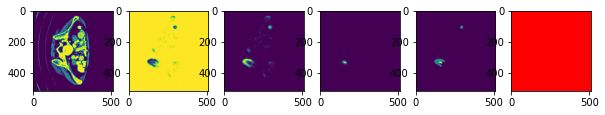

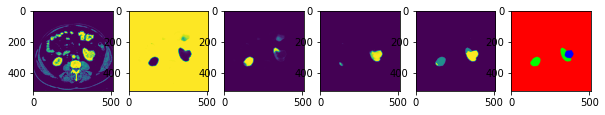

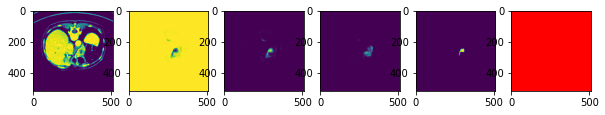

 94%|█████████▍| 1200/1280 [22:41<01:26,  1.08s/it, loss=0.49, iou=0.523]

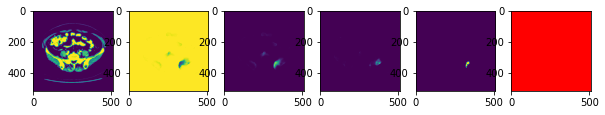

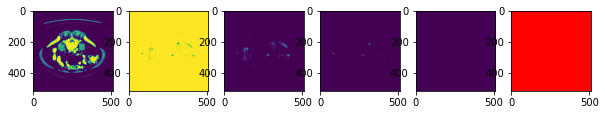

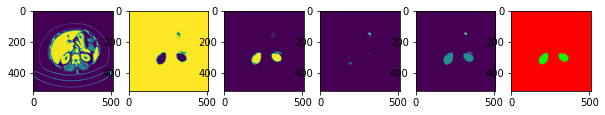

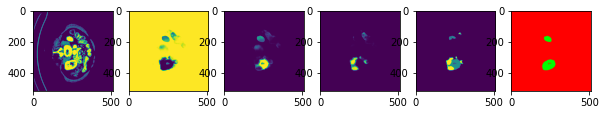

 98%|█████████▊| 1250/1280 [23:37<00:32,  1.08s/it, loss=0.49, iou=0.524]

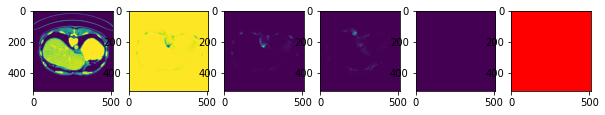

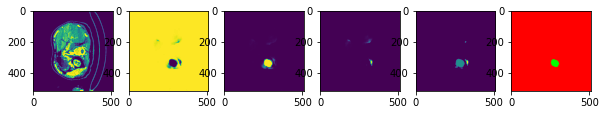

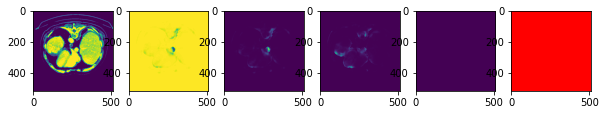

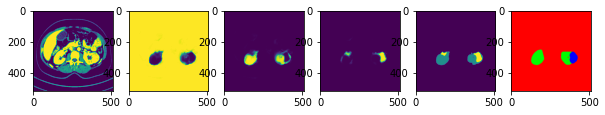

  0%|          | 0/320 [00:00<?, ?it/s]

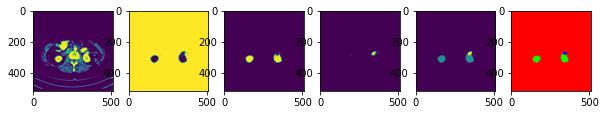

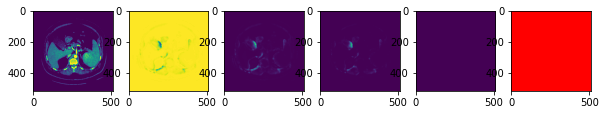

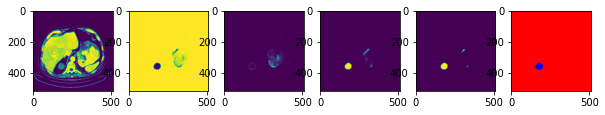

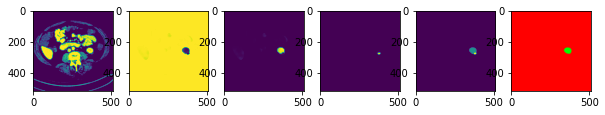

 16%|█▌        | 50/320 [00:19<01:28,  3.04it/s, loss=0.498, iou=0.686]

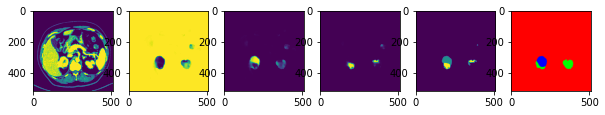

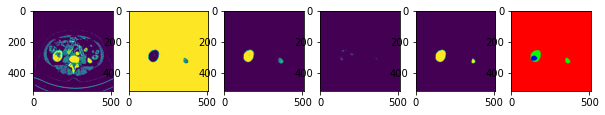

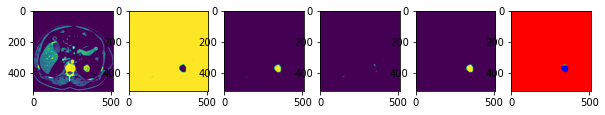

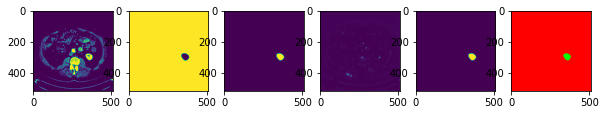

 31%|███▏      | 100/320 [00:38<01:12,  3.04it/s, loss=0.494, iou=0.66]

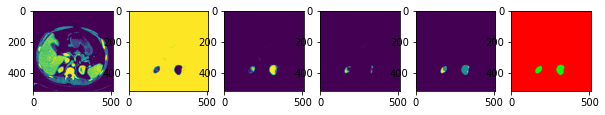

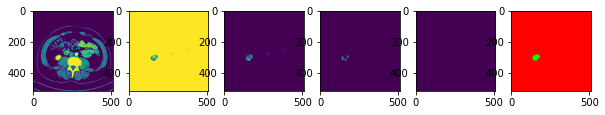

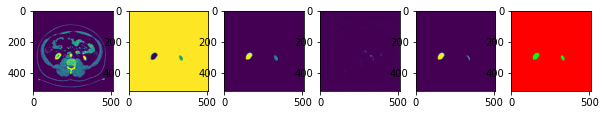

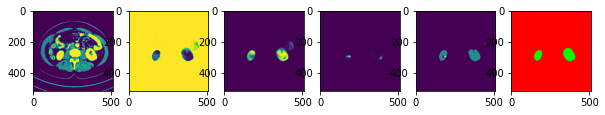

 47%|████▋     | 150/320 [00:57<00:56,  3.03it/s, loss=0.492, iou=0.663]

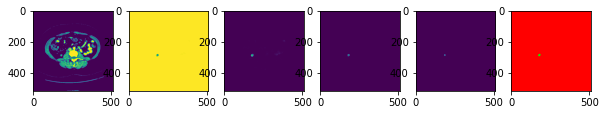

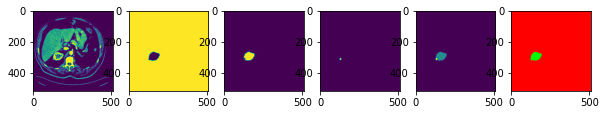

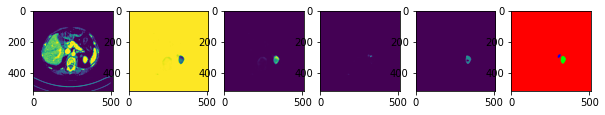

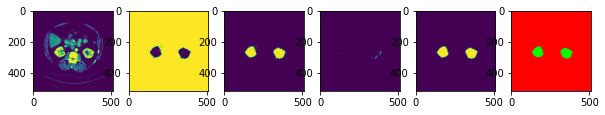

 62%|██████▎   | 200/320 [01:16<00:39,  3.04it/s, loss=0.493, iou=0.659]

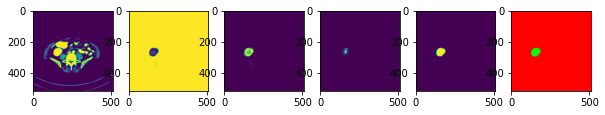

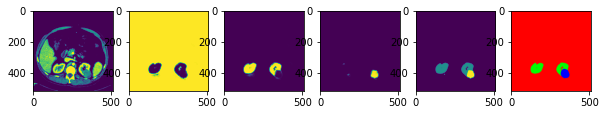

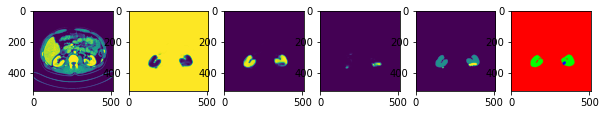

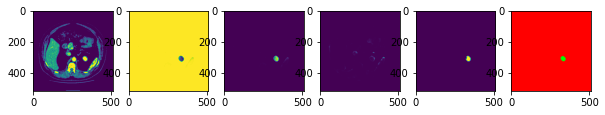

 78%|███████▊  | 250/320 [01:35<00:22,  3.04it/s, loss=0.491, iou=0.668]

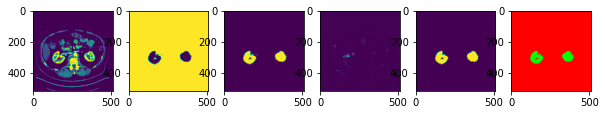

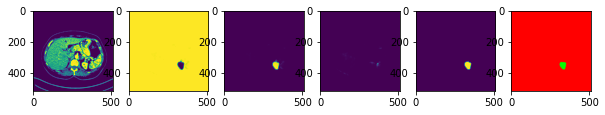

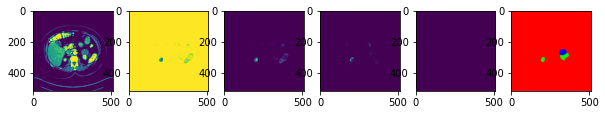

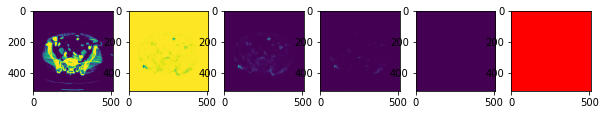

 94%|█████████▍| 300/320 [01:54<00:06,  3.04it/s, loss=0.49, iou=0.67]

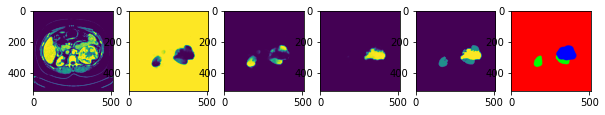

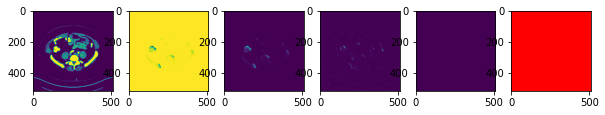

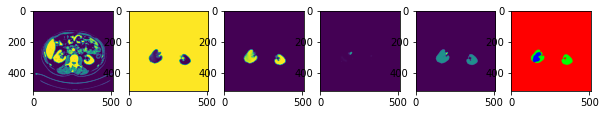

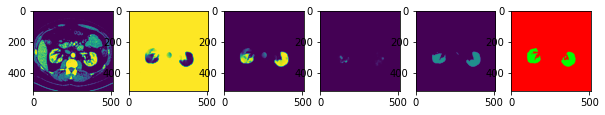

100%|██████████| 320/320 [02:04<00:00,  2.58it/s, loss=0.49, iou=0.67]


=>saving checkpoint...
=> SAVED BEST IOU
=>Training for epoch 6


  0%|          | 0/1280 [00:00<?, ?it/s]

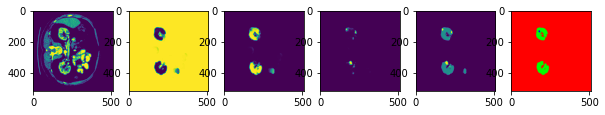

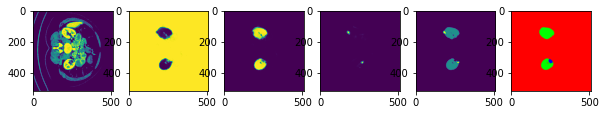

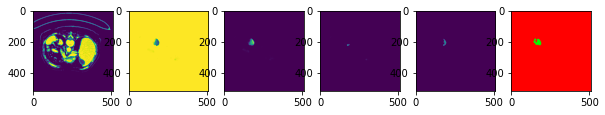

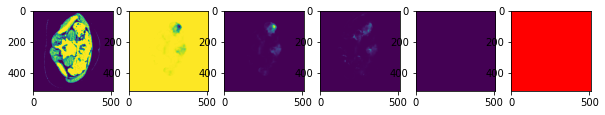

  4%|▍         | 50/1280 [00:55<21:57,  1.07s/it, loss=0.482, iou=0.593]

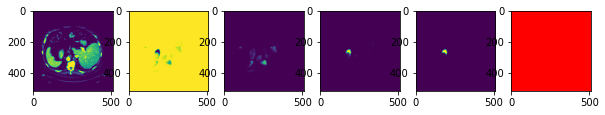

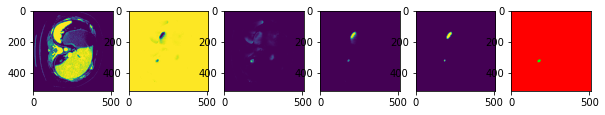

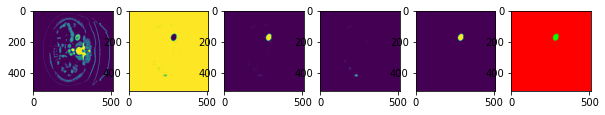

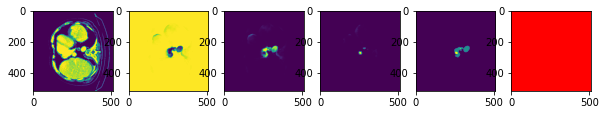

  8%|▊         | 100/1280 [01:52<21:18,  1.08s/it, loss=0.485, iou=0.573]

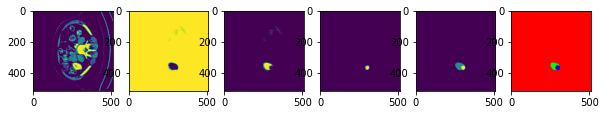

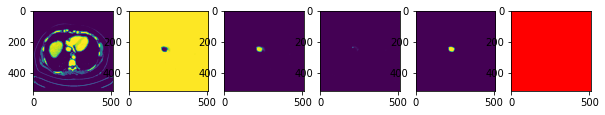

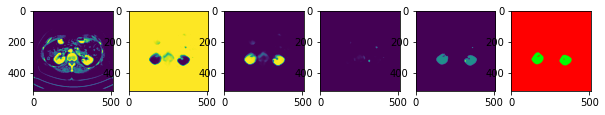

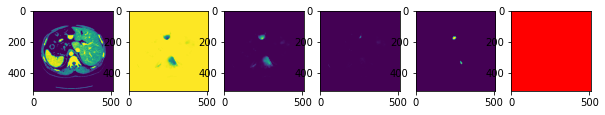

 12%|█▏        | 150/1280 [02:49<20:25,  1.08s/it, loss=0.484, iou=0.589]

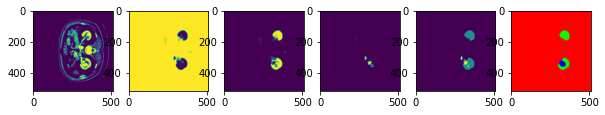

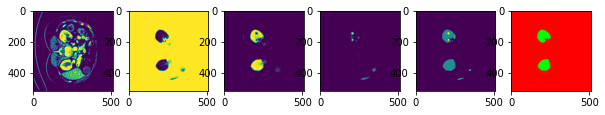

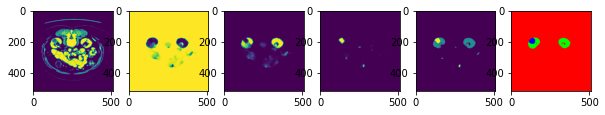

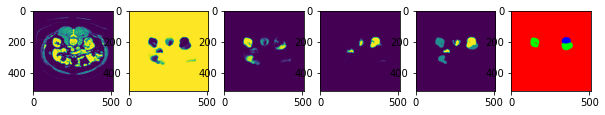

 16%|█▌        | 200/1280 [03:46<19:27,  1.08s/it, loss=0.486, iou=0.568]

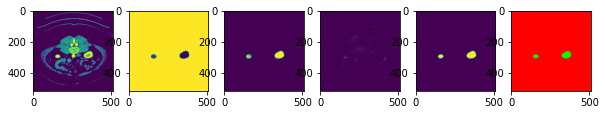

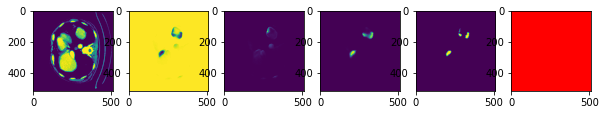

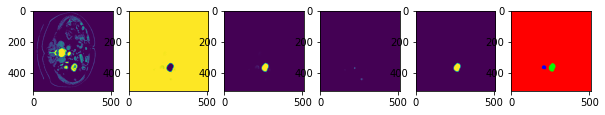

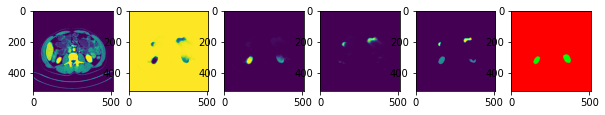

 20%|█▉        | 250/1280 [04:42<18:35,  1.08s/it, loss=0.486, iou=0.558]

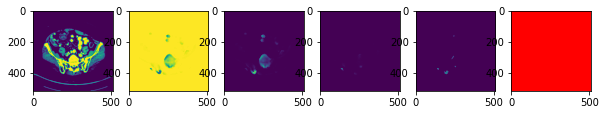

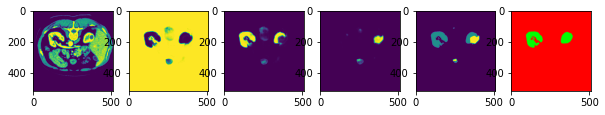

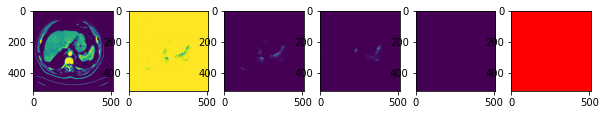

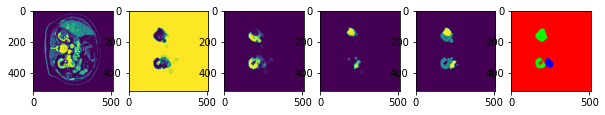

 23%|██▎       | 300/1280 [05:39<17:42,  1.08s/it, loss=0.484, iou=0.557]

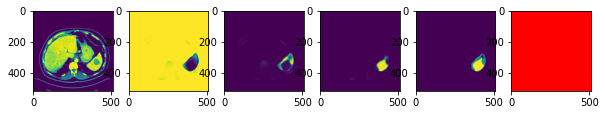

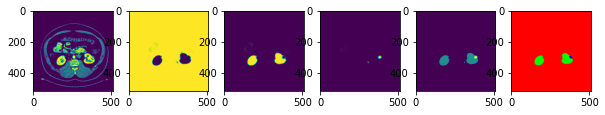

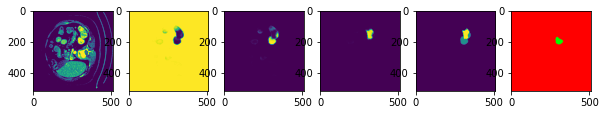

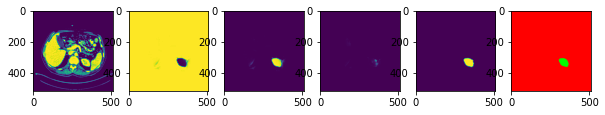

 27%|██▋       | 350/1280 [06:36<16:46,  1.08s/it, loss=0.484, iou=0.565]

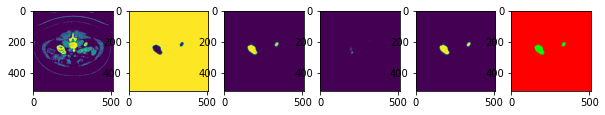

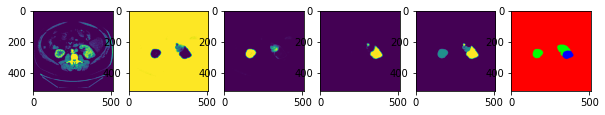

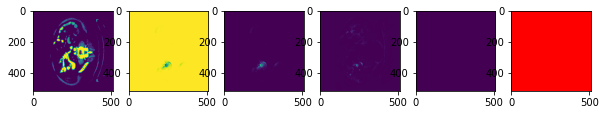

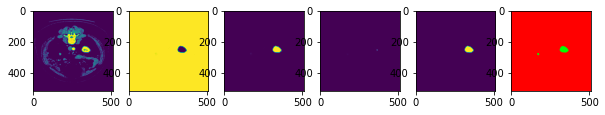

 31%|███▏      | 400/1280 [07:33<15:52,  1.08s/it, loss=0.485, iou=0.57]

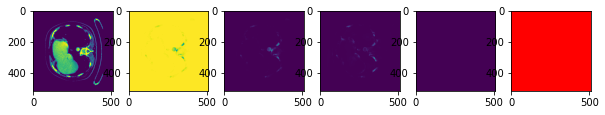

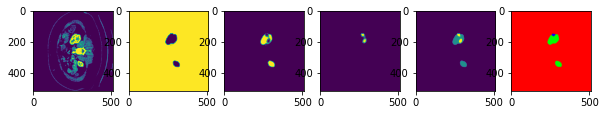

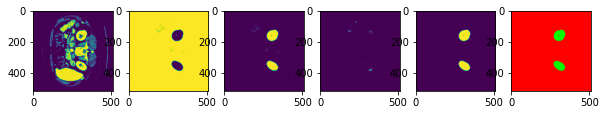

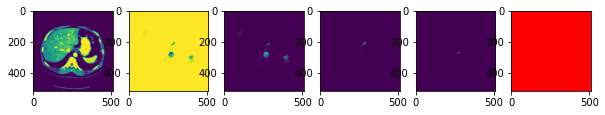

 35%|███▌      | 450/1280 [08:30<14:59,  1.08s/it, loss=0.484, iou=0.573]

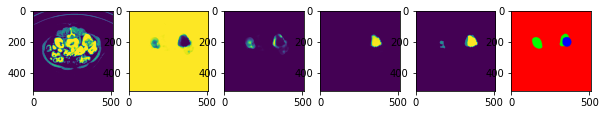

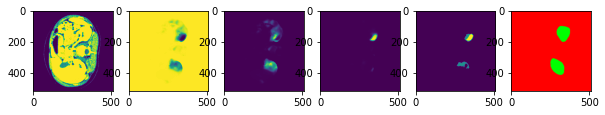

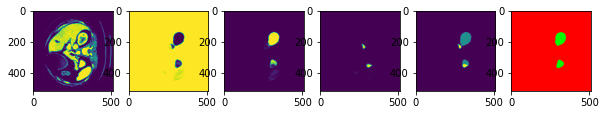

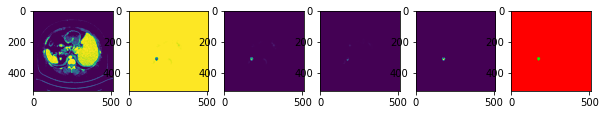

 39%|███▉      | 500/1280 [09:26<14:03,  1.08s/it, loss=0.485, iou=0.563]

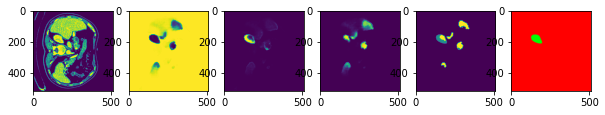

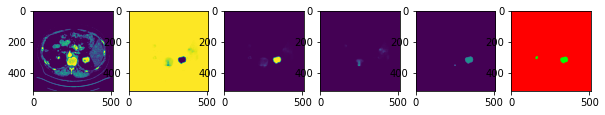

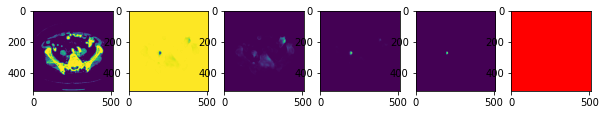

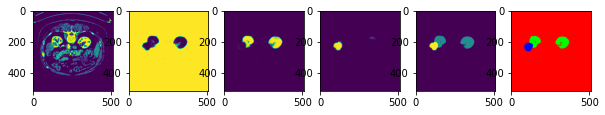

 43%|████▎     | 550/1280 [10:23<13:12,  1.09s/it, loss=0.484, iou=0.558]

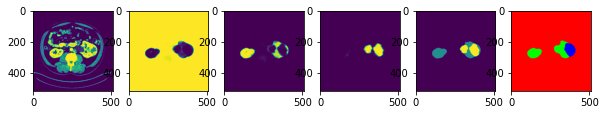

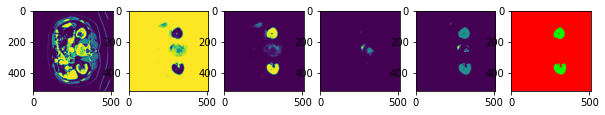

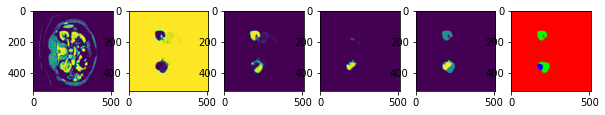

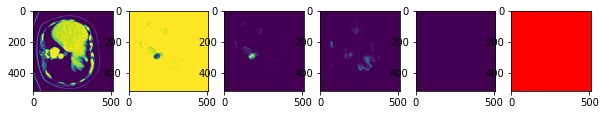

 47%|████▋     | 600/1280 [11:20<12:15,  1.08s/it, loss=0.484, iou=0.551]

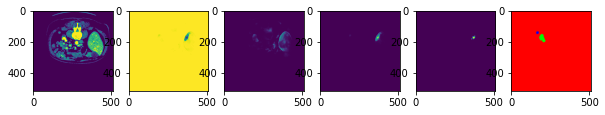

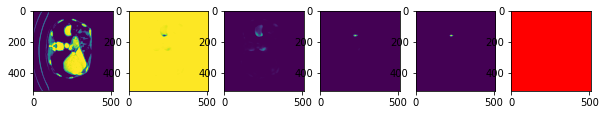

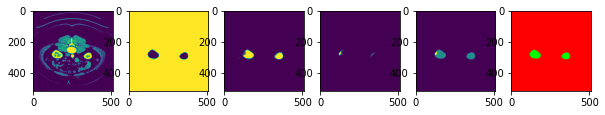

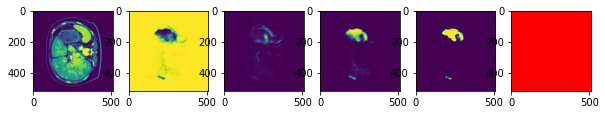

 51%|█████     | 650/1280 [12:17<11:21,  1.08s/it, loss=0.484, iou=0.55]

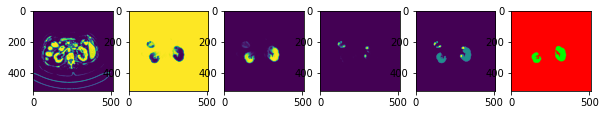

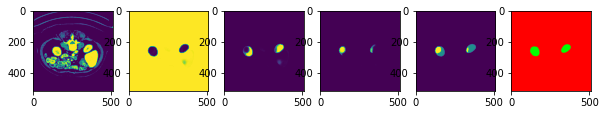

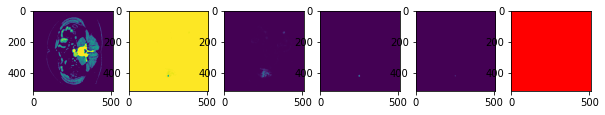

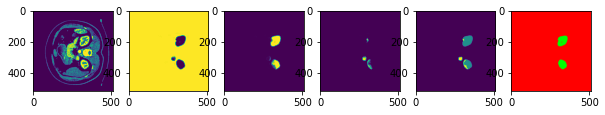

 55%|█████▍    | 700/1280 [13:13<10:30,  1.09s/it, loss=0.485, iou=0.548]

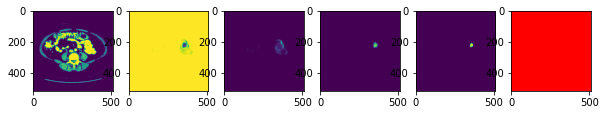

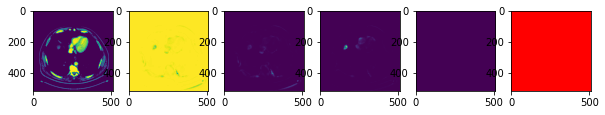

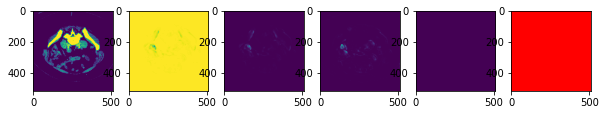

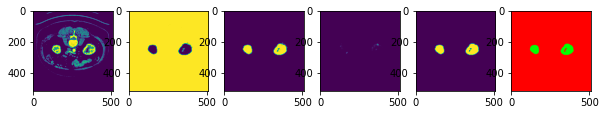

 59%|█████▊    | 750/1280 [14:10<09:35,  1.09s/it, loss=0.485, iou=0.548]

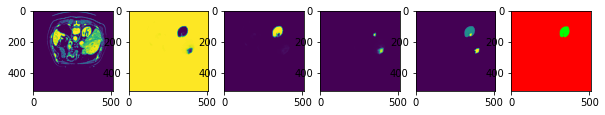

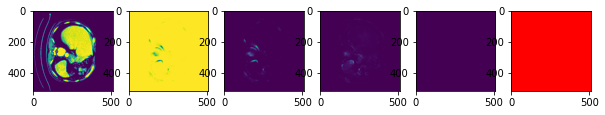

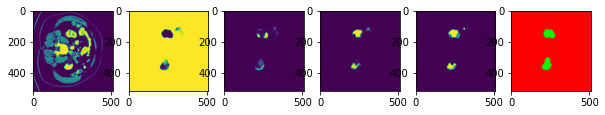

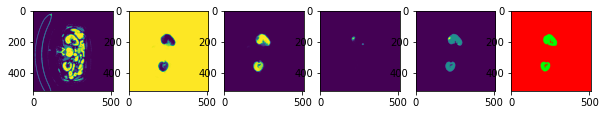

 62%|██████▎   | 800/1280 [15:07<08:40,  1.08s/it, loss=0.485, iou=0.545]

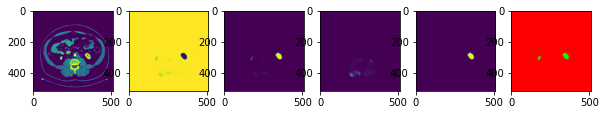

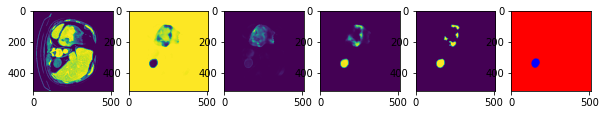

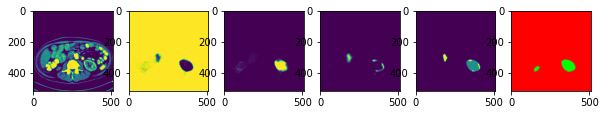

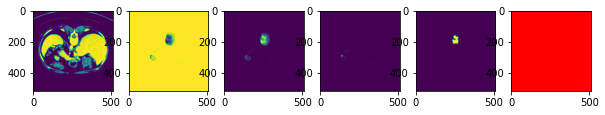

 66%|██████▋   | 850/1280 [16:04<07:44,  1.08s/it, loss=0.485, iou=0.547]

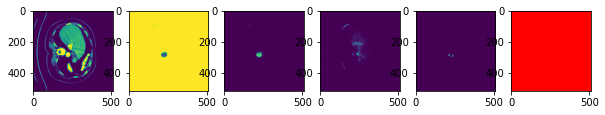

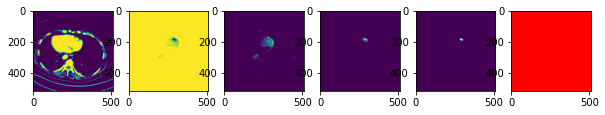

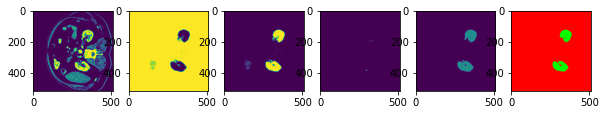

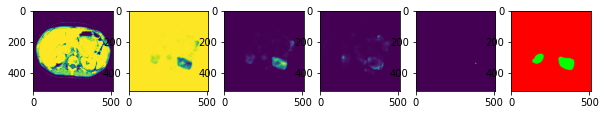

 70%|███████   | 900/1280 [17:00<06:51,  1.08s/it, loss=0.486, iou=0.548]

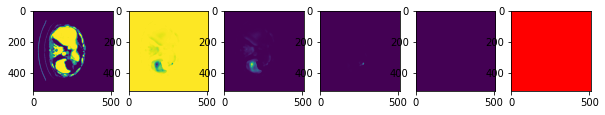

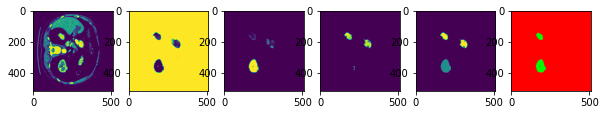

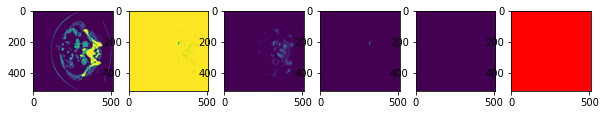

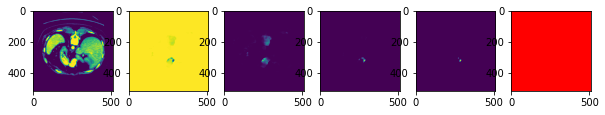

 74%|███████▍  | 947/1280 [17:55<06:18,  1.14s/it, loss=0.485, iou=0.551]


KeyboardInterrupt: ignored

In [24]:
import os
from collections import OrderedDict
from glob import glob

import pandas as pd
import torch
import torch.backends.cudnn as cudnn
import torch.nn as nn
import torch.optim as optim
from albumentations.augmentations import transforms
from albumentations.core.composition import Compose, OneOf
from sklearn.model_selection import train_test_split
from torch.optim import lr_scheduler
from tqdm import tqdm

def train(train_loader, model, criterion, optimizer, deep_supervision = True):
    avg_meters = {'loss': AverageMeter(),
                  'iou': AverageMeter()}

    model.train()
    loop = tqdm(train_loader)

    for idx, (image, target) in enumerate(loop):
        image = image.to(DEVICE)
        target = target.to(DEVICE)

        # compute output
        if deep_supervision:
            outputs = model(image)
            loss = 0
            for output in outputs:
                loss += criterion(output.permute(0,2, 3, 1).float(), target, mode = 'train')
            loss /= len(outputs)   # BATCHSIZE
            iou = iou_score(outputs[-1].permute(0, 2, 3, 1), target)
            if idx %50 ==0:
              visualize(image, outputs[-1].permute(0, 2, 3, 1), target, 3)
        else:
            output = model(image)
            loss = criterion(output, target)
            iou = iou_score(output, target)

        # compute gradient and do optimizing step
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        avg_meters['loss'].update(loss.item(), image.shape[0])
        avg_meters['iou'].update(iou, image.shape[0])

        postfix = OrderedDict([
            ('loss', avg_meters['loss'].avg),
            ('iou', avg_meters['iou'].avg),
        ])
        loop.set_postfix(postfix)
        #pbar.set_postfix(postfix)
        #pbar.update(1)
    #pbar.close()

    return OrderedDict([('loss', avg_meters['loss'].avg),
                        ('iou', avg_meters['iou'].avg)])
    
def validate(valid_loader, model, criterion, scheduler, deep_supervision = True):
    avg_meters = {'loss': AverageMeter(),
                  'iou': AverageMeter()}

    # switch to evaluate mode
    model.eval()
    loop = tqdm(valid_loader)

    with torch.no_grad():
        for iter, (image, target) in enumerate(loop):
            image = image.to(DEVICE)
            target = target.to(DEVICE)

            # compute output
            if deep_supervision:
                outputs = model(image)
                
                loss = 0
                out_fin = outputs[-1].permute(0, 2, 3, 1)
                for output in outputs:
                  loss += criterion(output.permute(0, 2, 3, 1).float(), target, mode = 'valid')
                loss /= len(outputs)
                iou = iou_score(outputs[-1].permute(0,2, 3,1), target)
                if iter %50 ==0:
                    visualize(image, out_fin, target, 3)
            else:
                output = model(image)
                loss = dice_coef(output.permute(0,2,3,1).float(), target)
                iou = iou_score(output, target)

            avg_meters['loss'].update(loss.item(), image.shape[0])
            avg_meters['iou'].update(iou, image.shape[0])

            postfix = OrderedDict([
                ('loss', avg_meters['loss'].avg),
                ('iou', avg_meters['iou'].avg),
            ])
            loop.set_postfix(postfix)
            #pbar.set_postfix(postfix)
            #pbar.update(1)
        #pbar.close()

    return OrderedDict([('loss', avg_meters['loss'].avg),
                        ('iou', avg_meters['iou'].avg)])

def main():
    model = UNetPP(ch_in = 1, ch_out = 3, softmax = True).to(DEVICE)
    
    optimizer = optim.Adam(model.parameters(), lr = LEARNING_RATE)
    scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, patience = 2)

    

    
    if LOAD_MODEL:
      load_checkpoint(torch.load(CHECKPOINT_DIR), model)

    
    for epoch in range(NUM_EPOCHS):

      dcom_dirs = np.array(sorted(glob(TRAIN_IMAGE_DIR + '/*/*')))
      mask_dirs = np.array(sorted(glob(TRAIN_MASK_DIR + '/*/*')))

      mask_train_dirs, mask_valid_dirs = train_test_split(mask_dirs, test_size = 0.2, shuffle = True)

      t_normedWeights, v_normedWeights = calc_weights(mask_train_dirs), calc_weights(mask_valid_dirs)

      
      #criterion = nn.BCELoss(weight=normedWeights).to(DEVICE)
      criterion = BCEDiceLoss(t_normedWeights, v_normedWeights).to(DEVICE)

  

      train_transform = Compose([
        transforms.RandomRotate90(always_apply = True),
        transforms.Flip(),
        transforms.Resize(512, 512),
        transforms.Normalize(mean = 0.0, std = 1.0, max_pixel_value = 1.0),
        ToTensorV2()])
    
      val_transform = Compose([
        transforms.Resize(512, 512),
        transforms.Normalize(mean = 0.0, std = 1.0, max_pixel_value = 1.0),
        ToTensorV2()
        ])

      train_loader, valid_loader = get_loaders(
        mask_train_dirs, mask_valid_dirs, BATCH_SIZE,
        train_transform, val_transform, num_workers = NUM_WORKERS, pin_memory = PIN_MEMORY
        )


      best_iou, trigger = 0, 0

      print("=>Training for epoch %d" %epoch)

      train_log = train(train_loader, model, criterion, optimizer)
      valid_log = validate(valid_loader, model, criterion, scheduler)

      scheduler.step(valid_log['loss'])

      trigger += 1

      if valid_log['iou'] > best_iou:
          checkpoint = {
              "state_dict" : model.state_dict(),
              "optimizer" : optimizer.state_dict()
                }
          save_checkpoint(checkpoint)
          best_iou = valid_log['iou']
          print("=> SAVED BEST IOU")
          trigger = 0
        
      torch.cuda.empty_cache()


if __name__ == "__main__":
    main()





In [ ]:
model = UNetPP(ch_in = 1, ch_out = 3, softmax = SOFTMAX).to(DEVICE)
load_checkpoint(torch.load(CHECKPOINT_DIR), model)

test_dir = '/content/drive/Shareddrives/Kaggle_MOAI2021/data/test/DICOM'
test_images = np.array(sorted(glob(test_dir + '/*/*')))

import os
from PIL import Image
import argparse
import numpy as np

def rle_encode(mask_image):
    pixels = mask_image.flatten()
    # We avoid issues with '1' at the start or end (at the corners of
    # the original image) by setting those pixels to '0' explicitly.
    # We do not expect these to be non-zero for an accurate mask,
    # so this should not harm the score.
    pixels[0] = 0
    pixels[-1] = 0
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 2
    runs[1::2] = runs[1::2] - runs[:-1:2]
    return runs


def rle_to_string(runs):
    return ' '.join(str(x) for x in runs)

def submit_encode(mask):
  #x = np.zeros((mask.shape[0], mask.shape[1], 1))
  
  predict = torch.argmax(mask, dim = -1)

  #x[:,:,0][predict == 1] = 1
  #x[:,:,0][predict == 2] = 2
  
  
  return predict

In [ ]:
# submission을 위한 prediction값을 저장해 준다.
# my_encode()함수를 사용해서 
# channel별로 0, 1, 2의 값으로 저장해 준다.
import torch
import albumentations as A
from albumentations.pytorch import ToTensorV2
from tqdm import tqdm
import torch.nn as nn
import torch.optim as optim
import os



import os
from glob import glob
import numpy as np
from tqdm import tqdm
import torch

test_dir = '/content/drive/Shareddrives/Kaggle_MOAI2021/data/test/DICOM'
test_ids = os.listdir(test_dir)
test_images = np.array(sorted(glob(test_dir + '/*/*')))

preds_test = []
test_transform = A.Compose([
    A.Resize(512, 512),
    A.Normalize(
      mean = 0.0,
      std = 1.0,
      max_pixel_value = 1.0
      ),
    ToTensorV2()
])

for n, path in tqdm(enumerate(test_images), total=len(test_images)):
    id = path.split('/')[-2]
    img = read_dicom(path, 100, 50,1)
    inp = test_transform(image = img)['image']
    inp = torch.from_numpy(np.expand_dims(inp, axis = 0)).to(DEVICE)


    out_first = model(inp)[-1]
    out_first = torch.exp(out_first)

    out = out_first[0].permute(1, 2, 0)
  
    out_res = submit_encode(out.detach().cpu())

    preds_test.append(out_res)
    plt.figure(figsize = (6,6))
    plt.subplot(1, 3, 1)
    plt.imshow(img[:,:,0])
    plt.subplot(1, 3, 2)
    plt.imshow(out.detach().cpu())
    plt.subplot(1, 3, 3)
    plt.imshow(out_res[:,:,0]/2)
    plt.show()
    print(np.unique(out_res), (out_res == 2).sum())
   

In [ ]:
import pandas as pd
# rlencoding방법을 적용해서 csv파일로 만들어 제출이 가능하도록 한다..
preds_string = []
for i in tqdm(range(0, len(preds_test), 64)):
    sample = preds_test[i:i+64].copy()
    for label_code in [1,2]:
        tmp=[]
        for s in sample:
            s = np.equal(s, label_code).flatten()*1
            tmp+=s.tolist()
        enc = rle_to_string(rle_encode(np.array(tmp)))

        preds_string.append(enc)


In [ ]:
sample_submission = pd.read_csv('/content/drive/Shareddrives/Kaggle_MOAI2021/data/sample_submission.csv')
sample_submission['EncodedPixels'] = preds_string
sample_submission.to_csv('/content/drive/Shareddrives/Kaggle_MOAI2021/checkpoints/submission.csv', index=False)